# Early Development Genes in Teratoma

## Preparation

In [2]:
options(warn = -1)
Sys.setenv("R_MAX_VSIZE" = 32000000000)

In [2]:
setwd("~/teratoma")

In [1]:
# Single-cell analysis
library(Seurat)
library(SingleCellExperiment)
library(SingleR)
library(celldex)

# DE analysis
library(edgeR)
library(DESeq2)

# Functional analysis
library(topGO)
library(ALL)
data(ALL)
affyLib <- paste(annotation(ALL), "db", sep = ".")
library(package = affyLib, character.only = TRUE)
library(clusterProfiler)

# Utulities
library(dplyr)
library(tibble)
library(tidyr)
library(Matrix)
library(Matrix.utils)
library(magrittr)
library(hexbin)
library(vsn)

# Visualization
library(gridExtra)
library(ggplot2)
library(cowplot)
library(pheatmap)
library(Rgraphviz)

Attaching SeuratObject

Loading required package: SummarizedExperiment

Loading required package: MatrixGenerics

Loading required package: matrixStats


Attaching package: ‘MatrixGenerics’


The following objects are masked from ‘package:matrixStats’:

    colAlls, colAnyNAs, colAnys, colAvgsPerRowSet, colCollapse,
    colCounts, colCummaxs, colCummins, colCumprods, colCumsums,
    colDiffs, colIQRDiffs, colIQRs, colLogSumExps, colMadDiffs,
    colMads, colMaxs, colMeans2, colMedians, colMins, colOrderStats,
    colProds, colQuantiles, colRanges, colRanks, colSdDiffs, colSds,
    colSums2, colTabulates, colVarDiffs, colVars, colWeightedMads,
    colWeightedMeans, colWeightedMedians, colWeightedSds,
    colWeightedVars, rowAlls, rowAnyNAs, rowAnys, rowAvgsPerColSet,
    rowCollapse, rowCounts, rowCummaxs, rowCummins, rowCumprods,
    rowCumsums, rowDiffs, rowIQRDiffs, rowIQRs, rowLogSumExps,
    rowMadDiffs, rowMads, rowMaxs, rowMeans2, rowMedians, rowMins,
    rowOrderStats, rowProds,

## Data Import

In [4]:
get_Seurat_object <- function(path, project) {
    
    cell_ids <- read.table(file = paste(path, "barcodes.tsv.gz", sep = "/"), sep = "\t", header = FALSE)$V1
    gene_ids <- read.table(file = paste(path, "features.tsv.gz", sep = "/"), sep = "\t", header = FALSE)$V2
    counts <- readMM(paste(path, "matrix.mtx.gz", sep = "/"))

    rownames(counts) <- gene_ids
    colnames(counts) <- cell_ids
    
    return (CreateSeuratObject(counts = counts, min.cells = 3, min.features = 200, project = project))
}

In [5]:
h1_1 <- get_Seurat_object("SRR13994942", "h1_1")
# h1_2 <- get_Seurat_object("SRR13994944", "h1_2") # Memory issues
h9 <- get_Seurat_object("SRR12446326", "h9")
hues62 <- get_Seurat_object("SRR12446327", "hues62")
pgp1_1 <- get_Seurat_object("SRR12446353", "pgp1_1")
pgp1_2 <- get_Seurat_object("SRR12446354", "pgp1_2")
pgp1_3 <- get_Seurat_object("SRR12446355", "pgp1_3")
pgp1_4 <- get_Seurat_object("SRR12446356", "pgp1_4")

In [6]:
datasets <- c(h1_1, h9, hues62, pgp1_1, pgp1_2, pgp1_3, pgp1_4)

In [7]:
rm(h1_1, h9, hues62, pgp1_1, pgp1_2, pgp1_3, pgp1_4)

In [8]:
gc()

,used,(Mb),gc trigger,(Mb),limit (Mb),max used,(Mb)
Ncells,7832419,418.3,12602527,673.1,NA,10454492,558.4
Vcells,155339762,1185.2,299520459,2285.2,32768,275856819,2104.7


### QC

In [9]:
qc_metrics <- function(data) {
    data$percent.MT <- PercentageFeatureSet(data, pattern = "^MT-")
    data$Percent.Largest.Gene <- apply(data@assays$RNA@counts, 2, function(x) {(100 * max(x)) / sum(x)})
    return (data)
}

In [10]:
datasets <- lapply(datasets, qc_metrics)

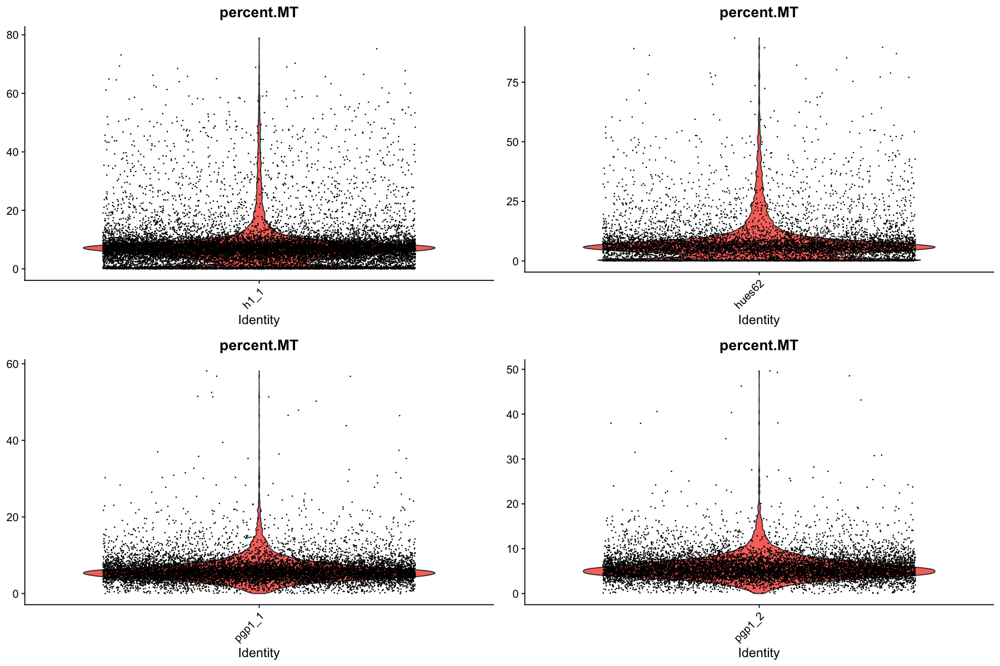

In [11]:
options(repr.plot.width = 15, repr.plot.height = 10)

plot_1 <- VlnPlot(datasets[[1]], features = c("nCount_RNA", "percent.MT"))
plot_2 <- VlnPlot(datasets[[2]], features = c("nCount_RNA", "percent.MT"))
plot_3 <- VlnPlot(datasets[[3]], features = c("nCount_RNA", "percent.MT"))
plot_4 <- VlnPlot(datasets[[4]], features = c("nCount_RNA", "percent.MT"))

grid.arrange(plot_1, plot_2, plot_3, plot_4, ncol = 2, nrow = 2)

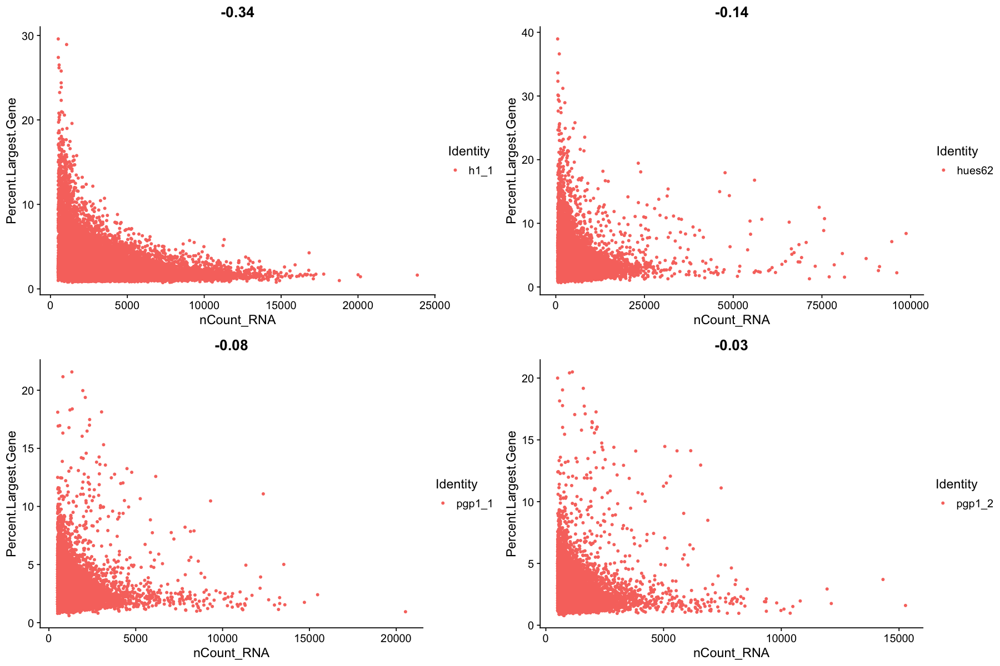

In [12]:
options(repr.plot.width = 15, repr.plot.height = 10)

plot_1 <- FeatureScatter(datasets[[1]], feature1 = "nCount_RNA", feature2 = "Percent.Largest.Gene")
plot_2 <- FeatureScatter(datasets[[2]], feature1 = "nCount_RNA", feature2 = "Percent.Largest.Gene")
plot_3 <- FeatureScatter(datasets[[3]], feature1 = "nCount_RNA", feature2 = "Percent.Largest.Gene")
plot_4 <- FeatureScatter(datasets[[4]], feature1 = "nCount_RNA", feature2 = "Percent.Largest.Gene")

grid.arrange(plot_1, plot_2, plot_3, plot_4, ncol = 2, nrow = 2)

In [13]:
plot_metrics <- function(data) {
    
    qc.metrics <- as_tibble(data[[c("nCount_RNA", "nFeature_RNA", "percent.MT", "Percent.Largest.Gene")]], 
                            rownames = "Cell.Barcode")
    
    plot_1 <- qc.metrics %>%
        arrange(percent.MT) %>%
        ggplot(aes(nCount_RNA, nFeature_RNA, colour = percent.MT)) + 
        geom_point() + 
        scale_color_gradientn(colors = c("black", "blue", "green2", "red", "yellow")) +
        theme_classic()

    plot_2 <- qc.metrics %>%
        ggplot(aes(percent.MT)) + 
        geom_histogram(binwidth = 0.5, fill = "yellow", colour = "black") +
        ggtitle("Distribution of Percentage Mitochondrion") +
        theme_classic()

    plot_3 <- qc.metrics %>%
        ggplot(aes(Percent.Largest.Gene)) + 
        geom_histogram(binwidth = 0.7, fill = "yellow", colour = "black") +
        ggtitle("Distribution of Percentage Largest Gene") +
        theme_classic()
    
    return (list(plot_1, plot_2, plot_3))
}

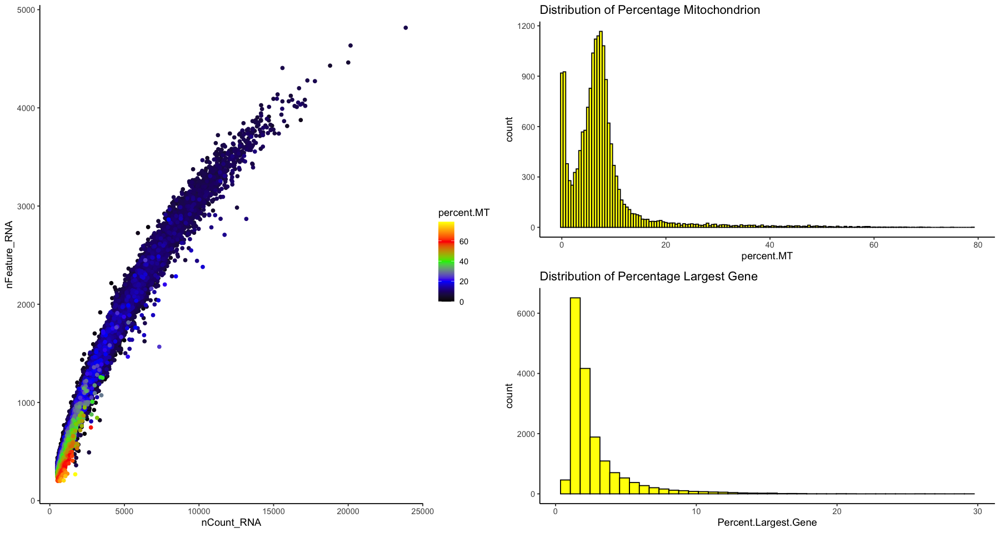

In [14]:
options(repr.plot.width = 15, repr.plot.height = 8)

plots_h1 <- plot_metrics(datasets[[1]])

grid.arrange(plots_h1[[1]], arrangeGrob(plots_h1[[2]], plots_h1[[3]]), ncol = 2, widths = c(4, 4))

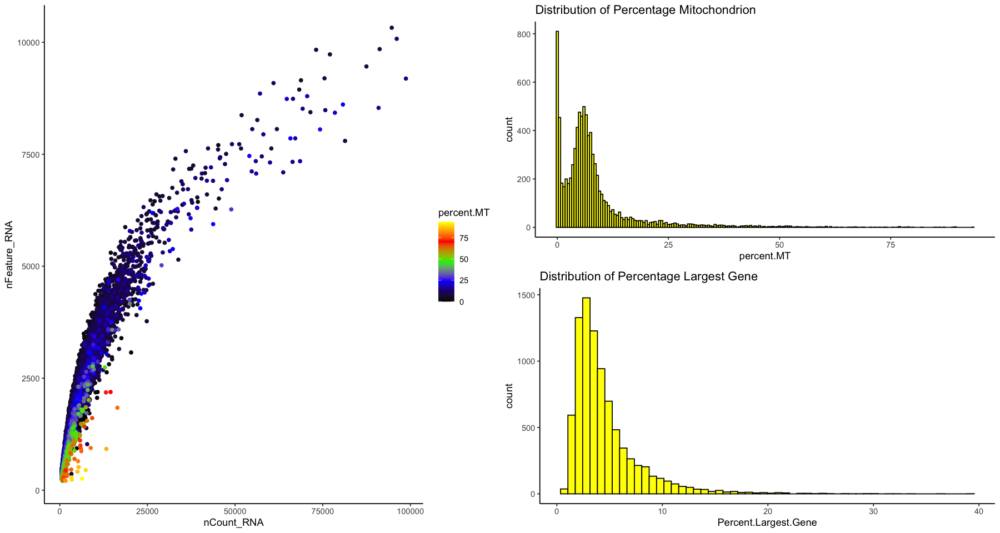

In [15]:
options(repr.plot.width = 15, repr.plot.height = 8)

plots_hues62 <- plot_metrics(datasets[[3]])

grid.arrange(plots_hues62[[1]], arrangeGrob(plots_hues62[[2]], plots_hues62[[3]]), ncol = 2, widths = c(4, 4))

In [16]:
filter <- function(data, rna_min = 750, rnna_max = 2000) {
    data <- subset(data, nFeature_RNA > rna_min & nFeature_RNA < rnna_max & percent.MT < 10 & Percent.Largest.Gene < 20)
    return (data)
}

In [17]:
datasets <- lapply(datasets, filter)

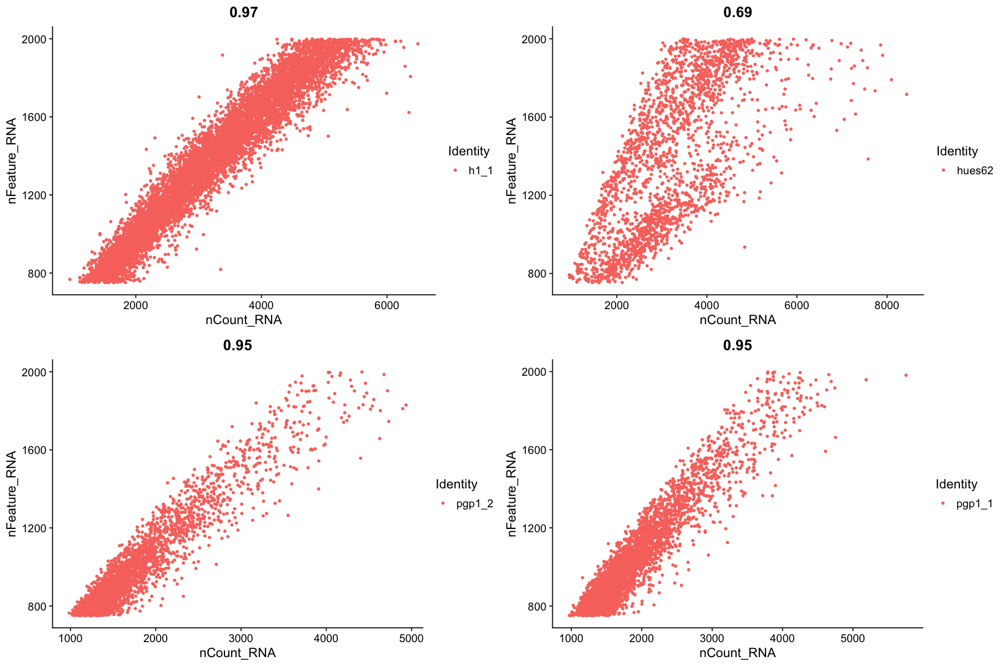

In [18]:
options(repr.plot.width = 15, repr.plot.height = 10)

plot_1 <- FeatureScatter(datasets[[1]], feature1 = "nCount_RNA", feature2 = "nFeature_RNA")
plot_2 <- FeatureScatter(datasets[[2]], feature1 = "nCount_RNA", feature2 = "nFeature_RNA")
plot_4 <- FeatureScatter(datasets[[3]], feature1 = "nCount_RNA", feature2 = "nFeature_RNA")
plot_3 <- FeatureScatter(datasets[[4]], feature1 = "nCount_RNA", feature2 = "nFeature_RNA")

grid.arrange(plot_1, plot_2, plot_3, plot_4, ncol = 2, nrow = 2)

## Variable features

In [19]:
variable <- function(data) {
    data <- FindVariableFeatures(data, selection.method = "vst", nfeatures = 2000)
    return (data)   
}

In [20]:
datasets <- lapply(datasets, variable)

When using repel, set xnudge and ynudge to 0 for optimal results

When using repel, set xnudge and ynudge to 0 for optimal results

When using repel, set xnudge and ynudge to 0 for optimal results

When using repel, set xnudge and ynudge to 0 for optimal results



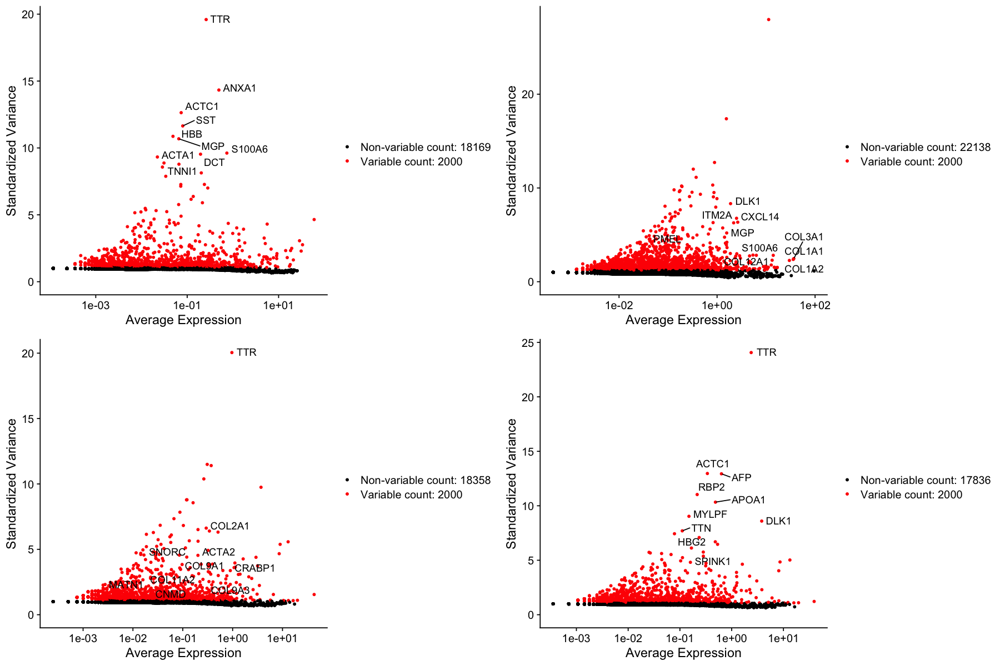

In [21]:
options(repr.plot.width = 15, repr.plot.height = 10)

plot_1 <- VariableFeaturePlot(datasets[[1]])
plot_2 <- LabelPoints(plot = plot_1, points = head(VariableFeatures(datasets[[1]]), 10), repel = TRUE)
plot_3 <- VariableFeaturePlot(datasets[[2]])
plot_4 <- LabelPoints(plot = plot_3, points = head(VariableFeatures(datasets[[2]]), 10), repel = TRUE)
plot_5 <- VariableFeaturePlot(datasets[[3]])
plot_6 <- LabelPoints(plot = plot_5, points = head(VariableFeatures(datasets[[3]]), 10), repel = TRUE)
plot_7 <- VariableFeaturePlot(datasets[[4]])
plot_8 <- LabelPoints(plot = plot_7, points = head(VariableFeatures(datasets[[4]]), 10), repel = TRUE)

grid.arrange(plot_2, plot_4, plot_6, plot_8, ncol = 2, nrow = 2)

In [22]:
plot_variation <- function(data) {
    
    variance.data <- as_tibble(HVFInfo(data), rownames = "Gene")

    variance.data <- variance.data %>% 
        mutate(hypervariable = Gene %in% VariableFeatures(data))

    plot <- variance.data %>% 
        ggplot(aes(log(mean), log(variance), color = hypervariable)) + 
        geom_point() + 
        scale_color_manual(values = c("black", "red")) + 
        ggtitle(as.character(Idents(data)[1])) +
        theme_classic()
    
    return (plot)
}

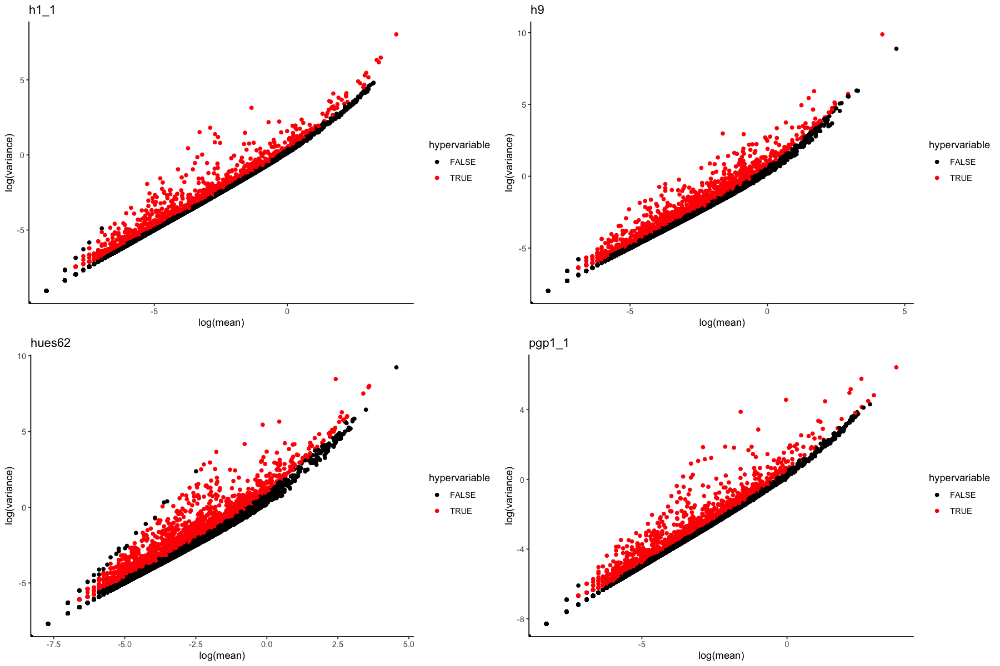

In [23]:
options(repr.plot.width = 15, repr.plot.height = 10)

plot_1 <- plot_variation(datasets[[1]])
plot_2 <- plot_variation(datasets[[2]])
plot_3 <- plot_variation(datasets[[3]])
plot_4 <- plot_variation(datasets[[4]])

grid.arrange(plot_1, plot_2, plot_3, plot_4, ncol = 2, nrow = 2)

## Normalization and Integration

In [24]:
datasets.normalized <- lapply(datasets, SCTransform)

Calculating cell attributes from input UMI matrix: log_umi

Variance stabilizing transformation of count matrix of size 16926 by 8529

Model formula is y ~ log_umi

Get Negative Binomial regression parameters per gene

Using 2000 genes, 5000 cells



  |======================================================================| 100%


Found 155 outliers - those will be ignored in fitting/regularization step


Second step: Get residuals using fitted parameters for 16926 genes



  |======================================================================| 100%


Computing corrected count matrix for 16926 genes



  |======================================================================| 100%


Calculating gene attributes

Wall clock passed: Time difference of 1.31838 mins

Determine variable features

Place corrected count matrix in counts slot

Centering data matrix

Set default assay to SCT

Calculating cell attributes from input UMI matrix: log_umi

Variance stabilizing transformation of count matrix of size 16353 by 2920

Model formula is y ~ log_umi

Get Negative Binomial regression parameters per gene

Using 2000 genes, 2920 cells



  |======================================================================| 100%


Found 132 outliers - those will be ignored in fitting/regularization step


Second step: Get residuals using fitted parameters for 16353 genes



  |======================================================================| 100%


Computing corrected count matrix for 16353 genes



  |======================================================================| 100%


Calculating gene attributes

Wall clock passed: Time difference of 40.71755 secs

Determine variable features

Place corrected count matrix in counts slot

Centering data matrix

Set default assay to SCT

Calculating cell attributes from input UMI matrix: log_umi

Variance stabilizing transformation of count matrix of size 16839 by 2203

Model formula is y ~ log_umi

Get Negative Binomial regression parameters per gene

Using 2000 genes, 2203 cells



  |======================================================================| 100%


Found 76 outliers - those will be ignored in fitting/regularization step


Second step: Get residuals using fitted parameters for 16839 genes



  |======================================================================| 100%


Computing corrected count matrix for 16839 genes



  |======================================================================| 100%


Calculating gene attributes

Wall clock passed: Time difference of 29.92567 secs

Determine variable features

Place corrected count matrix in counts slot

Centering data matrix

Set default assay to SCT

Calculating cell attributes from input UMI matrix: log_umi

Variance stabilizing transformation of count matrix of size 17048 by 3972

Model formula is y ~ log_umi

Get Negative Binomial regression parameters per gene

Using 2000 genes, 3972 cells



  |======================================================================| 100%


Found 187 outliers - those will be ignored in fitting/regularization step


Second step: Get residuals using fitted parameters for 17048 genes



  |======================================================================| 100%


Computing corrected count matrix for 17048 genes



  |======================================================================| 100%


Calculating gene attributes

Wall clock passed: Time difference of 55.54015 secs

Determine variable features

Place corrected count matrix in counts slot

Centering data matrix

Set default assay to SCT

Calculating cell attributes from input UMI matrix: log_umi

Variance stabilizing transformation of count matrix of size 16347 by 2803

Model formula is y ~ log_umi

Get Negative Binomial regression parameters per gene

Using 2000 genes, 2803 cells



  |======================================================================| 100%


Found 178 outliers - those will be ignored in fitting/regularization step


Second step: Get residuals using fitted parameters for 16347 genes



  |======================================================================| 100%


Computing corrected count matrix for 16347 genes



  |======================================================================| 100%


Calculating gene attributes

Wall clock passed: Time difference of 38.78341 secs

Determine variable features

Place corrected count matrix in counts slot

Centering data matrix

Set default assay to SCT

Calculating cell attributes from input UMI matrix: log_umi

Variance stabilizing transformation of count matrix of size 17756 by 4748

Model formula is y ~ log_umi

Get Negative Binomial regression parameters per gene

Using 2000 genes, 4748 cells



  |======================================================================| 100%


Found 190 outliers - those will be ignored in fitting/regularization step


Second step: Get residuals using fitted parameters for 17756 genes



  |======================================================================| 100%


Computing corrected count matrix for 17756 genes



  |======================================================================| 100%


Calculating gene attributes

Wall clock passed: Time difference of 1.091874 mins

Determine variable features

Place corrected count matrix in counts slot

Centering data matrix

Set default assay to SCT

Calculating cell attributes from input UMI matrix: log_umi

Variance stabilizing transformation of count matrix of size 17541 by 4713

Model formula is y ~ log_umi

Get Negative Binomial regression parameters per gene

Using 2000 genes, 4713 cells



  |======================================================================| 100%


Found 156 outliers - those will be ignored in fitting/regularization step


Second step: Get residuals using fitted parameters for 17541 genes



  |======================================================================| 100%


Computing corrected count matrix for 17541 genes



  |======================================================================| 100%


Calculating gene attributes

Wall clock passed: Time difference of 1.066113 mins

Determine variable features

Place corrected count matrix in counts slot

Centering data matrix

Set default assay to SCT



In [25]:
features <- SelectIntegrationFeatures(datasets.normalized, nfeatures = 3000)

In [26]:
datasets.pre <- PrepSCTIntegration(datasets.normalized, anchor.features = features)

In [27]:
rm(datasets, datasets.normalized)

In [29]:
anchors <- FindIntegrationAnchors(datasets.pre, normalization.method = "SCT", anchor.features = features)

Finding all pairwise anchors

Running CCA

Merging objects

Finding neighborhoods

Finding anchors

	Found 9265 anchors

Filtering anchors

	Retained 5964 anchors

Running CCA

Merging objects

Finding neighborhoods

Finding anchors

	Found 6429 anchors

Filtering anchors

	Retained 5327 anchors

Running CCA

Merging objects

Finding neighborhoods

Finding anchors

	Found 4485 anchors

Filtering anchors

	Retained 3769 anchors

Running CCA

Merging objects

Finding neighborhoods

Finding anchors

	Found 12125 anchors

Filtering anchors

	Retained 8357 anchors

Running CCA

Merging objects

Finding neighborhoods

Finding anchors

	Found 6766 anchors

Filtering anchors

	Retained 4060 anchors

Running CCA

Merging objects

Finding neighborhoods

Finding anchors

	Found 5466 anchors

Filtering anchors

	Retained 4149 anchors

Running CCA

Merging objects

Finding neighborhoods

Finding anchors

	Found 9888 anchors

Filtering anchors

	Retained 7122 anchors

Running CCA

Merging objects

F

In [30]:
saveRDS(anchors, file = "./anchors.rds")

In [31]:
anchors <- readRDS(file = "./anchors.rds")

In [32]:
anchors

An AnchorSet object containing 246914 anchors between 7 Seurat objects 
 This can be used as input to IntegrateData.

In [33]:
data <- IntegrateData(anchorset = anchors, normalization.method = "SCT")

Merging dataset 5 into 1

Extracting anchors for merged samples

Finding integration vectors

Finding integration vector weights

Integrating data

Merging dataset 7 into 6

Extracting anchors for merged samples

Finding integration vectors

Finding integration vector weights

Integrating data

Merging dataset 4 into 1 5

Extracting anchors for merged samples

Finding integration vectors

Finding integration vector weights

Integrating data

Merging dataset 3 into 6 7

Extracting anchors for merged samples

Finding integration vectors

Finding integration vector weights

Integrating data

Merging dataset 6 7 3 into 1 5 4

Extracting anchors for merged samples

Finding integration vectors

Finding integration vector weights

Integrating data

Merging dataset 2 into 1 5 4 6 7 3

Extracting anchors for merged samples

Finding integration vectors

Finding integration vector weights

Integrating data



In [34]:
saveRDS(data, file = "./seurat_merged.rds")

In [36]:
data

An object of class Seurat 
48048 features across 29888 samples within 3 assays 
Active assay: integrated (3000 features, 3000 variable features)
 2 other assays present: RNA, SCT

In [37]:
normalization_plot <- function() {
    as.tibble(data@assays$integrated@data[, 1:100]) %>%
        pivot_longer(cols = everything(), names_to = "cell", values_to = "expression") %>%
        ggplot(aes(x = expression, group = cell)) + geom_density() +
        coord_cartesian(ylim = c(0, 0.6), xlim = c(0, 3)) +
        theme_classic()
}

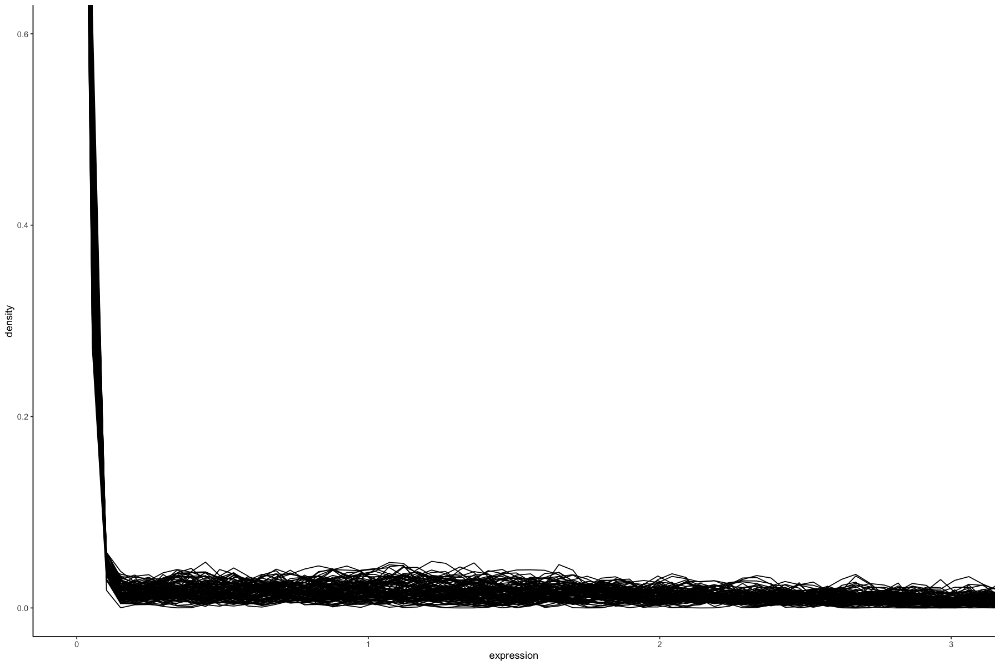

In [38]:
normalization_plot()

In [39]:
data <- ScaleData(data, features = rownames(data), verbose = FALSE)

In [40]:
saveRDS(data, file = "./seurat_obj_scaled.rds")

## Clustering 

### PCA

In [106]:
data <- readRDS(file = "./seurat_objects/seurat_obj_scaled.rds")

In [109]:
data <- RunPCA(data, features = VariableFeatures(data))

PC_ 1 
Positive:  MALAT1, TUBB2B, TUBA1A, MAP1B, PCSK1N, RTN1, TMSB10, STMN4, ACTG1, BASP1 
	   GNG3, TMSB4X, SOX4, RBP1, TAC3, CRMP1, STMN2, INA, APLP1, DCX 
	   BEX1, ELAVL3, MIAT, TAGLN3, SCG5, MAP2, FAM57B, PLPPR3, CADPS, STMN1 
Negative:  H2AFZ, TUBA1B, PTMA, HMGB1, HMGB2, TUBB4B, UBE2S, RPS23, RPL22L1, PCLAF 
	   TUBA1C, TYMS, CCNB1, MAD2L1, UBE2C, RPS26, CKS2, HMGN2, FABP5, PTTG1 
	   NASP, CKS1B, CENPF, EEF1B2, CDK1, HIST1H4C, NUSAP1, RPL41, DEK, CDKN3 
PC_ 2 
Positive:  S100A6, SPARC, COL3A1, COL1A1, FN1, SERF2, S100A11, LGALS1, COL5A2, COL1A2 
	   ZNF90, MFAP5, PRG4, PCOLCE, RPS20, MT1M, FTH1, MT2A, KLF4, S100A10 
	   EEF1A1, S100A4, CCDC80, EMP1, SERPINF1, EFEMP2, LMNA, MTRNR2L10, TIMP2, APOE 
Negative:  PTMA, TUBA1B, HMGB1, HMGB2, UBE2S, STMN1, HMGN2, UBE2C, CENPF, CCNB1 
	   MKI67, H2AFZ, JPT1, TOP2A, NUSAP1, PTTG1, DEK, KPNA2, TUBB, TPX2 
	   MAD2L1, HIST1H4C, PCLAF, CENPV, TUBB2B, CKS1B, NASP, UBE2T, ASPM, TUBA1C 
PC_ 3 
Positive:  COL1A2, COL3A1, COL1A1, SPARC, FN1, LGA

In [ ]:
pc_1_2 <- DimPlot(data, reduction = "pca", dims = c(1, 2))
pc_2_3 <- DimPlot(data, reduction = "pca", dims = c(2, 3))
pc_3_4 <- DimPlot(data, reduction = "pca", dims = c(3, 4))
pc_4_5 <- DimPlot(data, reduction = "pca", dims = c(4, 5))

options(repr.plot.width = 15, repr.plot.height = 12)
grid.arrange(pc_1_2, pc_2_3, pc_3_4,  pc_4_5, ncol = 2, nrow = 2)

In [ ]:
ElbowPlot(data)

In [ ]:
options(repr.plot.width = 15, repr.plot.height = 20)
DimHeatmap(data, dims = 1:18, cells = 500)

### TSNE

In [ ]:
data <- RunTSNE(data, dims = 1:14, seed.use = 1, perplexity = 10)
plot_10 <- DimPlot(data,reduction = "tsne", pt.size = 1) + ggtitle("tSNE with Perplexity 10")
data <- RunTSNE(data, dims = 1:14, seed.use = 1, perplexity = 50)
plot_50 <- DimPlot(data,reduction = "tsne", pt.size = 1) + ggtitle("tSNE with Perplexity 50")
data <- RunTSNE(data, dims = 1:14, seed.use = 1, perplexity = 100)
plot_100 <- DimPlot(data,reduction = "tsne", pt.size = 1) + ggtitle("tSNE with Perplexity 100")
data <- RunTSNE(data, dims = 1:14, seed.use = 1, perplexity = 300)
plot_300 <- DimPlot(data,reduction = "tsne", pt.size = 1) + ggtitle("tSNE with Perplexity 300")

In [ ]:
options(repr.plot.width = 15, repr.plot.height = 12)
grid.arrange(plot_10, plot_50, plot_100, plot_300, ncol = 2, nrow = 2)

In [ ]:
data <- RunTSNE(data, dims = 1:14, seed.use = 1, perplexity = 50)

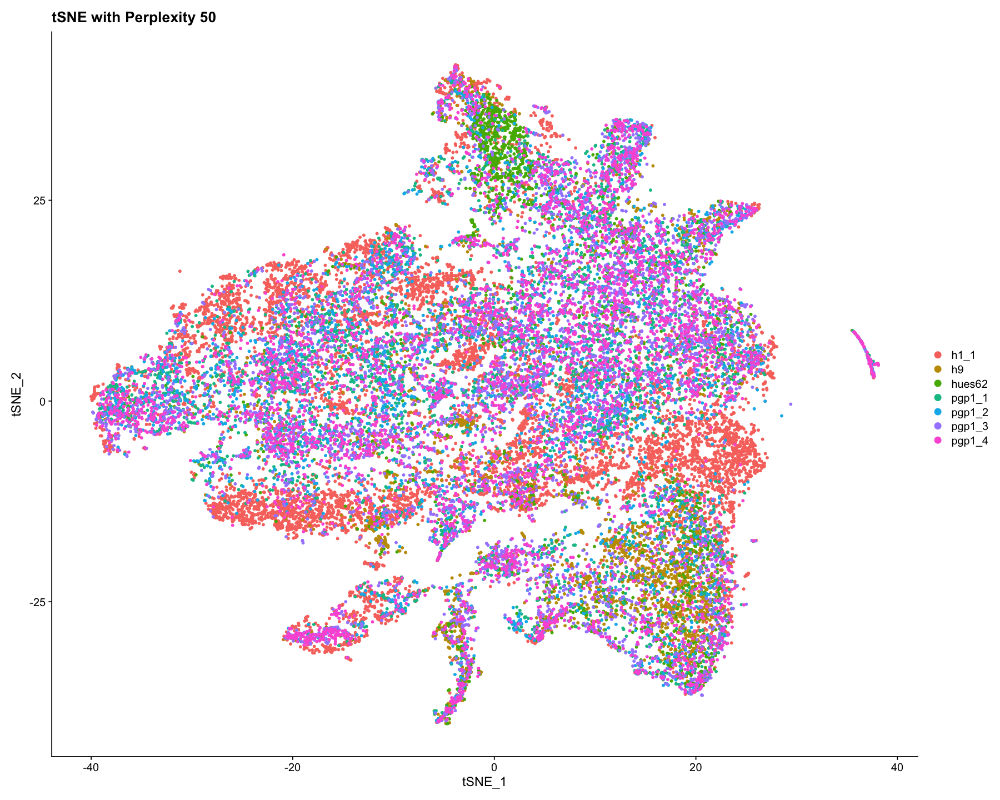

In [13]:
DimPlot(data,reduction = "tsne", pt.size = 1) + ggtitle("tSNE with Perplexity 50")

### UMAP

In [110]:
data <- RunUMAP(data, dims = 1:14, verbose = FALSE)

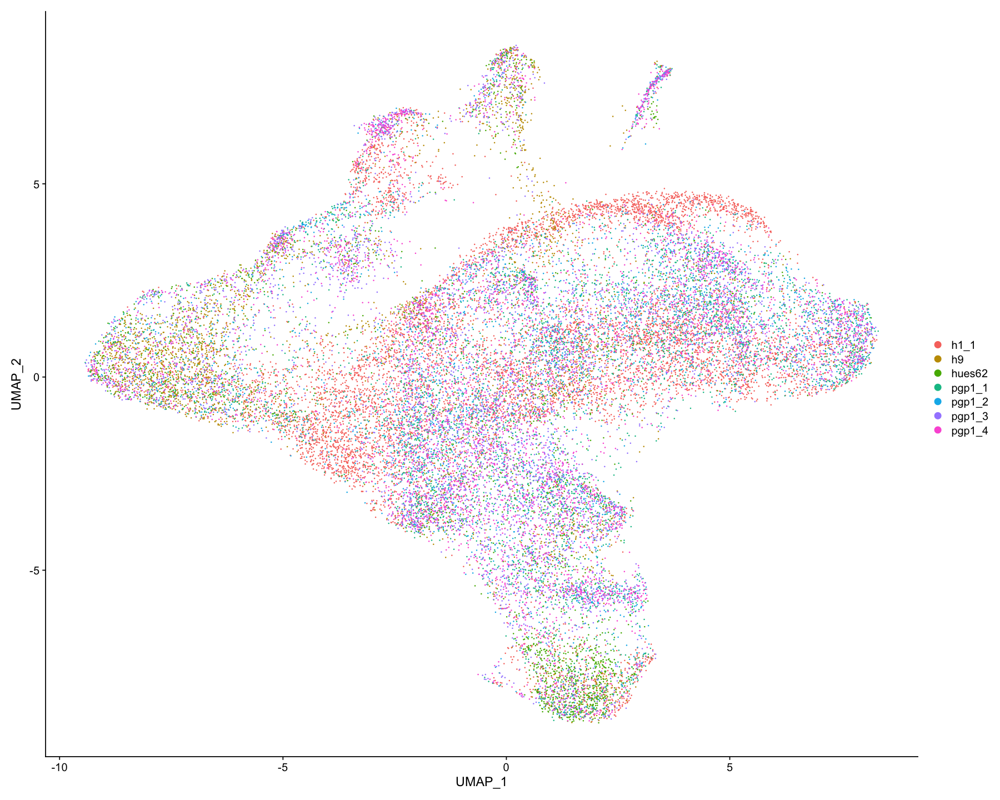

In [15]:
DimPlot(data, reduction = "umap")

In [112]:
tiff("UMAP_samples.tiff", width = 15, height = 10, units = 'in', res = 500)
options(repr.plot.width = 15, repr.plot.height = 10)
DimPlot(data, reduction = "umap")
dev.off()

pdf 
  2

## Defining Clusters

In [16]:
data <- FindNeighbors(data, dims = 1:14, verbose = FALSE)

In [17]:
data <- FindClusters(data, resolution = 0.5)

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 29888
Number of edges: 987286

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8769
Number of communities: 15
Elapsed time: 5 seconds


After running two functions above we obtained 14 communities. Let's visualize them with both tSNE and UMAP.

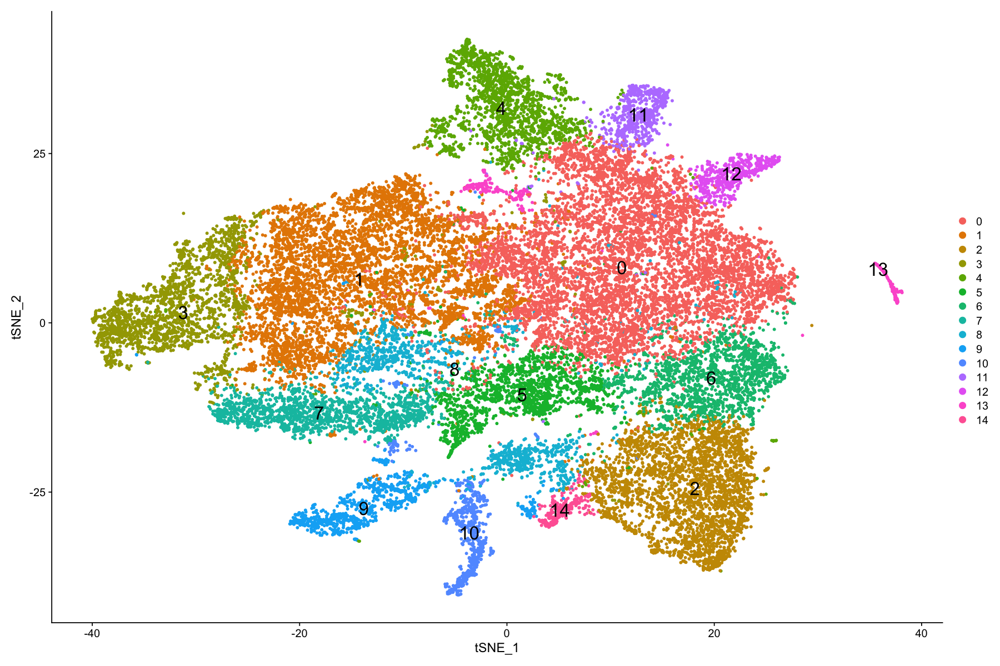

In [18]:
options(repr.plot.width = 15, repr.plot.height = 10)
DimPlot(data, reduction = "tsne", pt.size = 1, label = TRUE, label.size = 7)

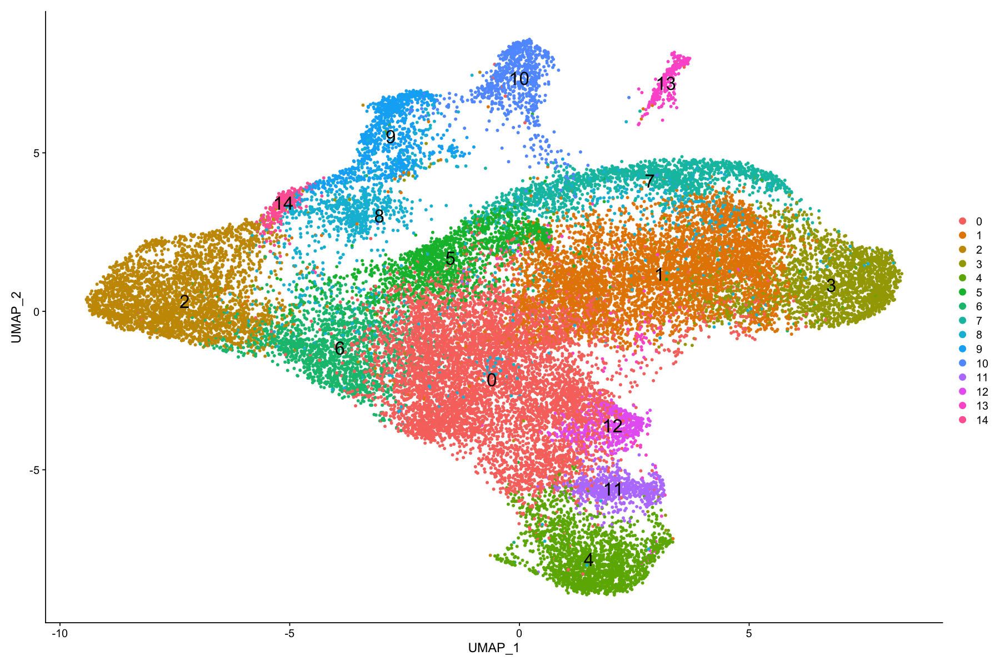

In [19]:
DimPlot(data, reduction = "umap", pt.size = 1, label = TRUE, label.size = 7)

In [20]:
saveRDS(data, file = "./seurat_obj_clustered.rds")

## Cell Type Annotation

In [22]:
markers <- FindAllMarkers(data)

Calculating cluster 0

Calculating cluster 1

Calculating cluster 2

Calculating cluster 3

Calculating cluster 4

Calculating cluster 5

Calculating cluster 6

Calculating cluster 7

Calculating cluster 8

Calculating cluster 9

Calculating cluster 10

Calculating cluster 11

Calculating cluster 12

Calculating cluster 13

Calculating cluster 14



In [23]:
write.table(markers, file = "markers.tsv", sep = "\t")

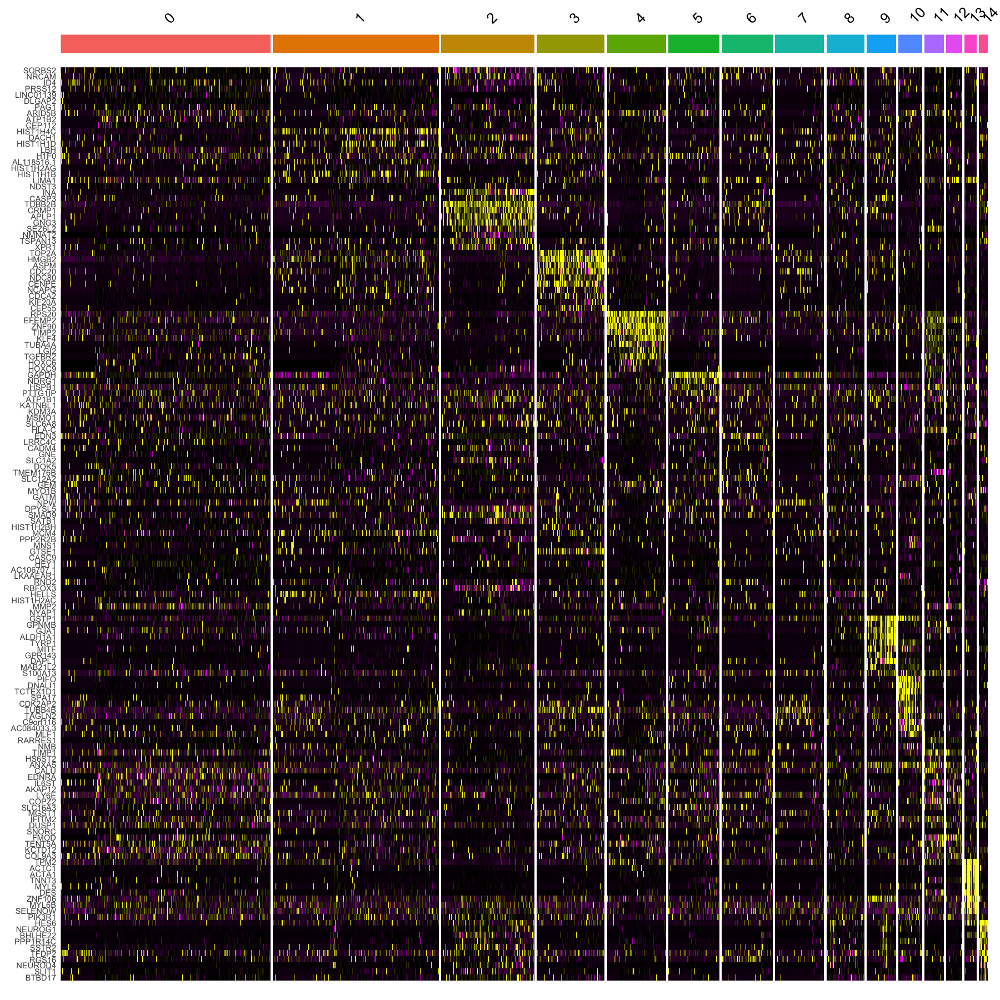

In [25]:
top10 <- markers %>%
    group_by(cluster) %>%
    top_n(n = 10, wt = avg_log2FC)

options(repr.plot.width = 15, repr.plot.height = 15)
DoHeatmap(data, features = top10$gene) + NoLegend()

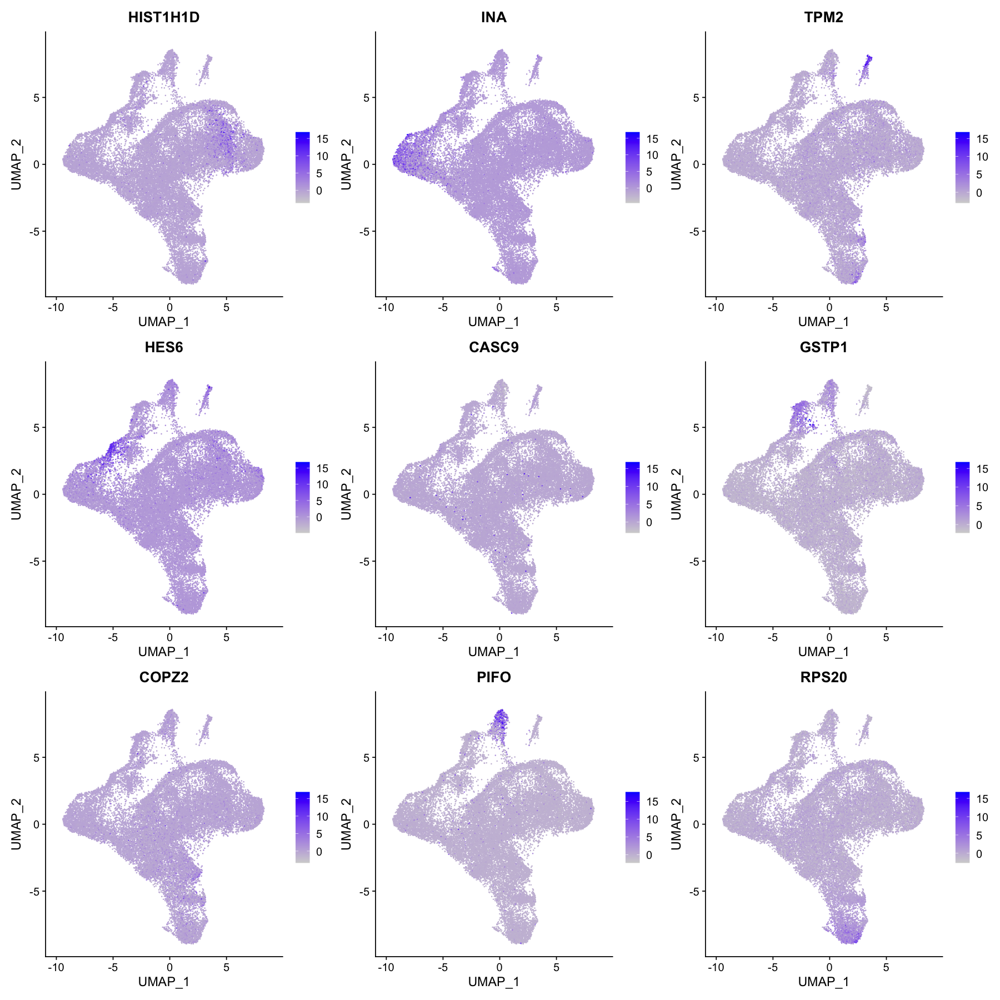

In [33]:
FeaturePlot(data, features = c("HIST1H1D", "INA", "TPM2", "HES6", "CASC9", "GSTP1", "COPZ2", 
                               "PIFO", "RPS20"))

In [34]:
ref <- HumanPrimaryCellAtlasData()

snapshotDate(): 2021-10-19

see ?celldex and browseVignettes('celldex') for documentation

downloading 1 resources

retrieving 1 resource

loading from cache

see ?celldex and browseVignettes('celldex') for documentation

downloading 1 resources

retrieving 1 resource

loading from cache



In [35]:
ref$label.fine

[1] "DC:monocyte-derived:immature"                          
  [2] "DC:monocyte-derived:immature"                          
  [3] "DC:monocyte-derived:immature"                          
  [4] "DC:monocyte-derived:Galectin-1"                        
  [5] "DC:monocyte-derived:Galectin-1"                        
  [6] "DC:monocyte-derived:Galectin-1"                        
  [7] "DC:monocyte-derived:LPS"                               
  [8] "DC:monocyte-derived:LPS"                               
  [9] "DC:monocyte-derived:LPS"                               
 [10] "DC:monocyte-derived"                                   
 [11] "DC:monocyte-derived"                                   
 [12] "DC:monocyte-derived"                                   
 [13] "Smooth_muscle_cells:bronchial:vit_D"                   
 [14] "Smooth_muscle_cells:bronchial:vit_D"                   
 [15] "Smooth_muscle_cells:bronchial:vit_D"                   
 [16] "Smooth_muscle_cells:bronchial"                         
 [17] "Smooth_muscle_cells:bronchial"                         
 [18] "Smooth_muscle_cells:bronchial"                         
 [19] "Epithelial_cells:bronchial"                            
 [20] "Epithelial_cells:bronchial"                            
 [21] "Epithelial_cells:bronchial"                            
 [22] "Epithelial_cells:bronchial"                            
 [23] "Epithelial_cells:bronchial"                            
 [24] "Epithelial_cells:bronchial"                            
 [25] "Epithelial_cells:bronchial"                            
 [26] "Epithelial_cells:bronchial"                            
 [27] "Epithelial_cells:bronchial"                            
 [28] "Epithelial_cells:bronchial"                            
 [29] "B_cell"                                                
 [30] "B_cell"                                                
 [31] "B_cell"                                                
 [32] "B_cell"                                                
 [33] "Neutrophil"                                            
 [34] "Neutrophil"                                            
 [35] "Neutrophil"                                            
 [36] "T_cell:CD8+_Central_memory"                            
 [37] "T_cell:CD8+_Central_memory"                            
 [38] "T_cell:CD8+_Central_memory"                            
 [39] "T_cell:CD8+"                                           
 [40] "T_cell:CD4+"                                           
 [41] "T_cell:CD8+"                                           
 [42] "T_cell:CD4+"                                           
 [43] "T_cell:CD8+"                                           
 [44] "T_cell:CD8+"                                           
 [45] "T_cell:CD8+"                                           
 [46] "T_cell:CD4+"                                           
 [47] "T_cell:CD8+"                                           
 [48] "T_cell:CD8+_effector_memory_RA"                        
 [49] "T_cell:CD8+_effector_memory_RA"                        
 [50] "T_cell:CD8+_effector_memory_RA"                        
 [51] "T_cell:CD8+_effector_memory_RA"                        
 [52] "T_cell:CD8+_effector_memory"                           
 [53] "T_cell:CD8+_effector_memory"                           
 [54] "T_cell:CD8+_effector_memory"                           
 [55] "T_cell:CD8+_effector_memory"                           
 [56] "T_cell:CD8+_naive"                                     
 [57] "T_cell:CD8+_naive"                                     
 [58] "T_cell:CD8+_naive"                                     
 [59] "T_cell:CD8+_naive"                                     
 [60] "Monocyte"                                              
 [61] "Monocyte"                                              
 [62] "Monocyte"                                              
 [63] "Monocyte"                                              
 [64] "Monocyte"                 

In [38]:
predictions_clustered <- SingleR(test = as.SingleCellExperiment(data), ref = ref, 
                                 clusters = Idents(data), labels = ref$label.fine)

In [39]:
predictions_clustered$labels

[1] "Chondrocytes:MSC-derived"             
 [2] "Erythroblast"                         
 [3] "Neurons:adrenal_medulla_cell_line"    
 [4] "T_cell:effector"                      
 [5] "iPS_cells:adipose_stem_cells"         
 [6] "Epithelial_cells:bladder"             
 [7] "Astrocyte:Embryonic_stem_cell-derived"
 [8] "Erythroblast"                         
 [9] "Neuroepithelial_cell:ESC-derived"     
[10] "Neuroepithelial_cell:ESC-derived"     
[11] "Epithelial_cells:bronchial"           
[12] "Tissue_stem_cells:BM_MSC:TGFb3"       
[13] "Chondrocytes:MSC-derived"             
[14] "Tissue_stem_cells:BM_MSC:osteogenic"  
[15] "Astrocyte:Embryonic_stem_cell-derived"

In [40]:
labels <- gsub("\\:.*", "", predictions_clustered$labels)

In [41]:
labels

[1] "Chondrocytes"         "Erythroblast"         "Neurons"             
 [4] "T_cell"               "iPS_cells"            "Epithelial_cells"    
 [7] "Astrocyte"            "Erythroblast"         "Neuroepithelial_cell"
[10] "Neuroepithelial_cell" "Epithelial_cells"     "Tissue_stem_cells"   
[13] "Chondrocytes"         "Tissue_stem_cells"    "Astrocyte"

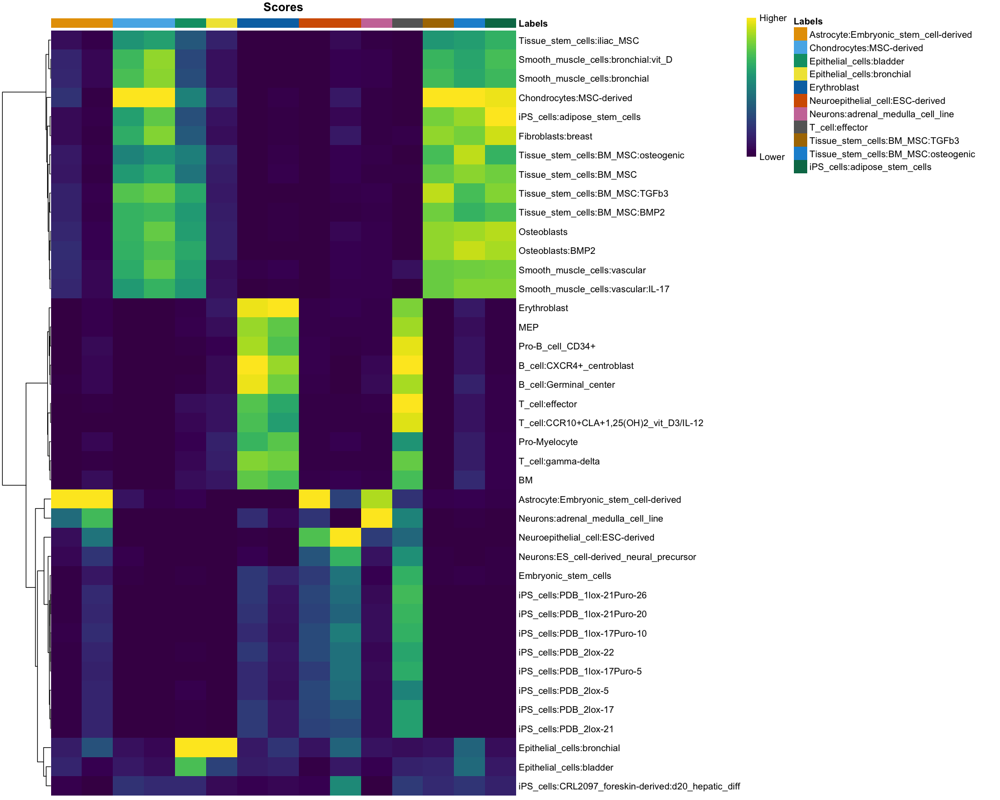

In [44]:
options(repr.plot.width = 15, repr.plot.height = 12)
predictions_plot <- plotScoreHeatmap(predictions_clustered)

In [45]:
data.clusters_annotated <- data

new_idens <- labels
names(new_idens) <- levels(data.clusters_annotated)

data.clusters_annotated <- RenameIdents(data.clusters_annotated, new_idens)

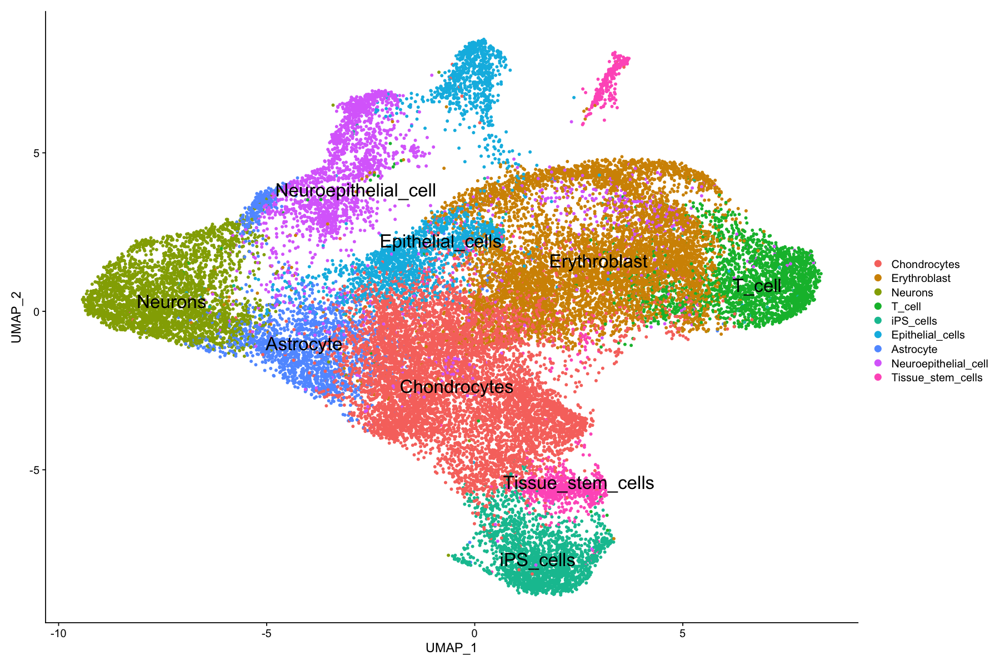

In [89]:
options(repr.plot.width = 15, repr.plot.height = 10)
DimPlot(data, reduction = "umap", pt.size = 1, label = TRUE, label.size = 7)

In [94]:
tiff("UMAP.tiff", width = 15, height = 10, units = 'in', res = 500)
options(repr.plot.width = 15, repr.plot.height = 10)
DimPlot(data, reduction = "umap", pt.size = 1, label = TRUE, label.size = 7)
dev.off()

pdf 
  2

In [14]:
saveRDS(data.clusters_annotated, file = "./seurat_obj_annotated.rds")

In [3]:
data.clusters_annotated <- readRDS(file = "./seurat_objects/seurat_obj_annotated.rds")

## Pseudobalk Differential Expression

In [4]:
counts <- data.clusters_annotated@assays$RNA@counts
metadata <- data.clusters_annotated@meta.data
metadata$cluster_id <- factor(data.clusters_annotated@active.ident)

sce <- SingleCellExperiment(assays = list(counts = counts), colData = metadata)
table(sce$cluster_id, sce$orig.ident)

groups <- colData(sce)[, c("cluster_id", "orig.ident")]
pb <- aggregate.Matrix(t(counts(sce)), groupings = groups, fun = "sum") 
splitf <- sapply(stringr::str_split(rownames(pb), pattern = "_", n = 2), `[`, 1)
pb <- split.data.frame(pb, factor(splitf)) %>%
    lapply(function(x) set_colnames(t(x), stringr::str_extract(rownames(x), "(?<=_)[:alnum:]+")))

clusters <- levels(metadata$cluster_id)

                      
                       h1_1   h9 hues62 pgp1_1 pgp1_2 pgp1_3 pgp1_4
  Chondrocytes         1166  338    574   1268    860   1626   1704
  Erythroblast         3137  382    183   1005    732    894    857
  Neurons               409 1064    323    300    193    483    338
  T_cell                777   59     44    442    307    305    336
  iPS_cells             406  165    653    186    118    228    210
  Epithelial_cells      709  494    202    188    158    387    373
  Astrocyte            1334  154     61    113     93    131    108
  Neuroepithelial_cell  558  200     91    264    208    463    472
  Tissue_stem_cells      33   64     72    206    134    231    315

In [5]:
get_dds_LRTresults <- function(x) {
    
    cluster_metadata <- metadata[which(metadata$cluster_id == x), ]
    idx <- c(rownames(cluster_metadata))
    counts <- counts[, idx] + 1 # Pseudocounts otherwise won't run
    cluster_counts <- data.frame(counts[, which(colnames(counts) %in% rownames(cluster_metadata))])
    colnames(cluster_counts) <- gsub("\\.", "-", colnames(cluster_counts))
    
    dds <- DESeqDataSetFromMatrix(cluster_counts, colData = cluster_metadata, design = ~ orig.ident)

    # Arguments according to DESeq2 recommendations for single-cell data
    dds <- DESeq(dds, test = "LRT", useT = TRUE, minmu = 1e-6, minReplicatesForReplace = Inf, reduced = ~ 1)
    res <- results(dds)
    
    summary(res)
    res
    plotDispEsts(dds)
    
    res.sorted <- res[order(res$padj), ]
    top_20 <- res.sorted[20, ]
    
    saveRDS(dds, file = paste0(x, "_deseq.rds"))
    saveRDS(top_20, file = paste0(x, "_top20.rds"))
    
    sum(res$padj < 0.1, na.rm = TRUE)
    
    # Up and Down regulated genes
    row.names(res)[which(res$log2FoldChange != NA && res$log2FoldChange > 1 && res$padj < 0.05)]
    row.names(res)[which(res$log2FoldChange != NA && res$log2FoldChange < -1 && res$padj < 0.05)] 
    
    return(dds)
}

In [6]:
clusters

[1] "Chondrocytes"         "Erythroblast"         "Neurons"             
[4] "T_cell"               "iPS_cells"            "Epithelial_cells"    
[7] "Astrocyte"            "Neuroepithelial_cell" "Tissue_stem_cells"

converting counts to integer mode

Warning message in DESeqDataSet(se, design = design, ignoreRank):
“some variables in design formula are characters, converting to factors”
estimating size factors

estimating dispersions

gene-wise dispersion estimates

mean-dispersion relationship

-- note: fitType='parametric', but the dispersion trend was not well captured by the
   function: y = a/x + b, and a local regression fit was automatically substituted.
   specify fitType='local' or 'mean' to avoid this message next time.

final dispersion estimates

fitting model and testing




out of 25072 with nonzero total read count
adjusted p-value < 0.1
LFC > 0 (up)       : 1221, 4.9%
LFC < 0 (down)     : 1864, 7.4%
outliers [1]       : 4, 0.016%
low counts [2]     : 14583, 58%
(mean count < 1)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



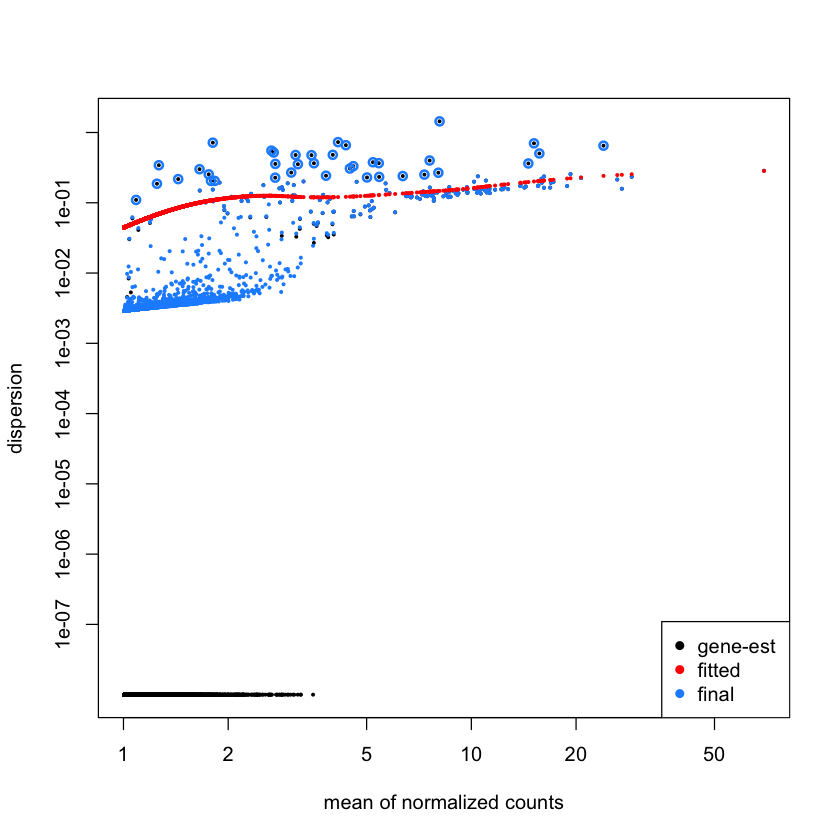

In [7]:
Chondrocytes <- get_dds_LRTresults(clusters[1])

converting counts to integer mode

Warning message in DESeqDataSet(se, design = design, ignoreRank):
“some variables in design formula are characters, converting to factors”
estimating size factors

estimating dispersions

gene-wise dispersion estimates

mean-dispersion relationship

-- note: fitType='parametric', but the dispersion trend was not well captured by the
   function: y = a/x + b, and a local regression fit was automatically substituted.
   specify fitType='local' or 'mean' to avoid this message next time.

final dispersion estimates

fitting model and testing




out of 25072 with nonzero total read count
adjusted p-value < 0.1
LFC > 0 (up)       : 953, 3.8%
LFC < 0 (down)     : 1915, 7.6%
outliers [1]       : 6, 0.024%
low counts [2]     : 14583, 58%
(mean count < 1)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



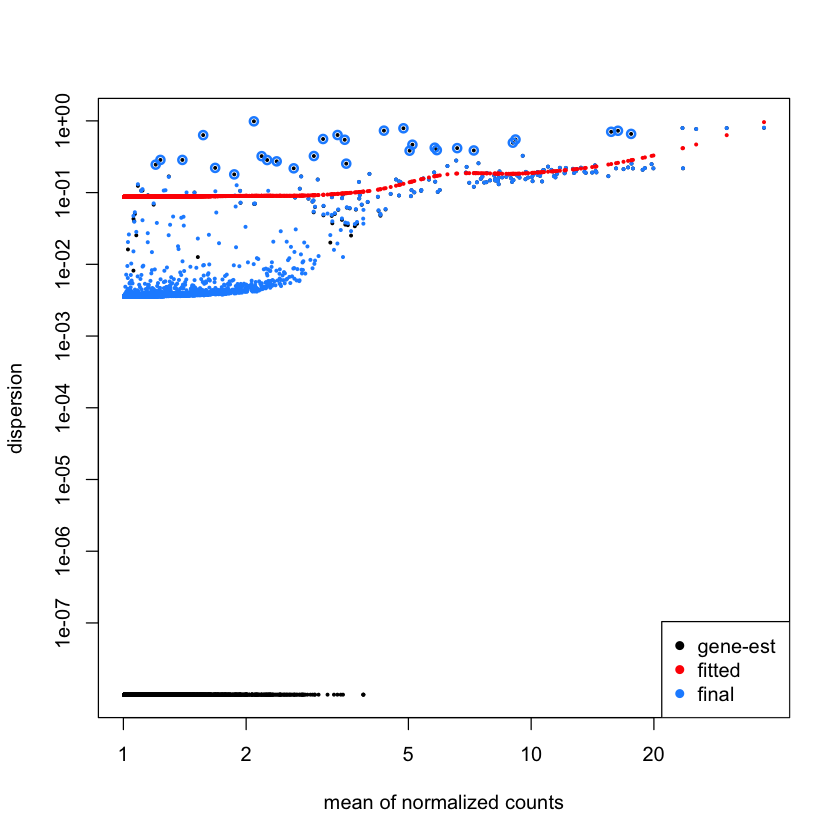

In [8]:
Erythroblast <- get_dds_LRTresults(clusters[2])

converting counts to integer mode

Warning message in DESeqDataSet(se, design = design, ignoreRank):
“some variables in design formula are characters, converting to factors”
estimating size factors

estimating dispersions

gene-wise dispersion estimates

mean-dispersion relationship

-- note: fitType='parametric', but the dispersion trend was not well captured by the
   function: y = a/x + b, and a local regression fit was automatically substituted.
   specify fitType='local' or 'mean' to avoid this message next time.

final dispersion estimates

fitting model and testing




out of 25072 with nonzero total read count
adjusted p-value < 0.1
LFC > 0 (up)       : 1227, 4.9%
LFC < 0 (down)     : 1127, 4.5%
outliers [1]       : 2, 0.008%
low counts [2]     : 17499, 70%
(mean count < 1)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



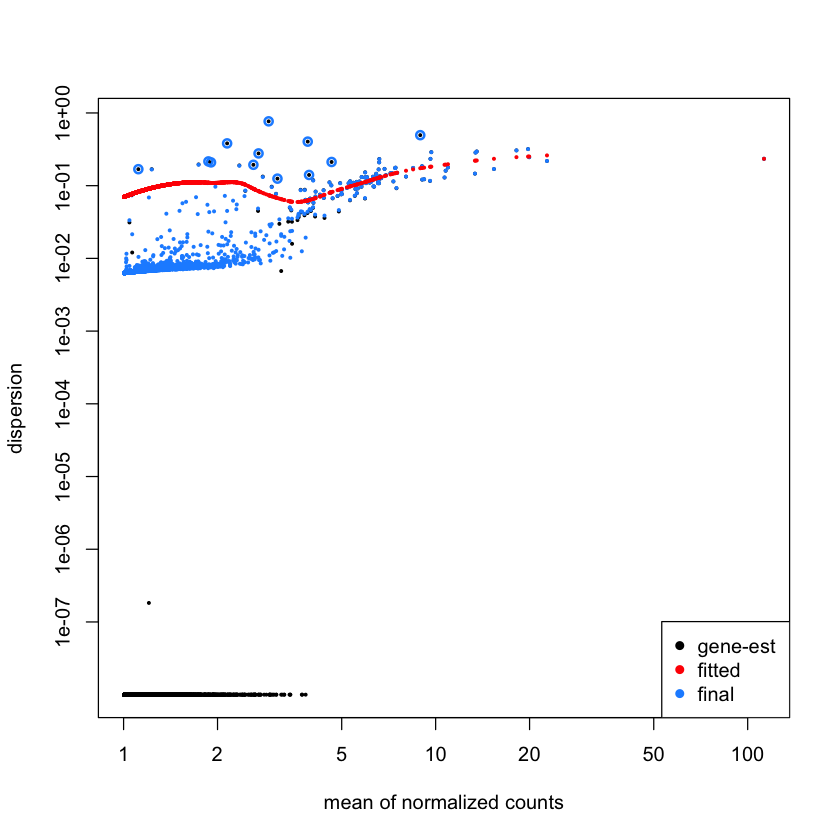

In [18]:
Neurons <- get_dds_LRTresults(clusters[3])

converting counts to integer mode

Warning message in DESeqDataSet(se, design = design, ignoreRank):
“some variables in design formula are characters, converting to factors”
estimating size factors

estimating dispersions

gene-wise dispersion estimates

mean-dispersion relationship

-- note: fitType='parametric', but the dispersion trend was not well captured by the
   function: y = a/x + b, and a local regression fit was automatically substituted.
   specify fitType='local' or 'mean' to avoid this message next time.

final dispersion estimates

fitting model and testing




out of 25072 with nonzero total read count
adjusted p-value < 0.1
LFC > 0 (up)       : 426, 1.7%
LFC < 0 (down)     : 1490, 5.9%
outliers [1]       : 3, 0.012%
low counts [2]     : 15069, 60%
(mean count < 1)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



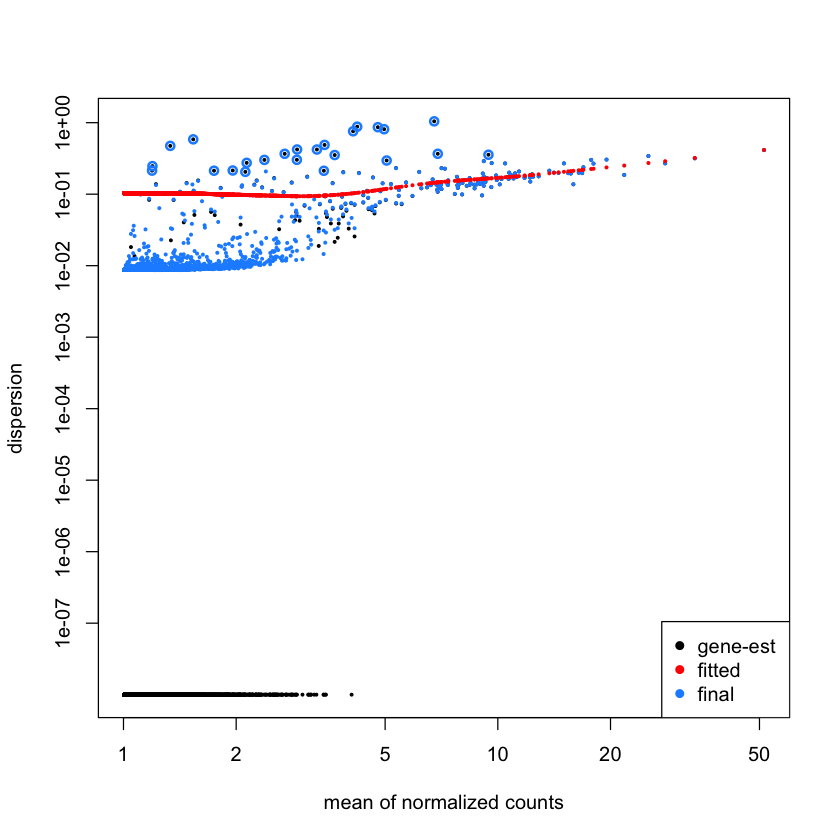

In [17]:
T_cell <- get_dds_LRTresults(clusters[4])

converting counts to integer mode

Warning message in DESeqDataSet(se, design = design, ignoreRank):
“some variables in design formula are characters, converting to factors”
estimating size factors

estimating dispersions

gene-wise dispersion estimates

mean-dispersion relationship

-- note: fitType='parametric', but the dispersion trend was not well captured by the
   function: y = a/x + b, and a local regression fit was automatically substituted.
   specify fitType='local' or 'mean' to avoid this message next time.

final dispersion estimates

fitting model and testing




out of 25072 with nonzero total read count
adjusted p-value < 0.1
LFC > 0 (up)       : 851, 3.4%
LFC < 0 (down)     : 1134, 4.5%
outliers [1]       : 2, 0.008%
low counts [2]     : 17985, 72%
(mean count < 1)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



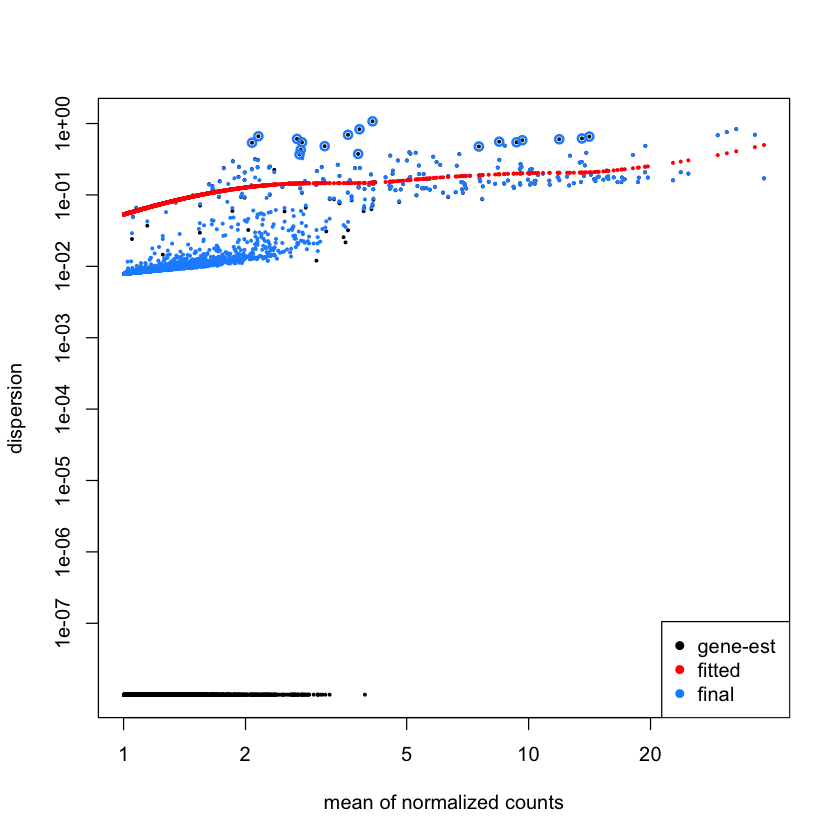

In [16]:
iPS_cells <- get_dds_LRTresults(clusters[5])

converting counts to integer mode

Warning message in DESeqDataSet(se, design = design, ignoreRank):
“some variables in design formula are characters, converting to factors”
estimating size factors

estimating dispersions

gene-wise dispersion estimates

mean-dispersion relationship

-- note: fitType='parametric', but the dispersion trend was not well captured by the
   function: y = a/x + b, and a local regression fit was automatically substituted.
   specify fitType='local' or 'mean' to avoid this message next time.

final dispersion estimates

fitting model and testing




out of 25072 with nonzero total read count
adjusted p-value < 0.1
LFC > 0 (up)       : 738, 2.9%
LFC < 0 (down)     : 1086, 4.3%
outliers [1]       : 12, 0.048%
low counts [2]     : 19926, 79%
(mean count < 1)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



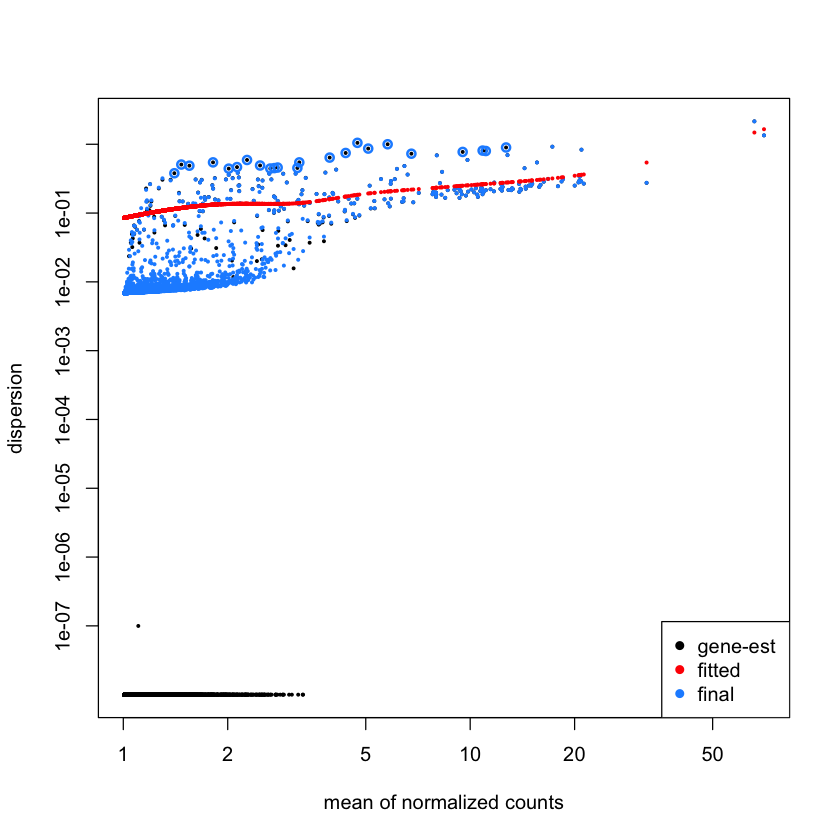

In [14]:
Epithelial_cells <- get_dds_LRTresults(clusters[6])

converting counts to integer mode

Warning message in DESeqDataSet(se, design = design, ignoreRank):
“some variables in design formula are characters, converting to factors”
estimating size factors

estimating dispersions

gene-wise dispersion estimates

mean-dispersion relationship

-- note: fitType='parametric', but the dispersion trend was not well captured by the
   function: y = a/x + b, and a local regression fit was automatically substituted.
   specify fitType='local' or 'mean' to avoid this message next time.

final dispersion estimates

fitting model and testing




out of 25072 with nonzero total read count
adjusted p-value < 0.1
LFC > 0 (up)       : 434, 1.7%
LFC < 0 (down)     : 978, 3.9%
outliers [1]       : 4, 0.016%
low counts [2]     : 14097, 56%
(mean count < 1)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



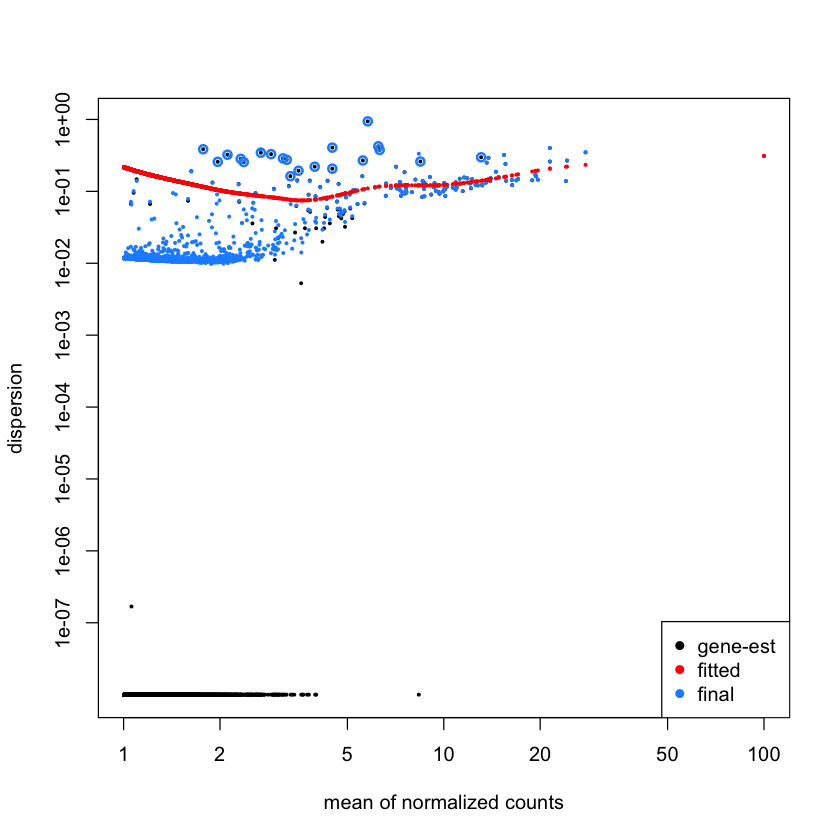

In [11]:
Astrocyte <- get_dds_LRTresults(clusters[7])

converting counts to integer mode

Warning message in DESeqDataSet(se, design = design, ignoreRank):
“some variables in design formula are characters, converting to factors”
estimating size factors

estimating dispersions

gene-wise dispersion estimates

mean-dispersion relationship

-- note: fitType='parametric', but the dispersion trend was not well captured by the
   function: y = a/x + b, and a local regression fit was automatically substituted.
   specify fitType='local' or 'mean' to avoid this message next time.

final dispersion estimates

fitting model and testing




out of 25072 with nonzero total read count
adjusted p-value < 0.1
LFC > 0 (up)       : 311, 1.2%
LFC < 0 (down)     : 1067, 4.3%
outliers [1]       : 6, 0.024%
low counts [2]     : 20898, 83%
(mean count < 1)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



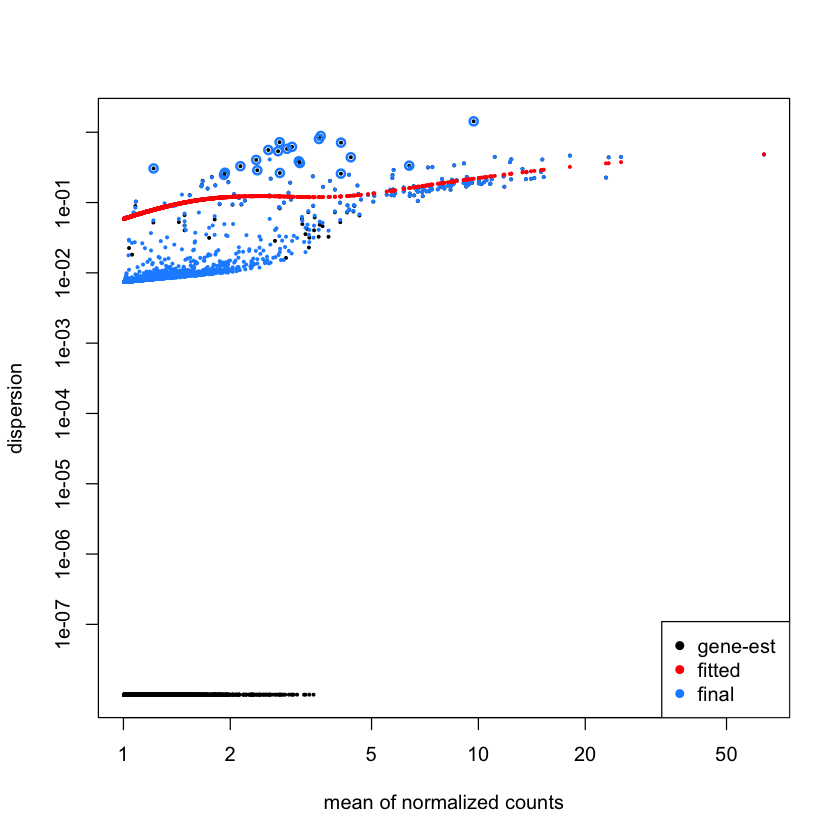

In [12]:
Neuroepithelial_cell <- get_dds_LRTresults(clusters[8])

converting counts to integer mode

Warning message in DESeqDataSet(se, design = design, ignoreRank):
“some variables in design formula are characters, converting to factors”
estimating size factors

estimating dispersions

gene-wise dispersion estimates

mean-dispersion relationship

-- note: fitType='parametric', but the dispersion trend was not well captured by the
   function: y = a/x + b, and a local regression fit was automatically substituted.
   specify fitType='local' or 'mean' to avoid this message next time.

final dispersion estimates

fitting model and testing




out of 25072 with nonzero total read count
adjusted p-value < 0.1
LFC > 0 (up)       : 576, 2.3%
LFC < 0 (down)     : 591, 2.4%
outliers [1]       : 2, 0.008%
low counts [2]     : 22845, 91%
(mean count < 1)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



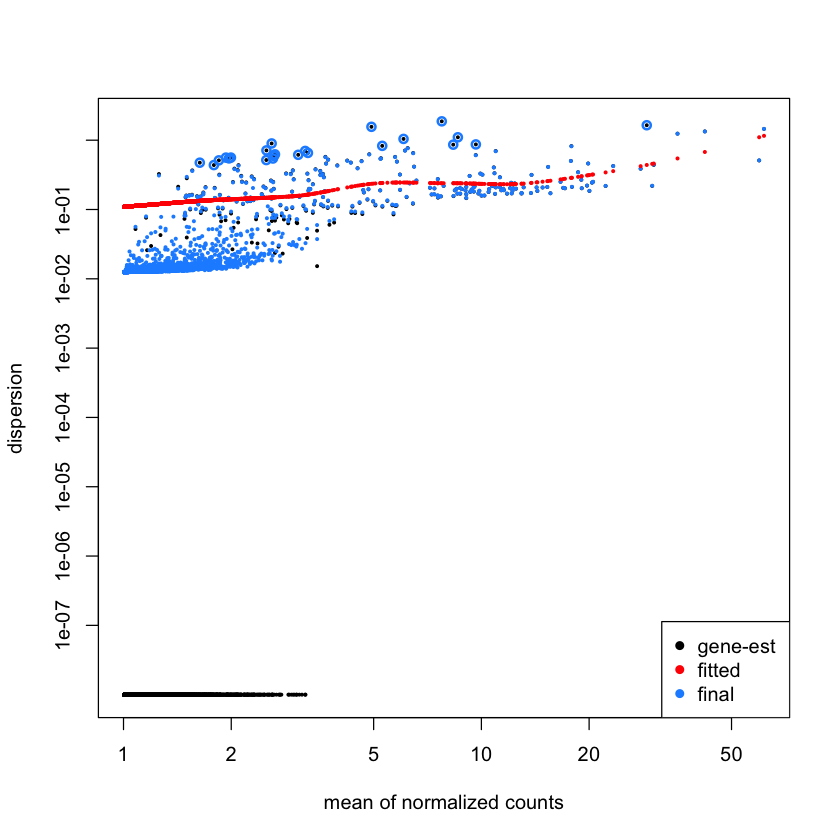

In [13]:
Tissue_stem_cells <- get_dds_LRTresults(clusters[9])

## Differential Expression Visuals

In [ ]:
setwd("./deseq_objects2")
list.files()

### Tissue stem cells

In [4]:
Tissue_stem_cells <- readRDS(file = "Tissue_stem_cells_deseq.rds")
Tissue_stem_cells

res_tissue <- results(Tissue_stem_cells)
saveRDS(file = "res_tissue.rds")
head(res_tissue)

class: DESeqDataSet 
dim: 25072 1055 
metadata(1): version
assays(4): counts mu H cooks
rownames(25072): AL627309.1 AL669831.5 ... LINC02573 BX004987.1
rowData names(31): baseMean baseVar ... deviance maxCooks
colnames(1055): AAGTCGTTCTCCATAT-1_1 ACGGTTAAGGTCGACA-1_1 ...
  TTTCAGTCACATAGCT-1_7 TTTCCTCTCCTTATCA-1_7
colData names(11): orig.ident nCount_RNA ... cluster_id sizeFactor

log2 fold change (MLE): orig.ident pgp1 4 vs h1 1 
LRT p-value: '~ orig.ident' vs '~ 1' 
DataFrame with 6 rows and 6 columns
            baseMean log2FoldChange     lfcSE        stat    pvalue      padj
           <numeric>      <numeric> <numeric>   <numeric> <numeric> <numeric>
AL627309.1   1.00317    9.75034e-06  0.265612 7.11199e-05  1.000000        NA
AL669831.5   1.02504   -2.93838e-02  0.261983 4.70922e-01  0.998175        NA
FAM87B       1.00317    9.75034e-06  0.265612 7.11199e-05  1.000000        NA
LINC00115    1.00888    4.58245e-03  0.265574 5.07007e-02  0.999997        NA
FAM41C       1.00888    4.58249e-03  0.265574 5.00910e-02  0.999997        NA
AL645608.7   1.00317    9.75034e-06  0.265612 7.11199e-05  1.000000        NA

In [5]:
# Up and Down regulated genes
cat("Up-regulated Genes:")
row.names(res_tissue)[which(!is.na(res_tissue$log2FoldChange) & res_tissue$log2FoldChange > 1.0 & res_tissue$padj < 0.05)] 
cat("Down-regulated Genes:")
row.names(res_tissue)[which(!is.na(res_tissue$log2FoldChange) & res_tissue$log2FoldChange < -1.0 & res_tissue$pvalue < 0.05)]

# If you want to exctract them (replace x)
# write.table(x, file, append = FALSE, sep = " ", dec = ".", row.names = TRUE, col.names = TRUE)

Up-regulated Genes:

[1] "JUN"      "S100A10"  "S100A4"   "ATP1B1"   "FRZB"     "COL3A1"  
 [7] "COL5A2"   "FN1"      "SERPINE2" "COL6A3"   "SPON2"    "IGFBP7"  
[13] "VCAN"     "LOX"      "TGFBI"    "SPARC"    "PLAGL1"   "IGFBP3"  
[19] "COL1A2"   "PCOLCE"   "MEST"     "CALD1"    "CD99"     "EGFL6"   
[25] "TIMP1"    "BGN"      "CTHRC1"   "COL15A1"  "COL5A1"   "IFITM3"  
[31] "KCNQ1OT1" "AHNAK"    "NEAT1"    "SERPINH1" "TAGLN"    "PLAC9"   
[37] "ACTA2"    "CCND2"    "MGP"      "KRT18"    "LUM"      "DCN"     
[43] "CKAP4"    "POSTN"    "COL4A1"   "COL4A2"   "DLK1"     "CDH11"   
[49] "MFAP4"    "WSB1"     "COL1A1"   "P4HB"     "RRBP1"    "MYL9"    
[55] "HSPB6"    "FOSB"     "RPL13A"   "TIMP3"    "LGALS1"   "FBLN1"   
[61] "COL6A1"   "COL6A2"

Down-regulated Genes:

[1] "STMN1"      "PRDX1"      "UQCRH"      "PRDX6"      "TNNI1"     
 [6] "ACTA1"      "DBI"        "KLHL41"     "TTN"        "MYL1"      
[11] "IGFBP2"     "PTMA"       "TNNC1"      "H2AFZ"      "HSPB3"     
[16] "PRL"        "NDUFA4"     "CHCHD2"     "TPM2"       "TNNI2"     
[21] "TNNT3"      "PPP1R14B"   "LDHB"       "TUBA1A"     "MYL6B"     
[26] "TAC3"       "COX6A1"     "RAN"        "CKB"        "ACTC1"     
[31] "MYLPF"      "MYH3"       "MYL4"       "JPT1"       "NNAT"      
[36] "TNNC2"      "EMC10"      "AC020909.2" "RPS4Y1"

In [6]:
ntd_tissue <- normTransform(Tissue_stem_cells)
vsd_tissue <- varianceStabilizingTransformation(Tissue_stem_cells)
# head(assay(vsd_tissue), 3)

-- note: fitType='parametric', but the dispersion trend was not well captured by the
   function: y = a/x + b, and a local regression fit was automatically substituted.
   specify fitType='local' or 'mean' to avoid this message next time.



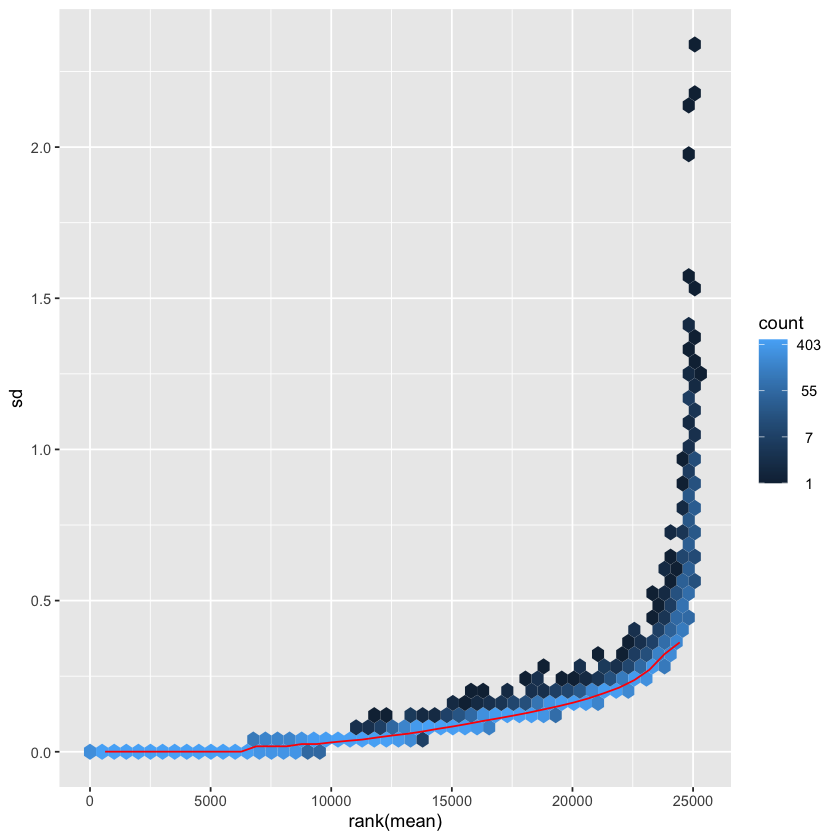

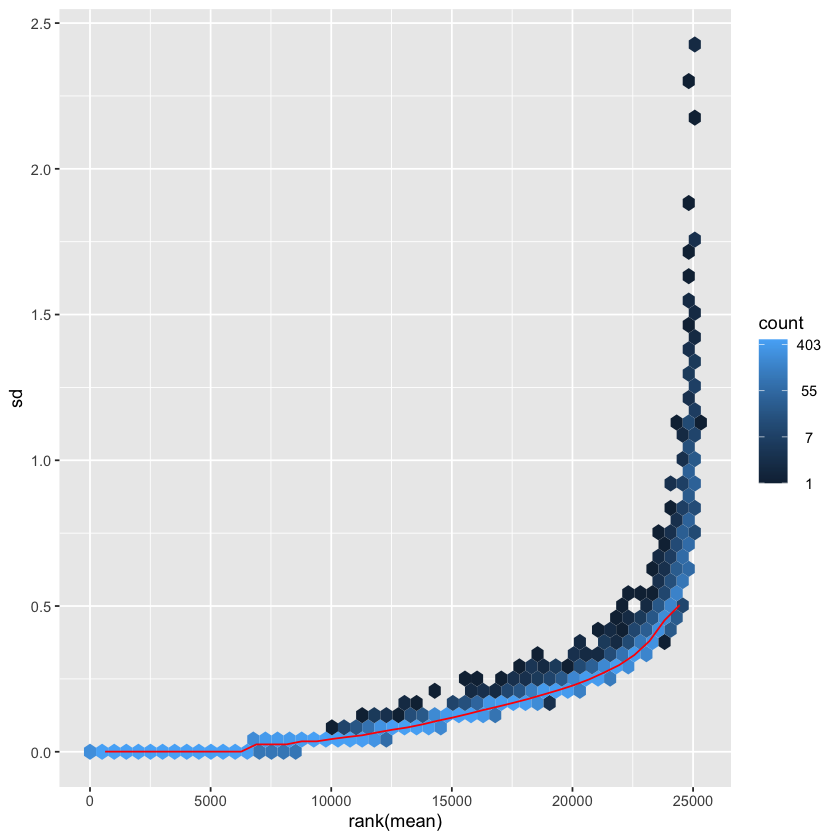

In [7]:
# Couldn't put them side by side (grid.arrange and par did not work I guess because they are not ggplot)
options(repr.plot.width = 7, repr.plot.height = 7)
meanSdPlot(assay(ntd_tissue))
meanSdPlot(assay(vsd_tissue))

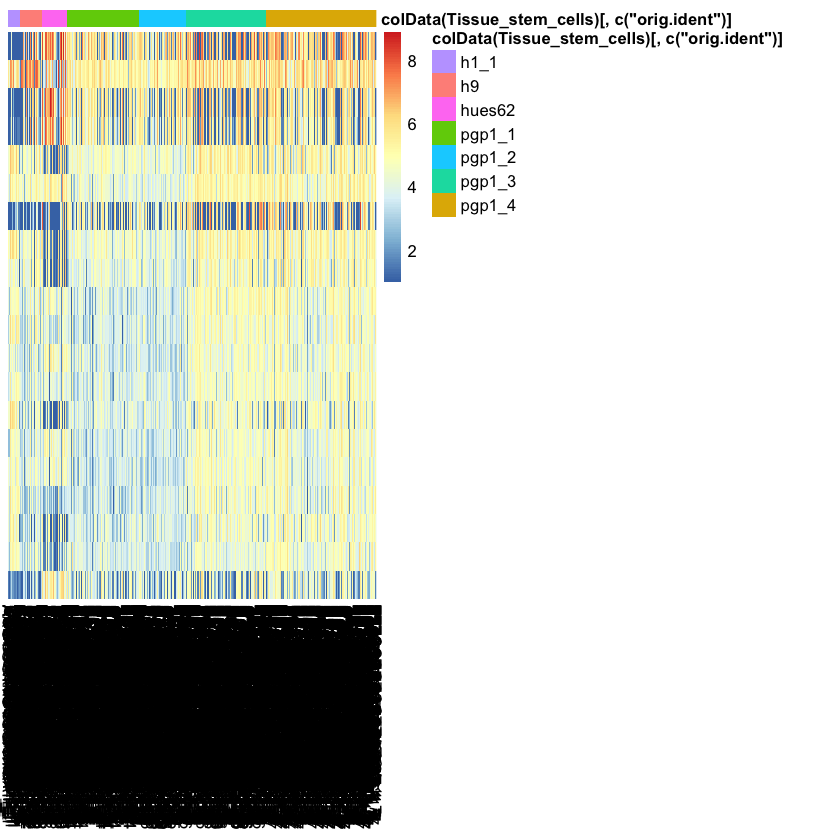

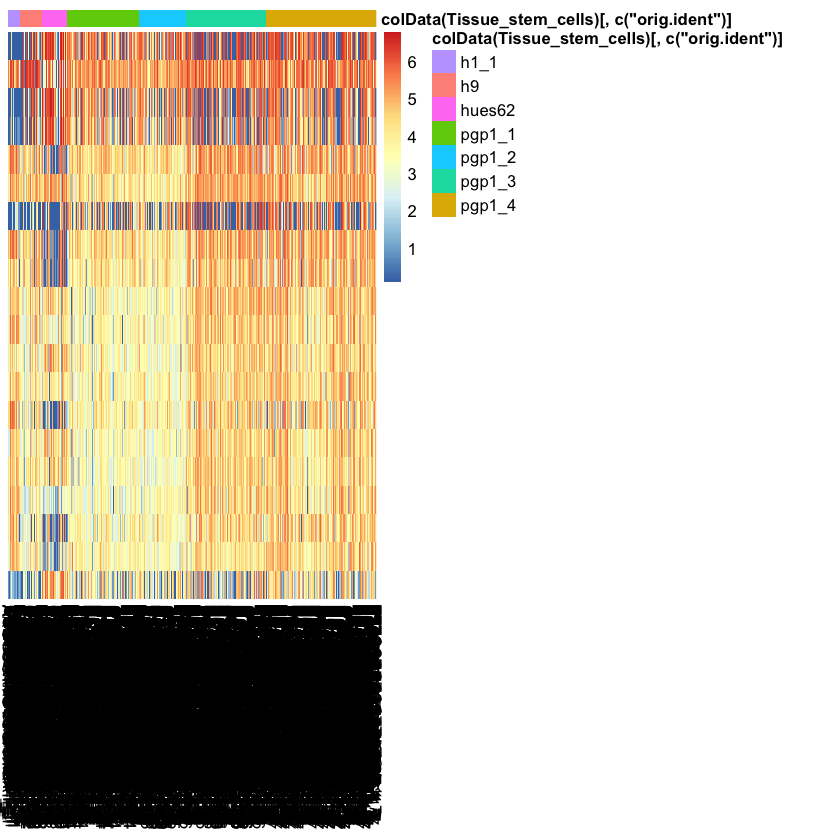

In [9]:
select_1 <- order(rowMeans(counts(Tissue_stem_cells,normalized=TRUE)), decreasing=TRUE)[1:20]
df_1 <- as.data.frame(colData(Tissue_stem_cells)[,c("orig.ident")])
row.names(df_1) <- colnames(ntd_tissue)

pheatmap(assay(ntd_tissue)[select_1,], cluster_rows=FALSE, show_rownames=FALSE,
         cluster_cols=FALSE, annotation_col=df_1)

pheatmap(assay(vsd_tissue)[select_1,], cluster_rows=FALSE, show_rownames=FALSE,
         cluster_cols=FALSE, annotation_col=df_1)

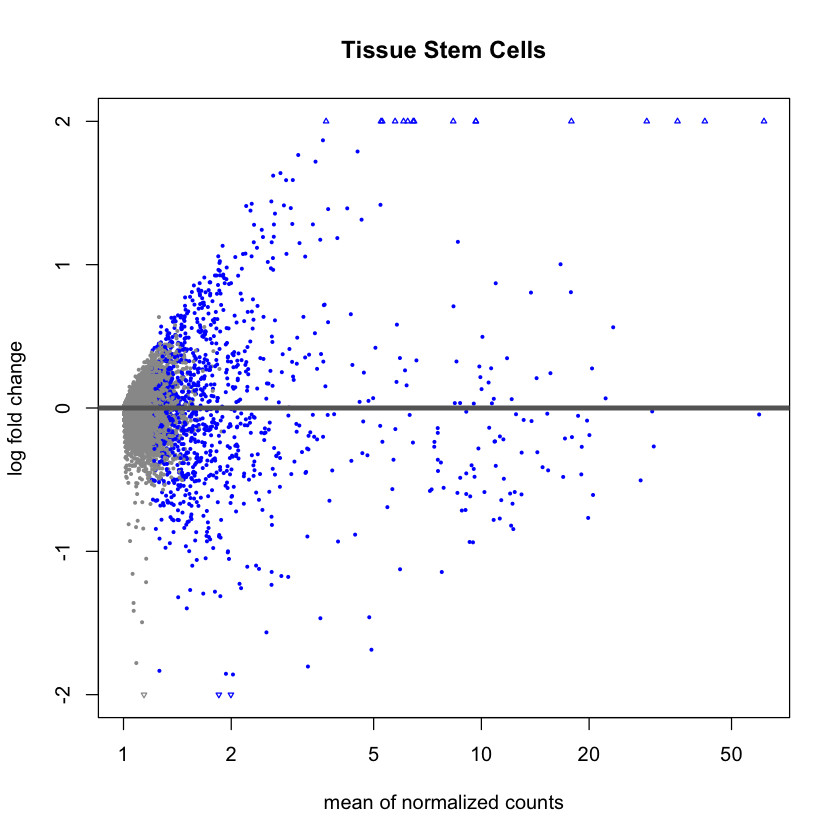

In [20]:
plotMA(res_tissue, ylim = c(-2,2), main = "Tissue Stem Cells")

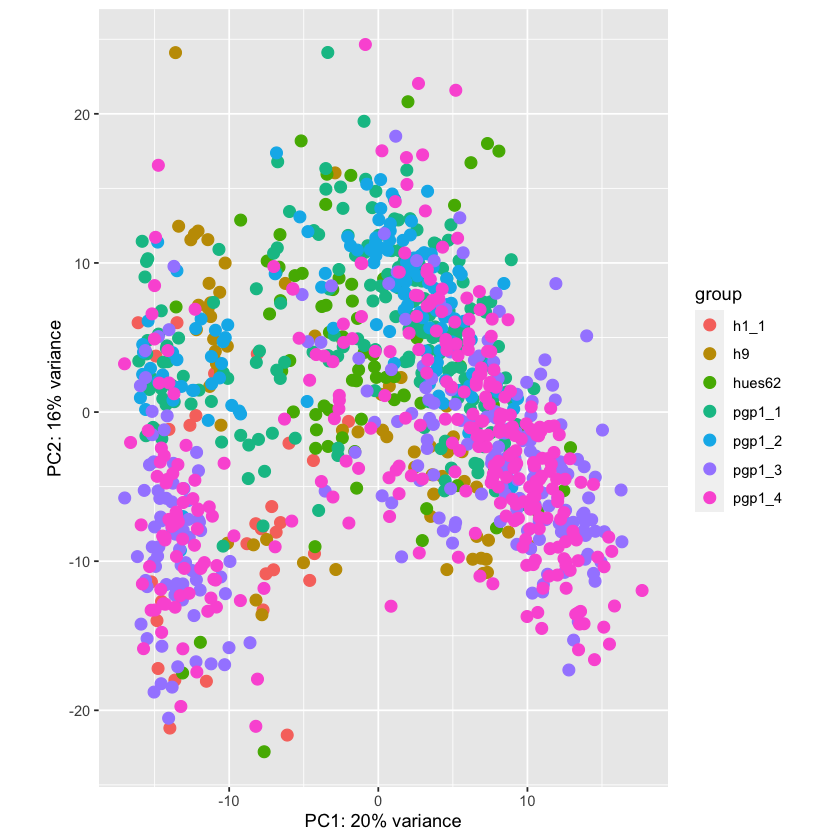

In [21]:
plotPCA(vsd_tissue, intgroup=c("orig.ident"))

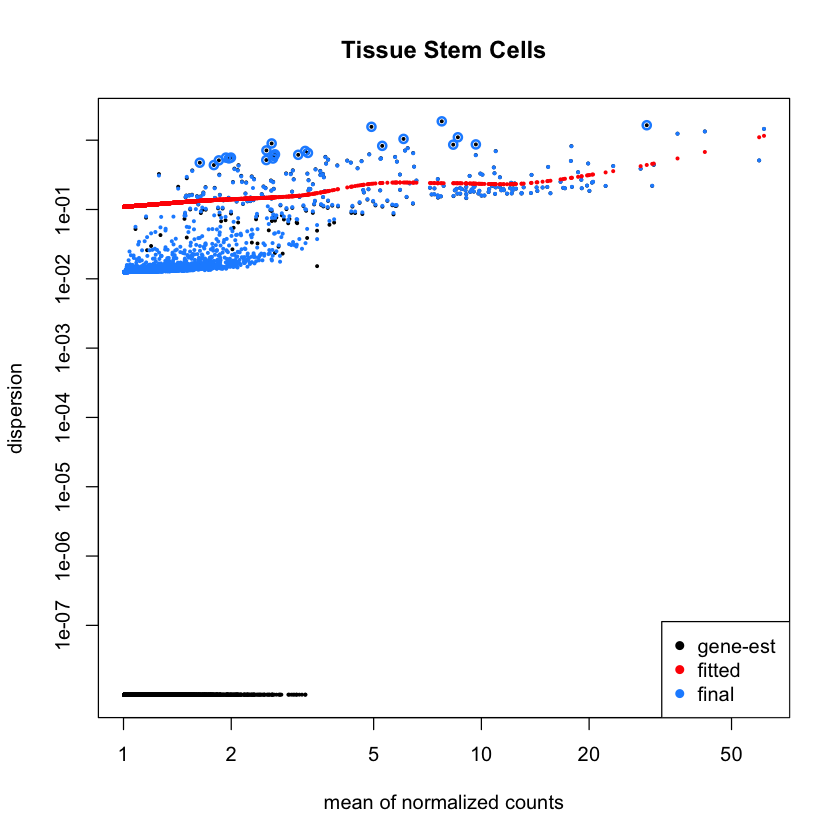

In [22]:
plotDispEsts(Tissue_stem_cells, main = "Tissue Stem Cells")

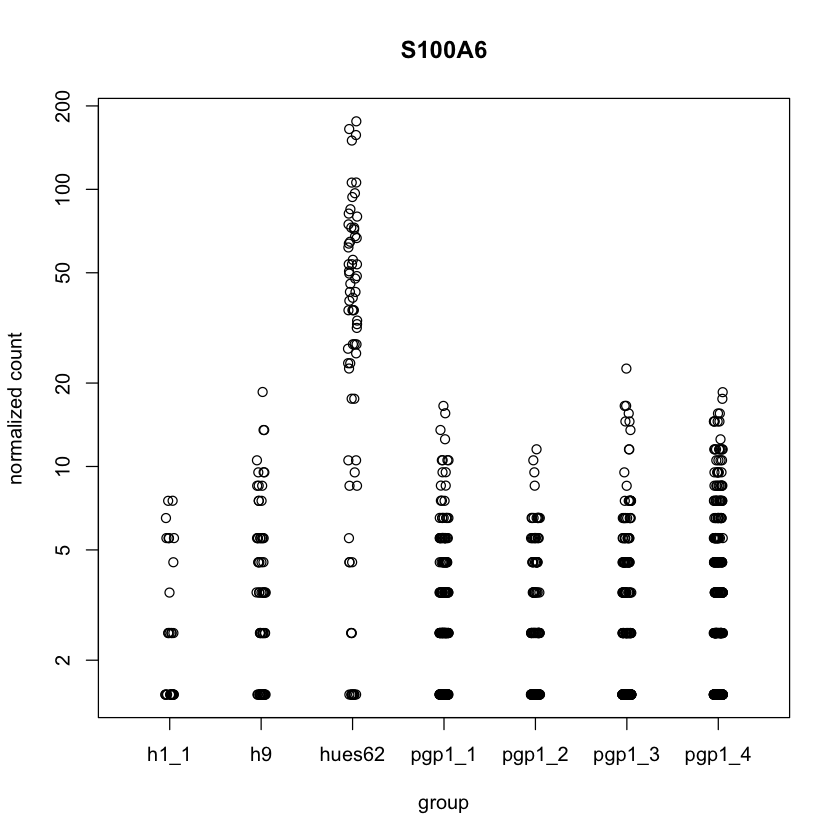

In [23]:
plotCounts(Tissue_stem_cells, gene=which.min(res_tissue$padj), intgroup="orig.ident")

### Astrocytes

In [11]:
Astrocytes <- readRDS(file = "Astrocyte_deseq.rds")
Astrocytes

res_astrocytes <- results(Astrocytes)
saveRDS(file = "res_astrocytes.rds")
head(res_astrocytes)

class: DESeqDataSet 
dim: 25072 1994 
metadata(1): version
assays(4): counts mu H cooks
rownames(25072): AL627309.1 AL669831.5 ... LINC02573 BX004987.1
rowData names(31): baseMean baseVar ... deviance maxCooks
colnames(1994): AAACGAACAACATACC-1_1 AAACGCTGTGACACGA-1_1 ...
  TTTGGTTTCGTGGCTG-1_7 TTTGTTGGTGTACATC-1_7
colData names(11): orig.ident nCount_RNA ... cluster_id sizeFactor

log2 fold change (MLE): orig.ident pgp1 4 vs h1 1 
LRT p-value: '~ orig.ident' vs '~ 1' 
DataFrame with 6 rows and 6 columns
            baseMean log2FoldChange     lfcSE        stat    pvalue      padj
           <numeric>      <numeric> <numeric>   <numeric> <numeric> <numeric>
AL627309.1   1.00323   -0.000593347  0.145178 0.000122261  1.000000        NA
AL669831.5   1.01782    0.010828304  0.143905 0.138564220  0.999947         1
FAM87B       1.00374   -0.001673608  0.145173 0.000669452  1.000000        NA
LINC00115    1.00927    0.005158527  0.144537 0.021021506  1.000000        NA
FAM41C       1.00675    0.008387156  0.144550 0.009745187  1.000000        NA
AL645608.7   1.00424   -0.002753070  0.145169 0.001705878  1.000000        NA

In [12]:
#Up and Down regulated genes
cat("Up-regulated Genes:")
row.names(res_astrocytes)[which(!is.na(res_astrocytes$log2FoldChange) & res_astrocytes$log2FoldChange > 1.0 & res_astrocytes$padj < 0.05)] 
cat("Down-regulated Genes:")
row.names(res_astrocytes)[which(!is.na(res_astrocytes$log2FoldChange) & res_astrocytes$log2FoldChange < -1.0 & res_astrocytes$pvalue < 0.05)]

#write.table(x, file, append = FALSE, sep = " ", dec = ".", row.names = TRUE, col.names = TRUE)

Up-regulated Genes:

[1] "NHLH1"    "COL3A1"   "HES6"     "TAGLN3"   "MARCKS"   "PTN"     
 [7] "KCNQ1OT1" "CRABP1"   "COL1A1"   "TTR"      "ID1"      "ELAVL3"  
[13] "FOSB"

Down-regulated Genes:

[1] "ENO1"     "RPL11"    "YBX1"     "UQCRH"    "CRABP2"   "RPS7"    
 [7] "RPS27A"   "HSPD1"    "IGFBP2"   "RPL32"    "RPL14"    "RPL29"   
[13] "RBP1"     "RPL35A"   "UCHL1"    "OCIAD2"   "RPS3A"    "BTF3"    
[19] "RPS23"    "HINT1"    "NPM1"     "RACK1"    "PRL"      "RPS18"   
[25] "RPL10A"   "CHCHD2"   "DLX6-AS1" "DLX5"     "TMSB4X"   "RPS4X"   
[31] "KCNE5"    "RPL8"     "RPL12"    "RPL7A"    "RPS13"    "LDHA"    
[37] "FTH1"     "PPP1R14B" "GSTP1"    "RPS3"     "PPA1"     "RPS24"   
[43] "GAPDH"    "LDHB"     "RPL41"    "MYL6"     "TAC3"     "ATP2B1"  
[49] "SLC25A3"  "RPL6"     "PEBP1"    "RPL36AL"  "SIX6"     "DLK1"    
[55] "CKB"      "NDN"      "SRP14"    "RPLP1"    "RPS2"     "RPS15A"  
[61] "COX4I1"   "CYBA"     "RPL13"    "C1QBP"    "RPL26"    "RPL23A"  
[67] "RPL19"    "ACTG1"    "NNAT"     "GNAS"     "ATP5F1E"  "EDN3"    
[73] "PRDX2"    "RPS19"    "RPL18"    "FTL"      "RPS9"     "RPS5"    
[79] "RPS4Y1"   "RPL3"

In [13]:
ntd_astrocytes <- normTransform(Astrocytes)
vsd_astrocytes <- varianceStabilizingTransformation(Astrocytes)

-- note: fitType='parametric', but the dispersion trend was not well captured by the
   function: y = a/x + b, and a local regression fit was automatically substituted.
   specify fitType='local' or 'mean' to avoid this message next time.



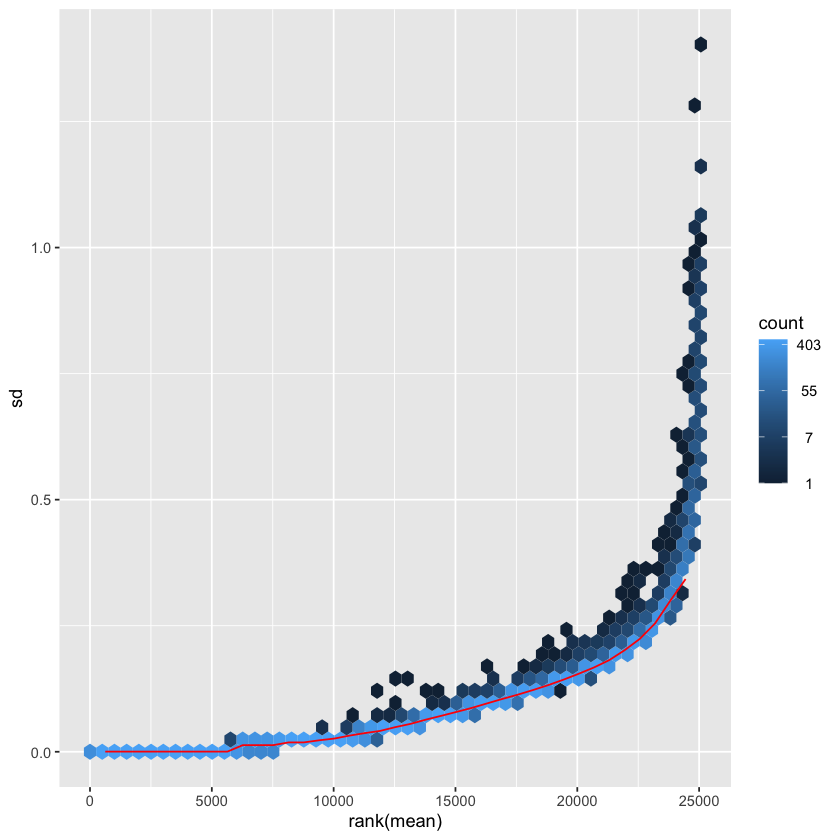

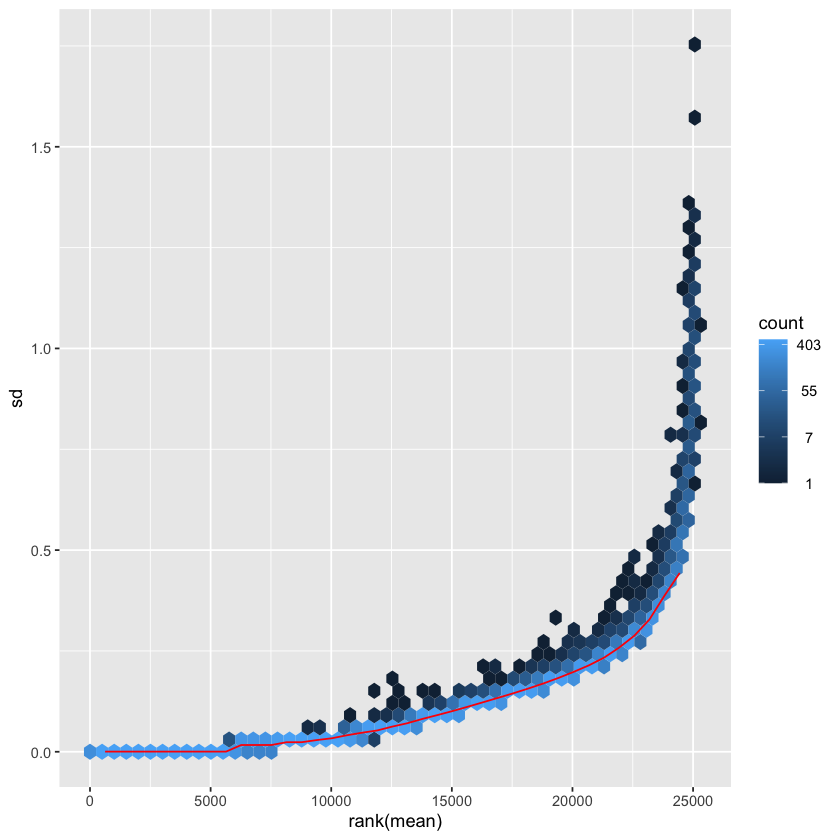

In [14]:
options(repr.plot.width = 7, repr.plot.height = 7)
meanSdPlot(assay(ntd_astrocytes))
meanSdPlot(assay(vsd_astrocytes))

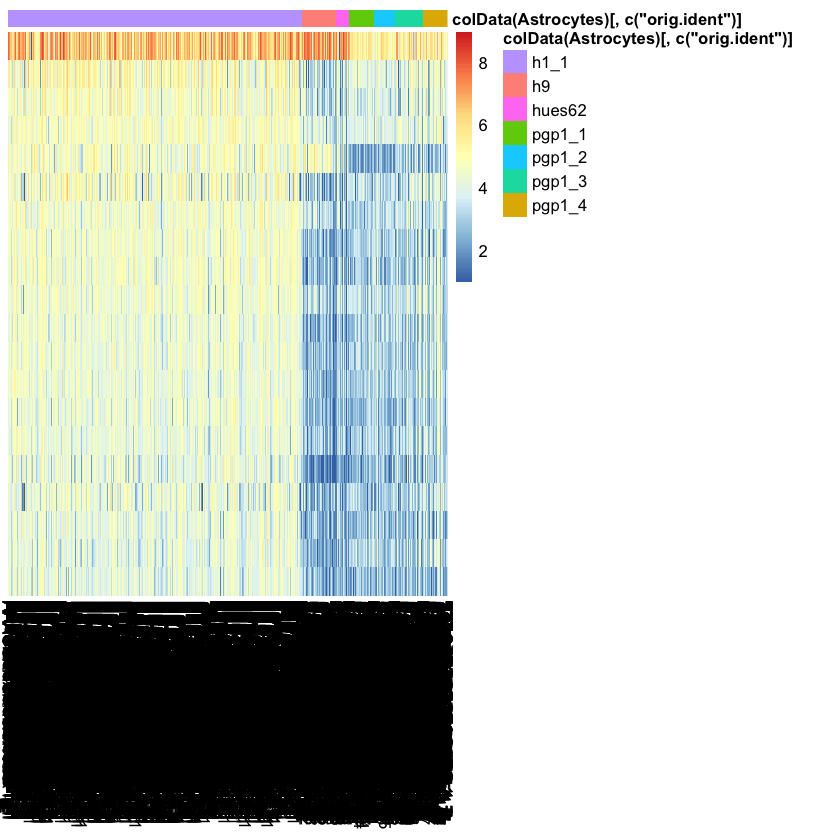

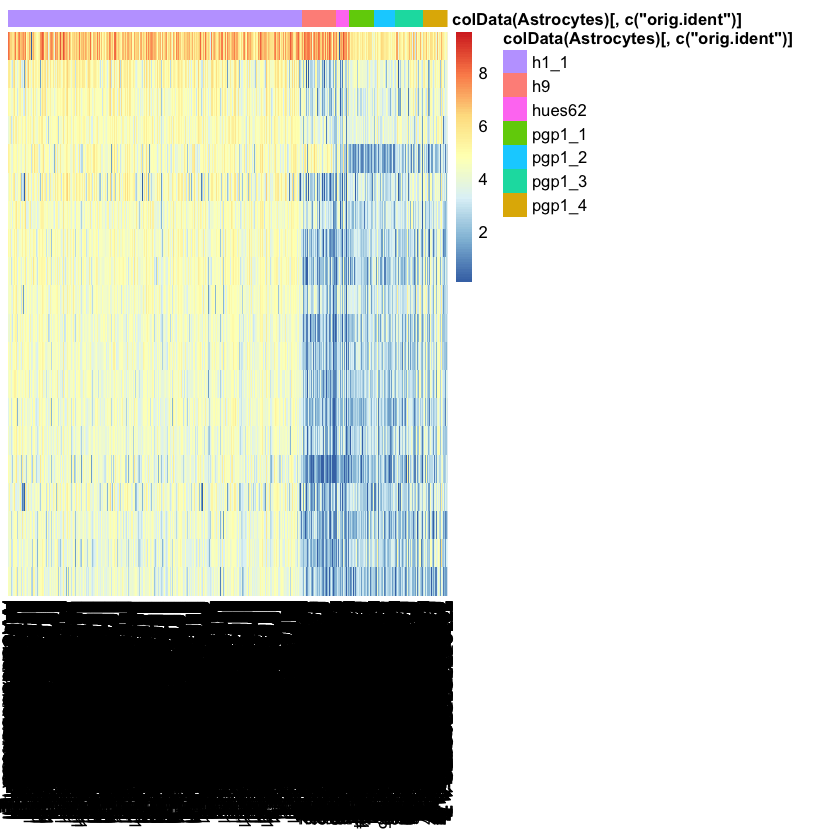

In [15]:
select_2 <- order(rowMeans(counts(Astrocytes,normalized=TRUE)), decreasing=TRUE)[1:20]
df_2 <- as.data.frame(colData(Astrocytes)[,c("orig.ident")])
row.names(df_2) <- colnames(ntd_astrocytes)

pheatmap(assay(ntd_astrocytes)[select_2,], cluster_rows=FALSE, show_rownames=FALSE,
         cluster_cols=FALSE, annotation_col=df_2)

pheatmap(assay(vsd_astrocytes)[select_2,], cluster_rows=FALSE, show_rownames=FALSE,
         cluster_cols=FALSE, annotation_col=df_2)

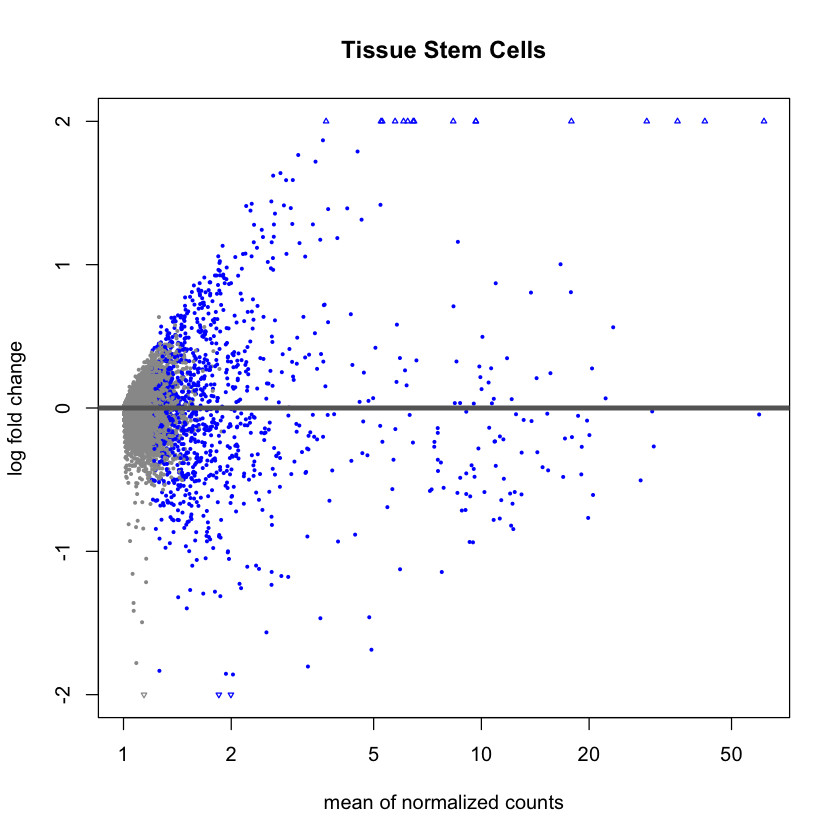

In [26]:
plotMA(res_tissue, ylim = c(-2,2), main = "Tissue Stem Cells")

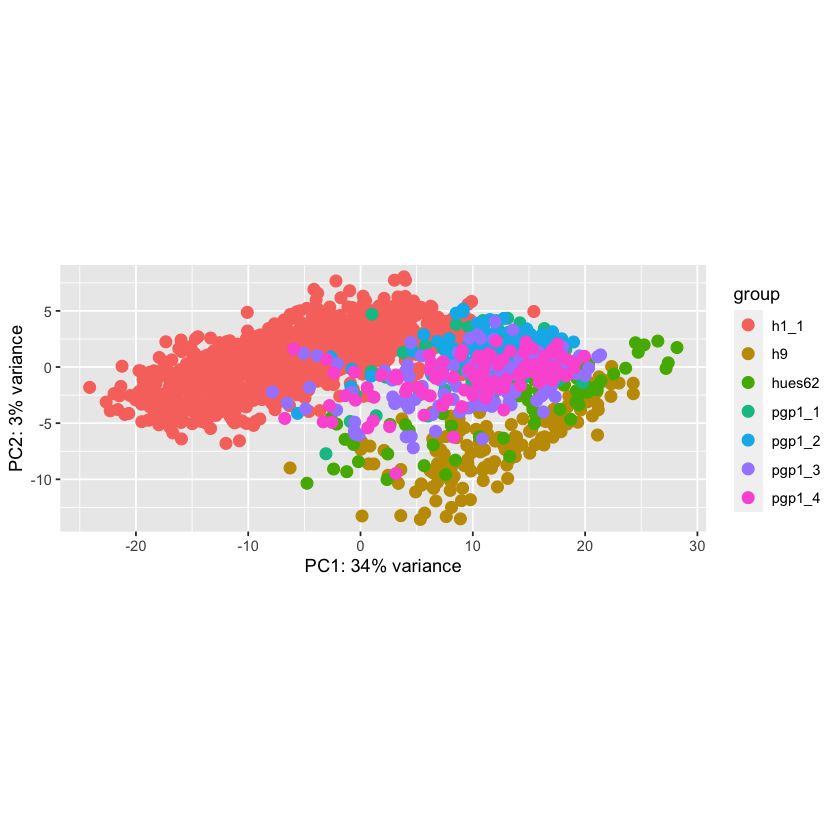

In [27]:
plotPCA(vsd_astrocytes, intgroup=c("orig.ident"))

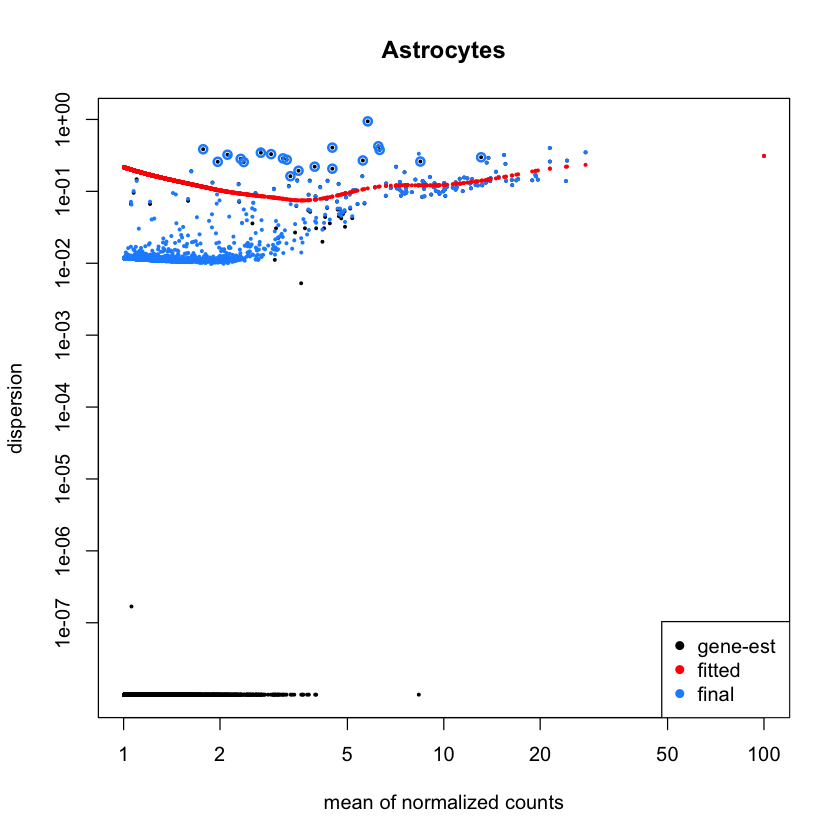

In [28]:
plotDispEsts(Astrocytes, main = "Astrocytes")

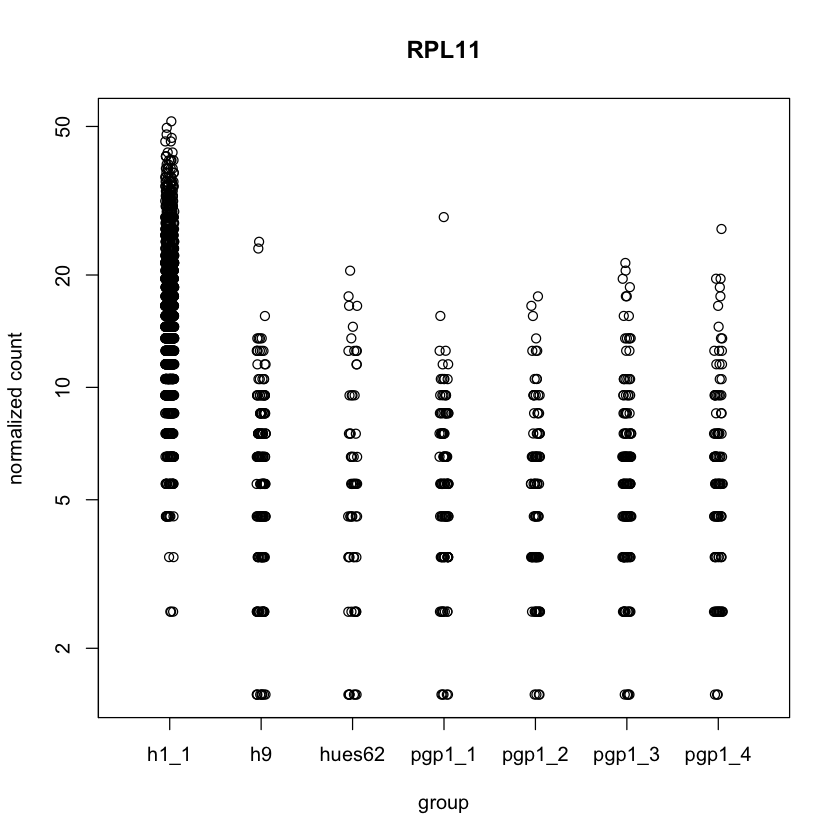

In [29]:
plotCounts(Astrocytes, gene=which.min(res_astrocytes$padj), intgroup="orig.ident")

### Chondrocytes

In [4]:
Chondrocytes <- readRDS(file = "Chondrocytes_deseq.rds")
Chondrocytes

res_chondrocytes <- results(Chondrocytes)
saveRDS(res_chondrocytes, file = "res_chondrocytes.rds")
head(res_chondrocytes)

class: DESeqDataSet 
dim: 25072 7536 
metadata(1): version
assays(4): counts mu H cooks
rownames(25072): AL627309.1 AL669831.5 ... LINC02573 BX004987.1
rowData names(31): baseMean baseVar ... deviance maxCooks
colnames(7536): AAACCCAAGTTAACAG-1_1 AAACGCTGTGTCTTCC-1_1 ...
  TTTGATCTCTAGGCCG-1_7 TTTGGTTTCTTCGATT-1_7
colData names(11): orig.ident nCount_RNA ... cluster_id sizeFactor

log2 fold change (MLE): orig.ident pgp1 4 vs h1 1 
LRT p-value: '~ orig.ident' vs '~ 1' 
DataFrame with 6 rows and 6 columns
            baseMean log2FoldChange     lfcSE        stat    pvalue      padj
           <numeric>      <numeric> <numeric>   <numeric> <numeric> <numeric>
AL627309.1   1.00405     0.00126405 0.0549048 0.002833525  1.000000        NA
AL669831.5   1.02202    -0.00234089 0.0545154 0.265019492  0.999649         1
FAM87B       1.00498    -0.00490923 0.0548353 0.010820245  1.000000        NA
LINC00115    1.00631    -0.00029603 0.0548232 0.007306386  1.000000        NA
FAM41C       1.00578    -0.00529482 0.0548150 0.018293445  1.000000        NA
AL645608.7   1.00351     0.00041765 0.0549113 0.000602676  1.000000        NA

In [7]:
#Up and Down regulated genes
cat("Up-regulated Genes:")
row.names(res_chondrocytes)[which(!is.na(res_chondrocytes$log2FoldChange) & res_chondrocytes$log2FoldChange > 1.0 & res_chondrocytes$padj < 0.05)] 
cat("Down-regulated Genes:")
row.names(res_chondrocytes)[which(!is.na(res_chondrocytes$log2FoldChange) & res_chondrocytes$log2FoldChange < -1.0 & res_chondrocytes$pvalue < 0.05)]

#write.table(x, file, append = FALSE, sep = " ", dec = ".", row.names = TRUE, col.names = TRUE)

Up-regulated Genes:

[1] "JUN"      "S100A11"  "COL3A1"   "COL5A2"   "FN1"      "CCDC80"  
 [7] "SFRP2"    "IRF1"     "SPARC"    "AKAP12"   "IGFBP3"   "COL1A2"  
[13] "PTN"      "ITM2A"    "GPC3"     "SFRP1"    "OGN"      "COL5A1"  
[19] "IFITM3"   "KCNQ1OT1" "CCND2"    "MGP"      "LUM"      "DCN"     
[25] "POSTN"    "FOS"      "CRABP1"   "IGFBP4"   "COL1A1"   "TTR"     
[31] "RRBP1"    "ID1"      "JUNB"     "FOSB"     "LGALS1"   "COL6A1"  
[37] "COL6A2"

Down-regulated Genes:

[1] "ENO1"     "STMN1"    "HMGN2"    "ATP5IF1"  "NDUFS5"   "YBX1"    
 [7] "PRDX1"    "UQCRH"    "H3F3A"    "TOMM20"   "ODC1"     "HSPD1"   
[13] "IGFBP2"   "PTMA"     "RPL29"    "OCIAD2"   "H2AFZ"    "HINT1"   
[19] "NPM1"     "PRL"      "HMGA1"    "CHCHD2"   "DLX6-AS1" "DLX5"    
[25] "TMSB4X"   "PGK1"     "RPL12"    "RPL7A"    "LDHA"     "PPP1R14B"
[31] "GSTP1"    "PPA1"     "DDIT4"    "PGAM1"    "BNIP3"    "GAPDH"   
[37] "LDHB"     "TUBA1A"   "TAC3"     "ATP2B1"   "PEBP1"    "RAN"     
[43] "RPL36AL"  "SIX6"     "CKB"      "SRP14"    "C1QBP"    "JPT1"    
[49] "NNAT"     "PRDX2"    "RPS4Y1"

In [11]:
ntd_chondrocytes <- normTransform(Chondrocytes)
# vsd_chondrocytes <- varianceStabilizingTransformation(Chondrocytes) — Memory issues

ERROR: Error: vector memory exhausted (limit reached?)


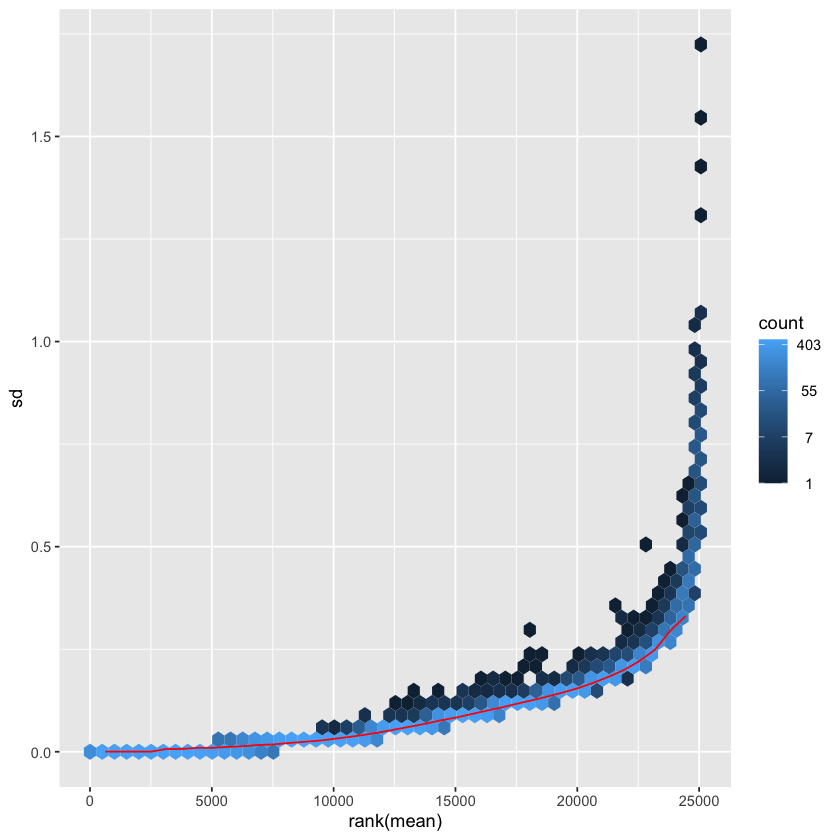

In [12]:
options(repr.plot.width = 7, repr.plot.height = 7)
meanSdPlot(assay(ntd_chondrocytes))
# meanSdPlot(assay(vsd_chondrocytes))

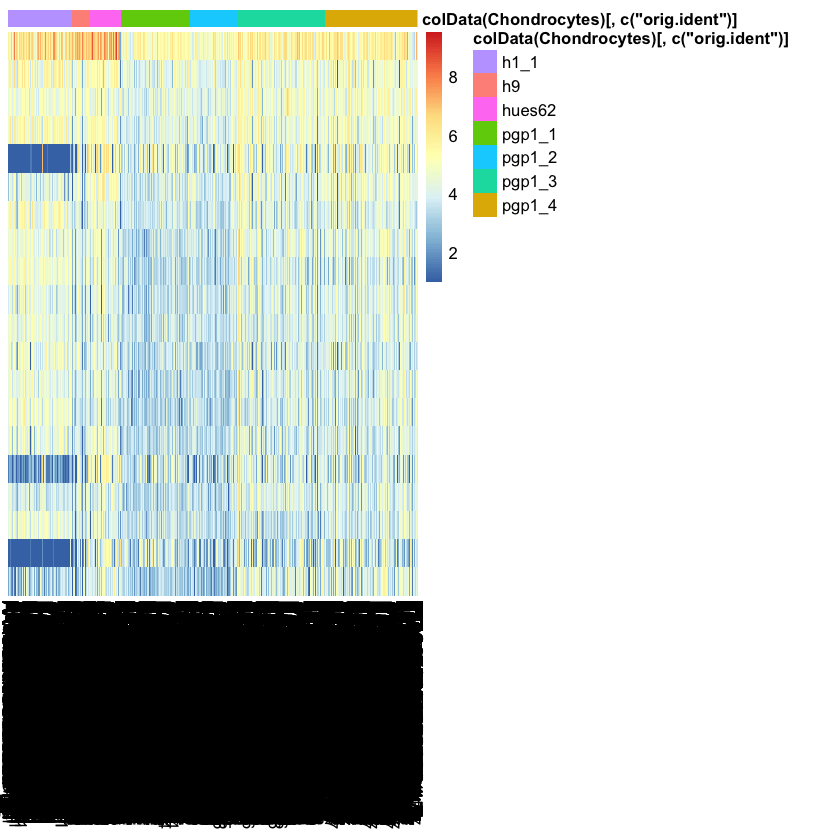

In [13]:
select_3 <- order(rowMeans(counts(Chondrocytes,normalized=TRUE)), decreasing=TRUE)[1:20]
df_3 <- as.data.frame(colData(Chondrocytes)[,c("orig.ident")])
row.names(df_3) <- colnames(ntd_chondrocytes)

pheatmap(assay(ntd_chondrocytes)[select_3,], cluster_rows=FALSE, show_rownames=FALSE,
         cluster_cols=FALSE, annotation_col=df_3)

# pheatmap(assay(vsd_chondrocytes)[select_3,], cluster_rows=FALSE, show_rownames=FALSE,cluster_cols=FALSE, annotation_col=df_3)

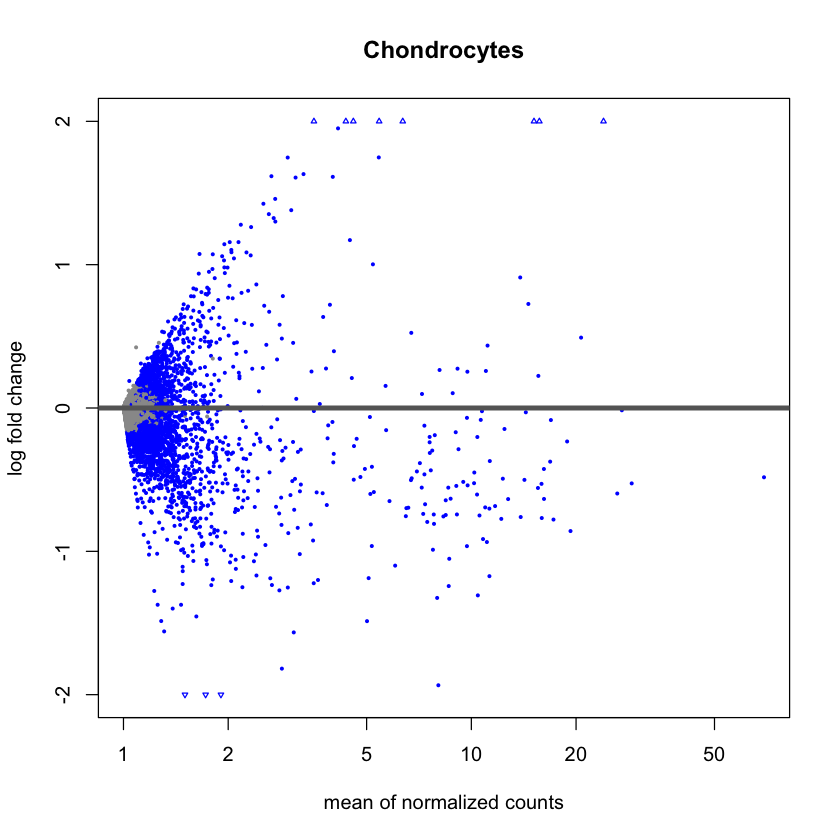

In [14]:
plotMA(res_chondrocytes, ylim = c(-2,2), main = "Chondrocytes")

In [ ]:
# plotPCA(vsd_chondrocytes, intgroup=c("orig.ident"))

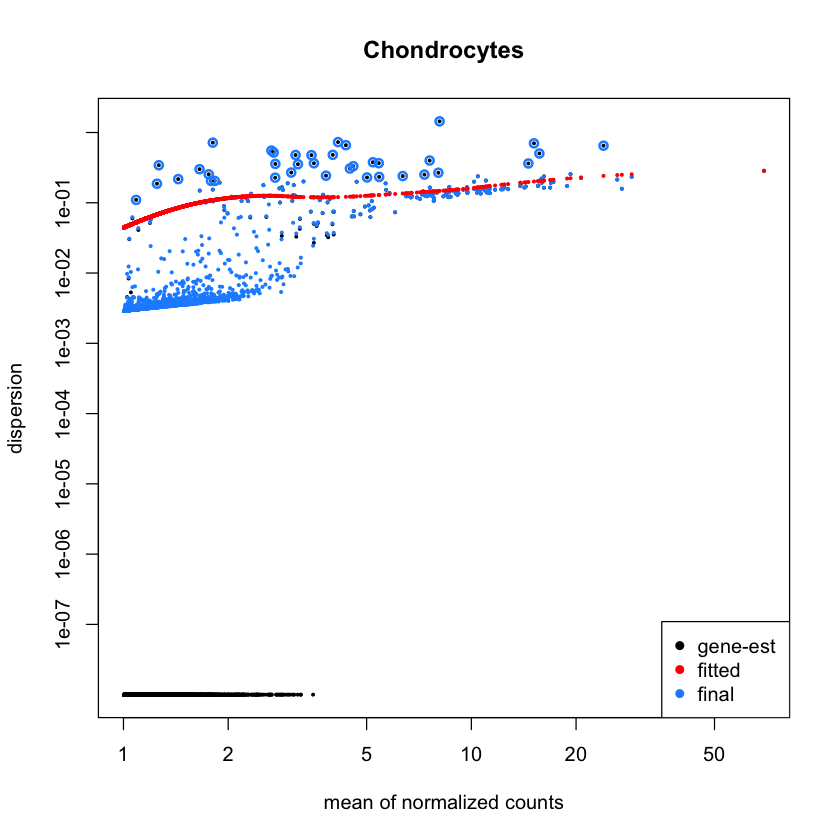

In [15]:
plotDispEsts(Chondrocytes, main = "Chondrocytes")

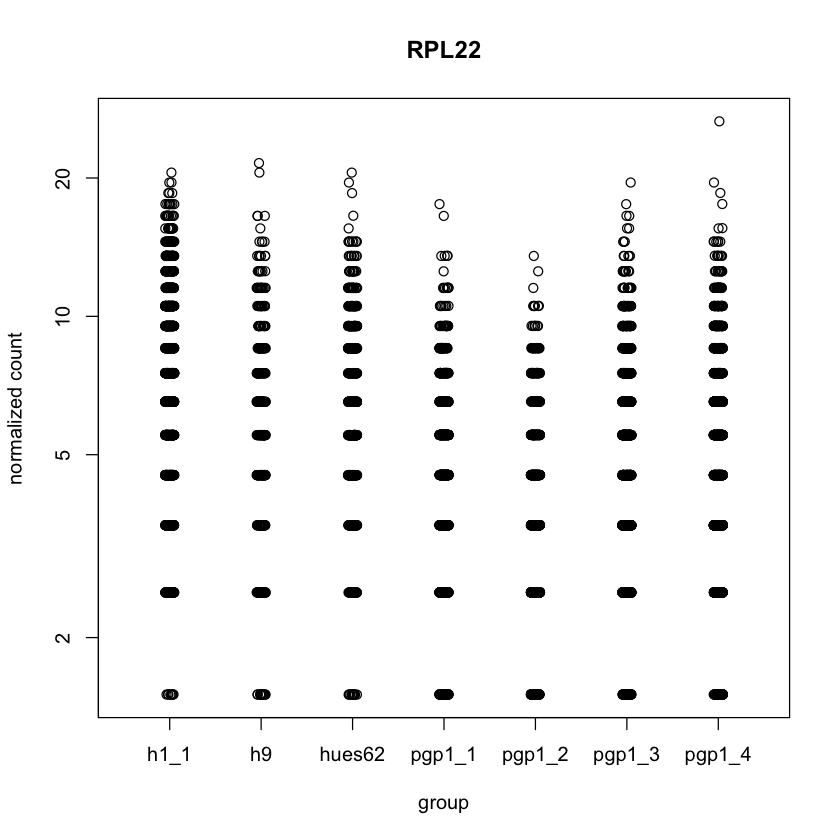

In [16]:
plotCounts(Chondrocytes, gene=which.min(res_chondrocytes$padj), intgroup="orig.ident")

### Epithelial Cells

In [17]:
Epithelial_cells <- readRDS(file = "Epithelial_cells_deseq.rds")
Epithelial_cells

res_epithelial <- results(Epithelial_cells)
saveRDS(res_epithelial, file = "res_epithelial.rds")
head(res_epithelial)

class: DESeqDataSet 
dim: 25072 2511 
metadata(1): version
assays(4): counts mu H cooks
rownames(25072): AL627309.1 AL669831.5 ... LINC02573 BX004987.1
rowData names(31): baseMean baseVar ... deviance maxCooks
colnames(2511): AAAGAACTCGCGTCGA-1_1 AAAGTGAGTTGCACGC-1_1 ...
  TTTGACTCAAATACAG-1_7 TTTGTTGTCAGTGTTG-1_7
colData names(11): orig.ident nCount_RNA ... cluster_id sizeFactor

log2 fold change (MLE): orig.ident pgp1 4 vs h1 1 
LRT p-value: '~ orig.ident' vs '~ 1' 
DataFrame with 6 rows and 6 columns
            baseMean log2FoldChange     lfcSE        stat    pvalue      padj
           <numeric>      <numeric> <numeric>   <numeric> <numeric> <numeric>
AL627309.1   1.00510    0.000242701 0.0925952 2.44541e-03  1.000000        NA
AL669831.5   1.02630   -0.018699484 0.0917815 1.54307e-01  0.999928        NA
FAM87B       1.00670   -0.001986310 0.0924478 6.92472e-03  1.000000        NA
LINC00115    1.01030    0.007515138 0.0921861 4.26703e-02  0.999998        NA
FAM41C       1.01991    0.001661227 0.0922444 2.58502e-01  0.999673        NA
AL645608.7   1.00470    0.000242701 0.0925951 6.55781e-05  1.000000        NA

In [19]:
#Up and Down regulated genes
cat("Up-regulated Genes:")
row.names(res_epithelial)[which(!is.na(res_epithelial$log2FoldChange) & res_epithelial$log2FoldChange > 1.0 & res_epithelial$padj < 0.05)] 
cat("Down-regulated Genes:")
row.names(res_epithelial)[which(!is.na(res_epithelial$log2FoldChange) & res_epithelial$log2FoldChange < -1.0 & res_epithelial$pvalue < 0.05)]

#If you want to exctract them (replace x)
#write.table(x, file, append = FALSE, sep = " ", dec = ".", row.names = TRUE, col.names = TRUE)

Up-regulated Genes:

[1] "S100A10"  "S100A11"  "COL3A1"   "FN1"      "IGFBP7"   "SPARC"   
 [7] "IGFBP3"   "COL1A2"   "PTN"      "TIMP1"    "IFITM3"   "KCNQ1OT1"
[13] "MGP"      "KRT18"    "LUM"      "DCN"      "TPM1"     "KRT19"   
[19] "COL1A1"   "TTR"      "ID1"      "RPL13A"   "LGALS1"   "COL6A1"  
[25] "COL6A2"

Down-regulated Genes:

[1] "HMGN2"    "YBX1"     "UQCRH"    "IGFBP2"   "PTMA"     "RPL29"   
 [7] "FAM162A"  "NPM1"     "PRL"      "HMGA1"    "CHCHD2"   "DLX6-AS1"
[13] "DLX5"     "TMSB4X"   "RPL7A"    "LDHA"     "PPA1"     "DDIT4"   
[19] "BNIP3"    "LDHB"     "TUBA1A"   "TAC3"     "SIX6"     "NDN"     
[25] "SRP14"    "C1QBP"    "NNAT"     "PRDX2"    "RPS4Y1"

In [20]:
ntd_epithelial <- normTransform(Epithelial_cells)
vsd_epithelial <- varianceStabilizingTransformation(Epithelial_cells)

-- note: fitType='parametric', but the dispersion trend was not well captured by the
   function: y = a/x + b, and a local regression fit was automatically substituted.
   specify fitType='local' or 'mean' to avoid this message next time.



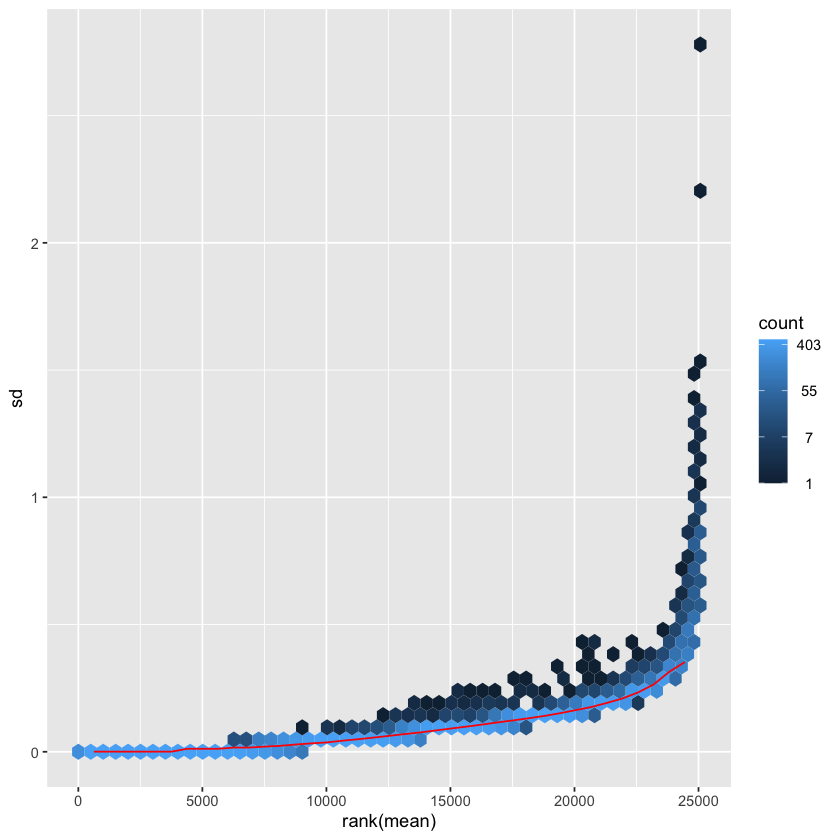

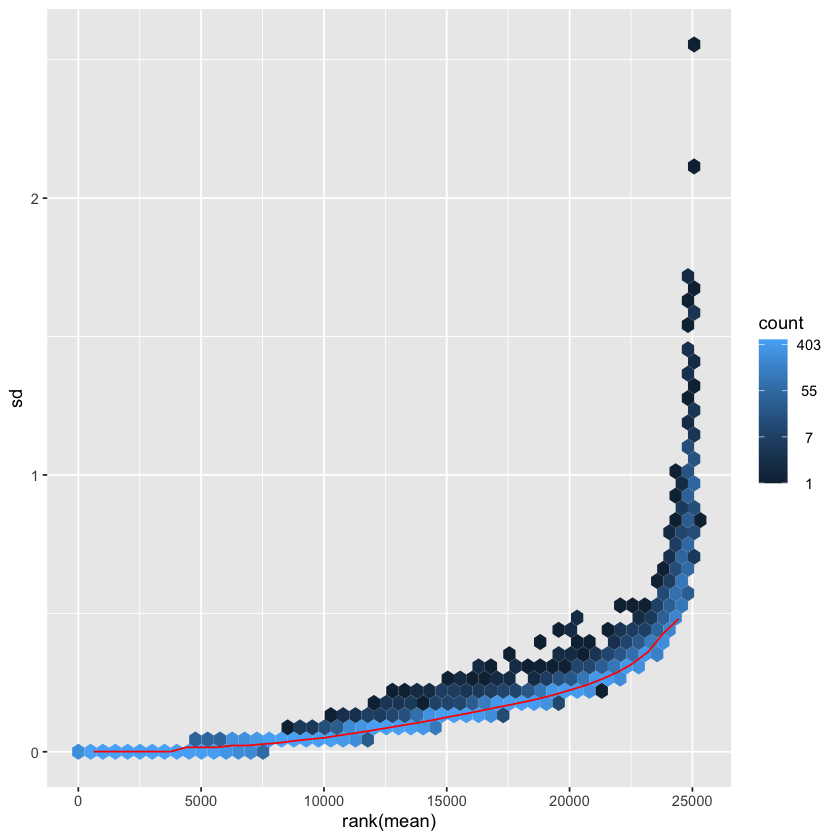

In [21]:
options(repr.plot.width = 7, repr.plot.height = 7)
meanSdPlot(assay(ntd_epithelial))
meanSdPlot(assay(vsd_epithelial))

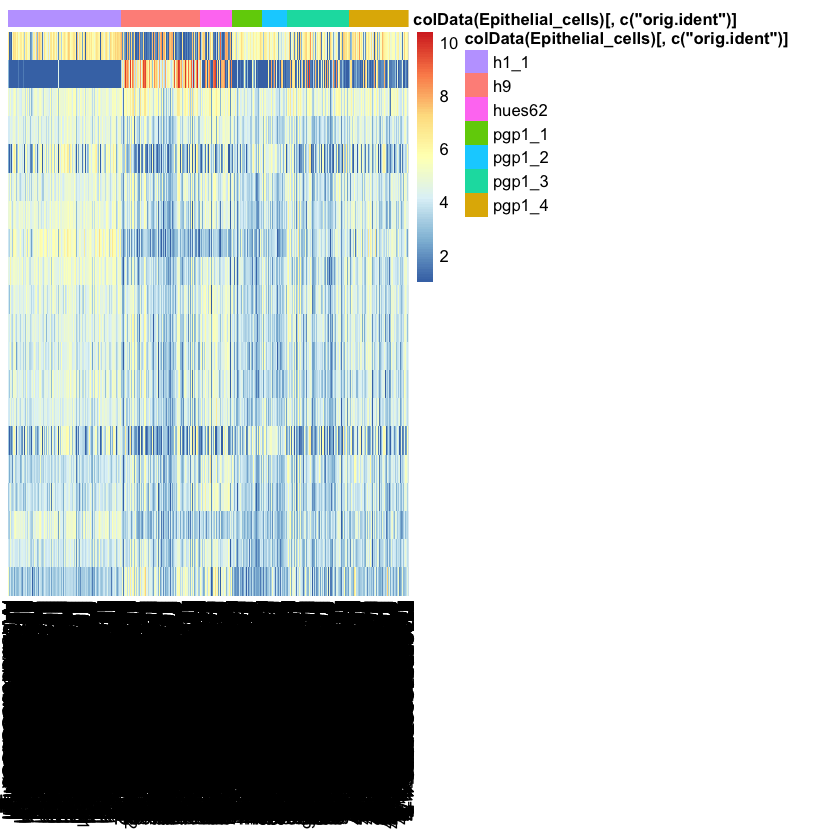

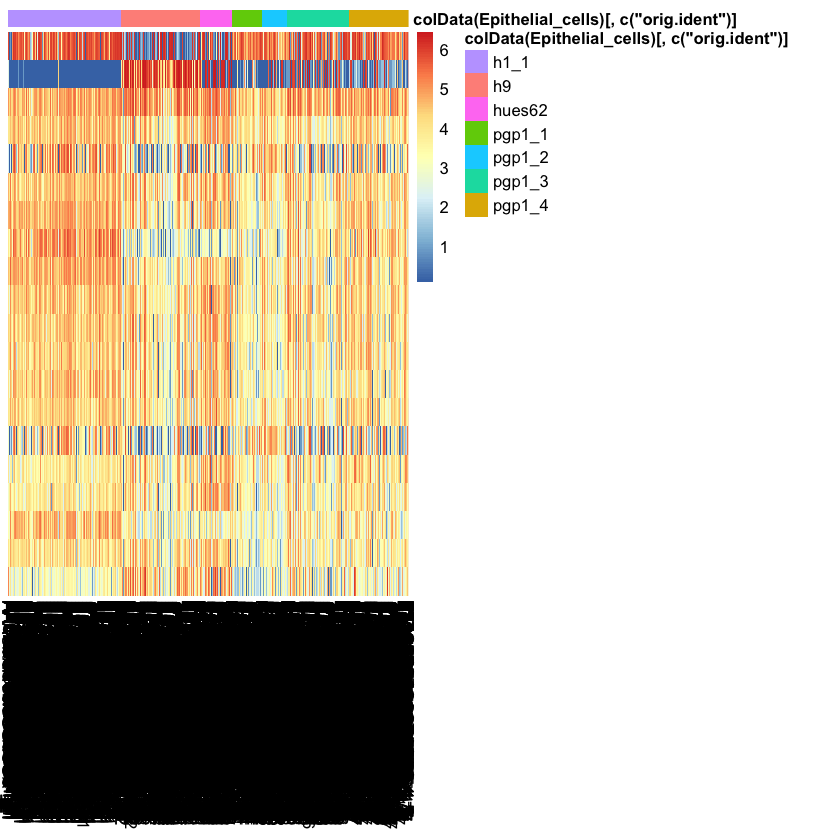

In [22]:
select_4 <- order(rowMeans(counts(Epithelial_cells,normalized=TRUE)), decreasing=TRUE)[1:20]
df_4 <- as.data.frame(colData(Epithelial_cells)[,c("orig.ident")])
row.names(df_4) <- colnames(ntd_epithelial)

pheatmap(assay(ntd_epithelial)[select_4,], cluster_rows=FALSE, show_rownames=FALSE,
         cluster_cols=FALSE, annotation_col=df_4)

pheatmap(assay(vsd_epithelial)[select_4,], cluster_rows=FALSE, show_rownames=FALSE,
         cluster_cols=FALSE, annotation_col=df_4)

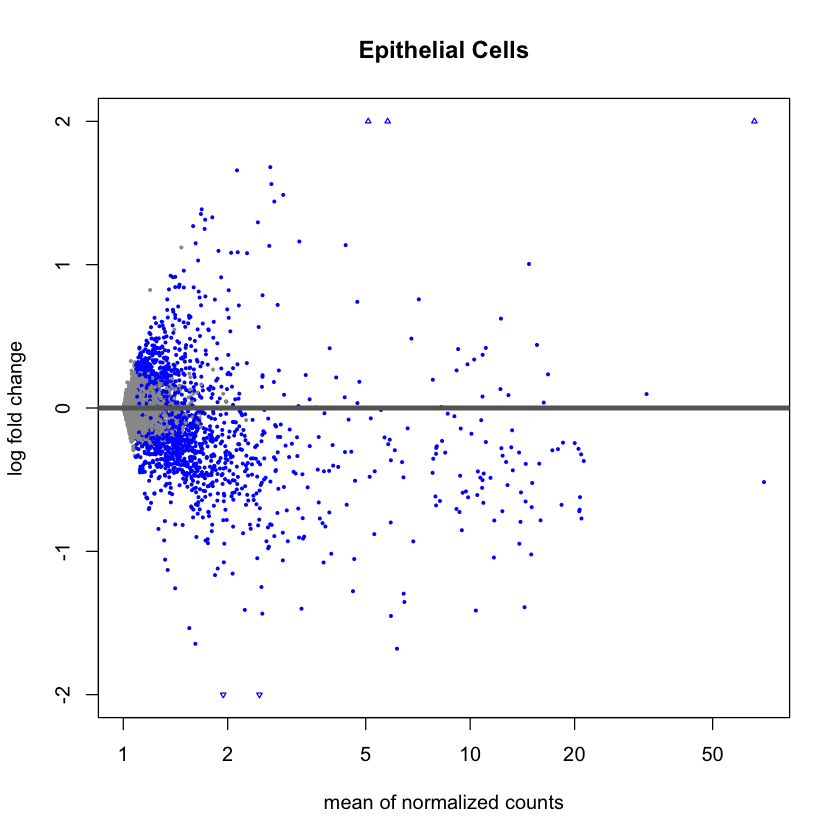

In [23]:
plotMA(res_epithelial, ylim = c(-2,2), main = "Epithelial Cells")

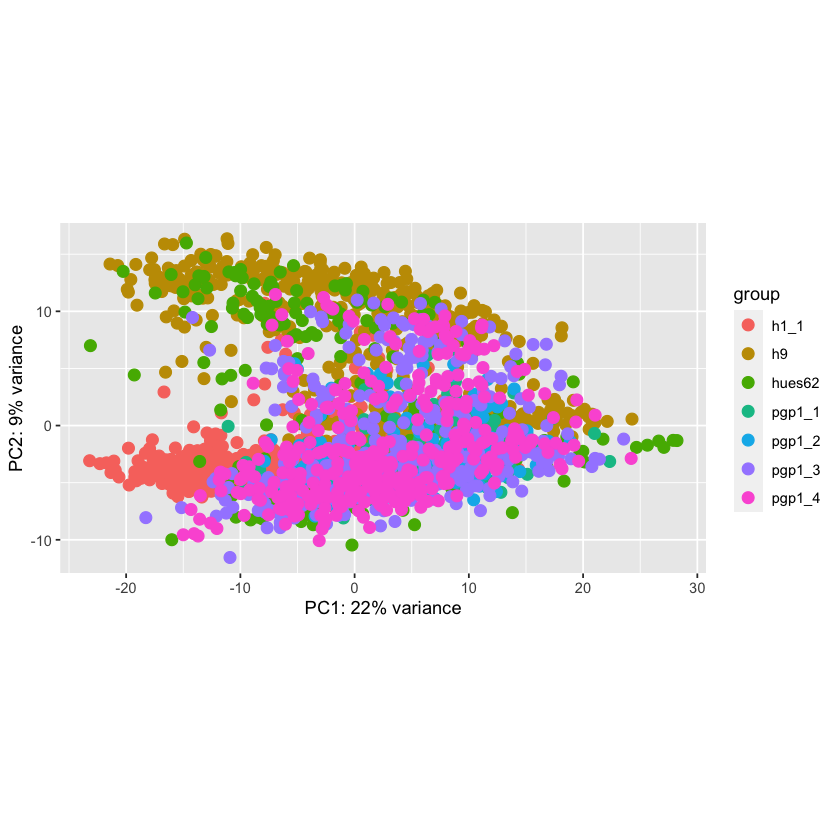

In [24]:
plotPCA(vsd_epithelial, intgroup=c("orig.ident"))

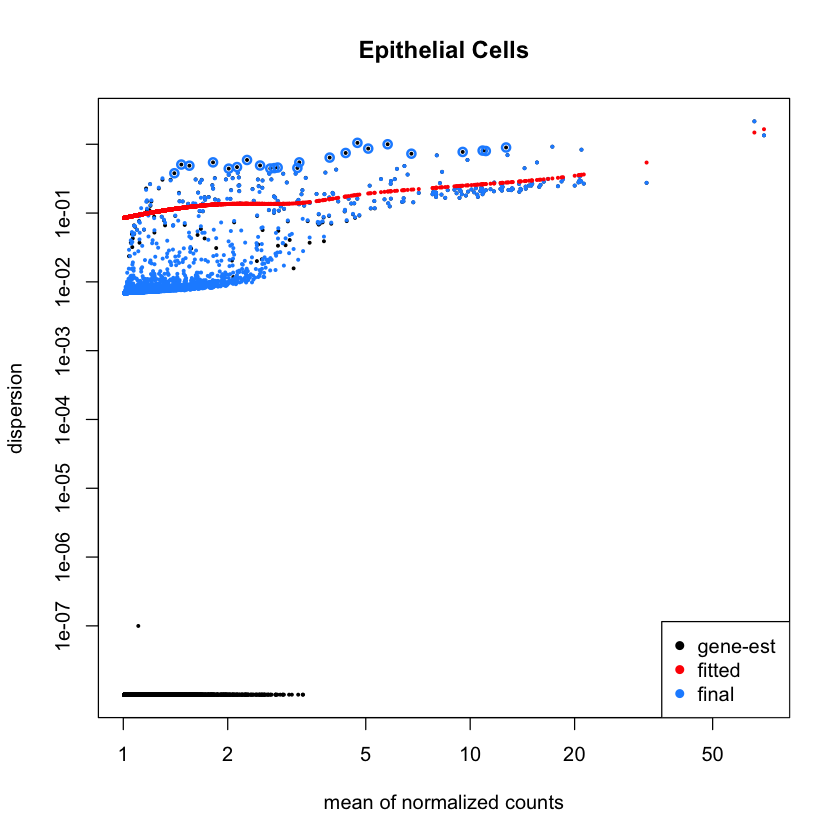

In [25]:
plotDispEsts(Epithelial_cells, main = "Epithelial Cells")

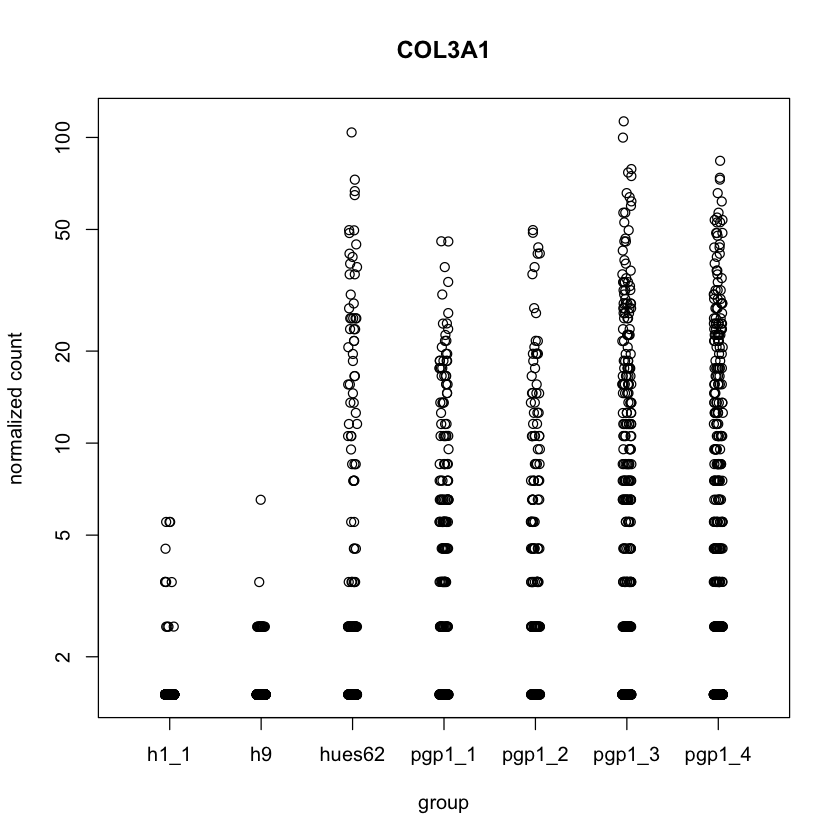

In [26]:
plotCounts(Epithelial_cells, gene=which.min(res_epithelial$padj), intgroup="orig.ident")

### Erythroblasts

In [3]:
Erythroblasts <- readRDS(file = "Erythroblast_deseq.rds")
Erythroblasts

res_erythroblast <- results(Erythroblasts)
saveRDS(res_erythroblast, file = "res_erythroblast.rds")
head(res_erythroblast)

class: DESeqDataSet 
dim: 25072 7190 
metadata(1): version
assays(4): counts mu H cooks
rownames(25072): AL627309.1 AL669831.5 ... LINC02573 BX004987.1
rowData names(31): baseMean baseVar ... deviance maxCooks
colnames(7190): AAACCCAAGAGAGAAC-1_1 AAACCCAGTCCCACGA-1_1 ...
  TTTGGTTTCGTGGACC-1_7 TTTGTTGCAACATCGT-1_7
colData names(11): orig.ident nCount_RNA ... cluster_id sizeFactor

log2 fold change (MLE): orig.ident pgp1 4 vs h1 1 
LRT p-value: '~ orig.ident' vs '~ 1' 
DataFrame with 6 rows and 6 columns
            baseMean log2FoldChange     lfcSE       stat    pvalue      padj
           <numeric>      <numeric> <numeric>  <numeric> <numeric> <numeric>
AL627309.1   1.00415    0.001156168 0.0556770 0.00400371  1.000000        NA
AL669831.5   1.01699   -0.000848160 0.0553483 0.09371076  0.999983        NA
FAM87B       1.00583   -0.006488768 0.0556779 0.02894158  1.000000        NA
LINC00115    1.00834   -0.003734057 0.0555923 0.06395160  0.999995        NA
FAM41C       1.00820   -0.008463353 0.0556374 0.07992908  0.999990        NA
AL645608.7   1.00388    0.000393226 0.0557062 0.00687141  1.000000        NA

In [4]:
#Up and Down regulated genes
cat("Up-regulated Genes:")
row.names(res_erythroblast)[which(!is.na(res_erythroblast$log2FoldChange) & res_erythroblast$log2FoldChange > 1.0 & res_erythroblast$padj < 0.05)] 
cat("Down-regulated Genes:")
row.names(res_erythroblast)[which(!is.na(res_erythroblast$log2FoldChange) & res_erythroblast$log2FoldChange < -1.0 & res_erythroblast$pvalue < 0.05)]
#write.table(x, file, append = FALSE, sep = " ", dec = ".", row.names = TRUE, col.names = TRUE)

Up-regulated Genes:

[1] "JUN"      "COL3A1"   "HIST1H4C" "COL1A2"   "PTN"      "KCNQ1OT1"
 [7] "DCN"      "FOS"      "COL1A1"   "TTR"      "ID1"      "JUNB"    
[13] "FOSB"     "LGALS1"

Down-regulated Genes:

[1] "SRM"      "NDUFS5"   "PRDX1"    "UQCRH"    "ATP5MC3"  "HSPD1"   
 [7] "HSPE1"    "PTMA"     "RPL22L1"  "H2AFZ"    "NPM1"     "CHCHD2"  
[13] "TMSB4X"   "FABP5"    "LDHA"     "PPP1R14B" "PPA1"     "PGAM1"   
[19] "RPS26"    "TAC3"     "RAN"      "RPL36AL"  "SIX6"     "DLK1"    
[25] "NDUFAB1"  "C1QBP"    "NME1"     "JPT1"     "TIMM13"   "UBE2S"   
[31] "RPS4Y1"   "RANBP1"

In [5]:
ntd_erythroblast <- normTransform(Erythroblasts)
# vsd_erythroblast <- varianceStabilizingTransformation(Erythroblasts) — Memory Issues

ERROR: Error: vector memory exhausted (limit reached?)


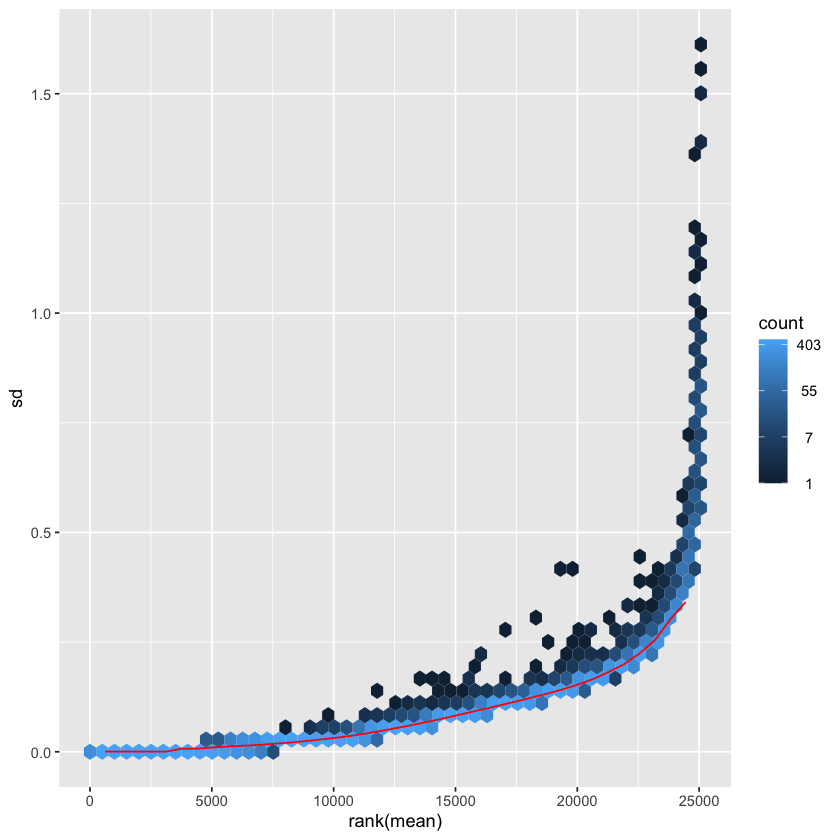

In [7]:
options(repr.plot.width = 7, repr.plot.height = 7)
meanSdPlot(assay(ntd_erythroblast))
# meanSdPlot(assay(vsd_erythroblast)) — Memory Issues

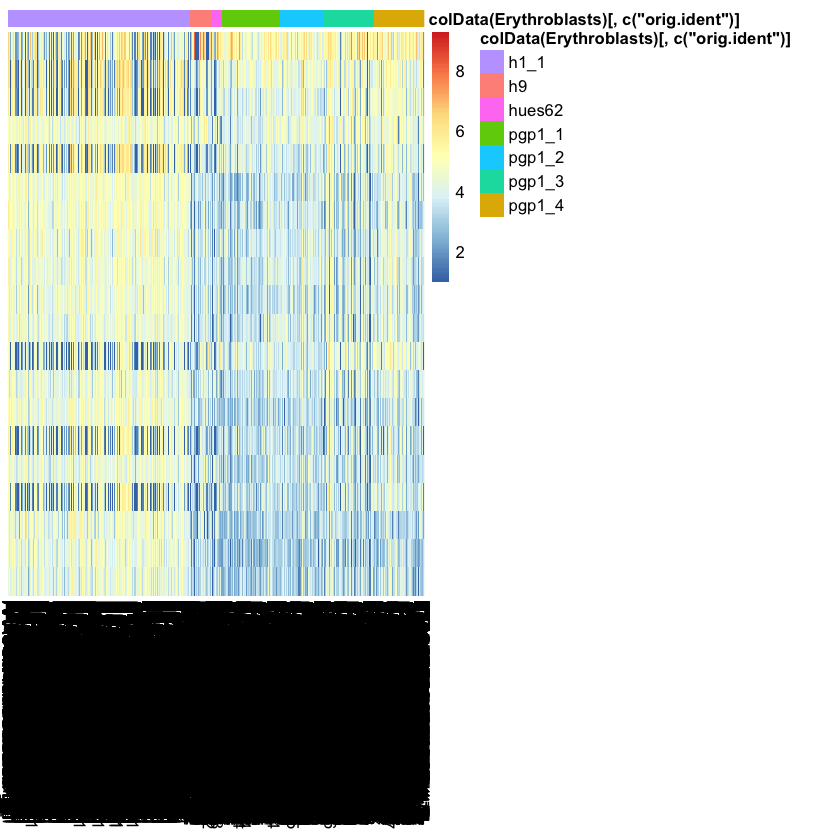

In [8]:
select_5 <- order(rowMeans(counts(Erythroblasts,normalized=TRUE)), decreasing=TRUE)[1:20]
df_5 <- as.data.frame(colData(Erythroblasts)[,c("orig.ident")])
row.names(df_5) <- colnames(ntd_erythroblast)

pheatmap(assay(ntd_erythroblast)[select_5,], cluster_rows=FALSE, show_rownames=FALSE,
         cluster_cols=FALSE, annotation_col=df_5)

# pheatmap(assay(vsd_erythroblast)[select_5,], cluster_rows=FALSE, show_rownames=FALSE, cluster_cols=FALSE, annotation_col=df_5) — Memory Issues

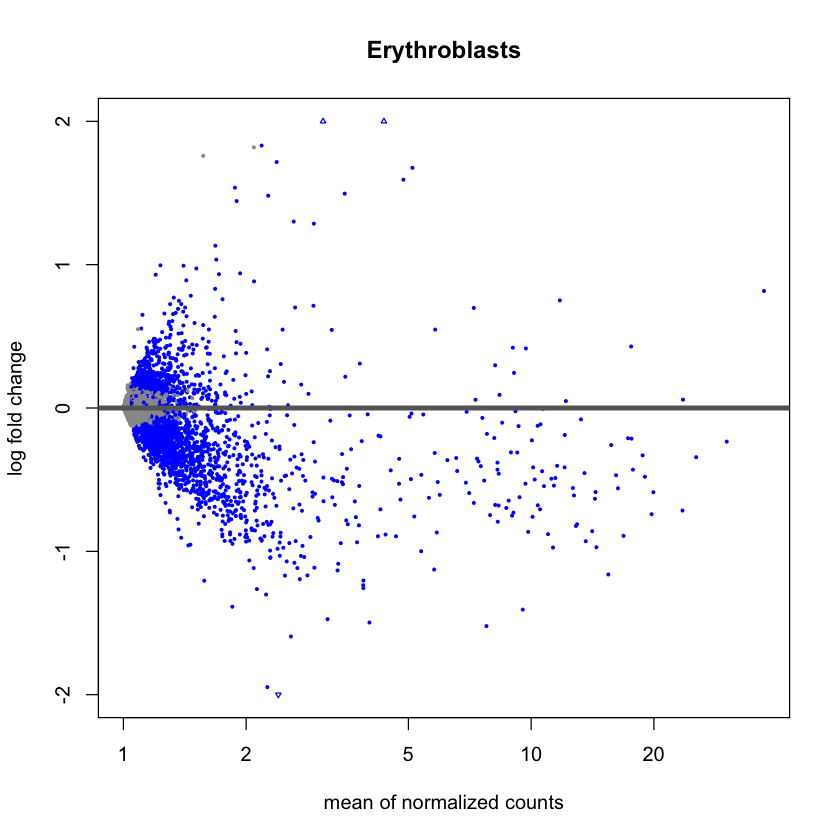

In [9]:
plotMA(res_erythroblast, ylim = c(-2,2), main = "Erythroblasts")

In [ ]:
# plotPCA(vsd_erythroblast, intgroup=c("orig.ident")) — Memory Issues

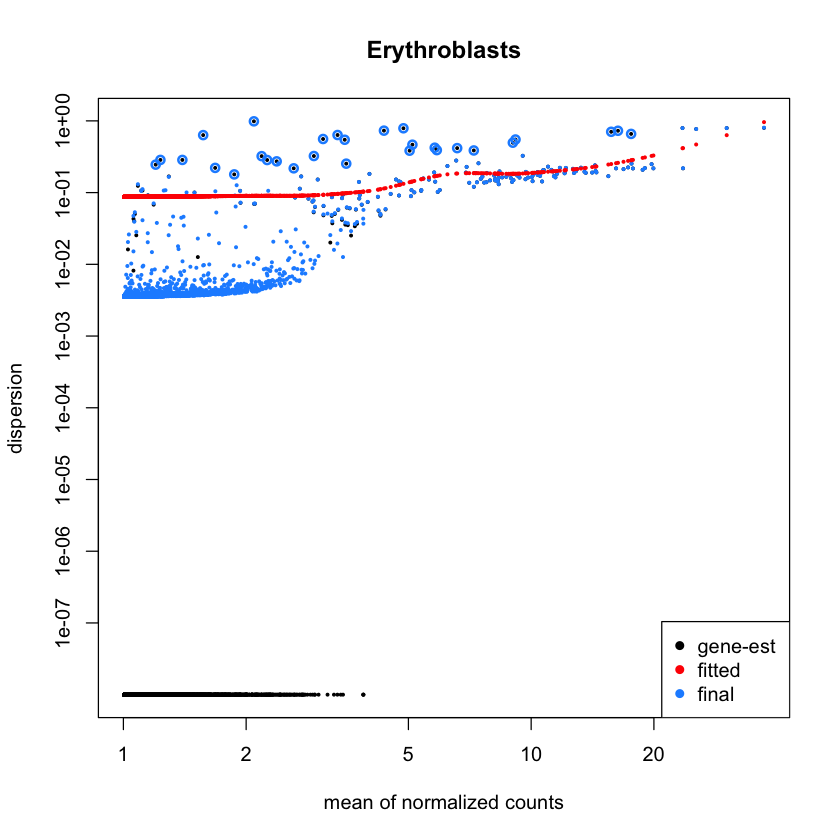

In [10]:
plotDispEsts(Erythroblasts, main = "Erythroblasts")

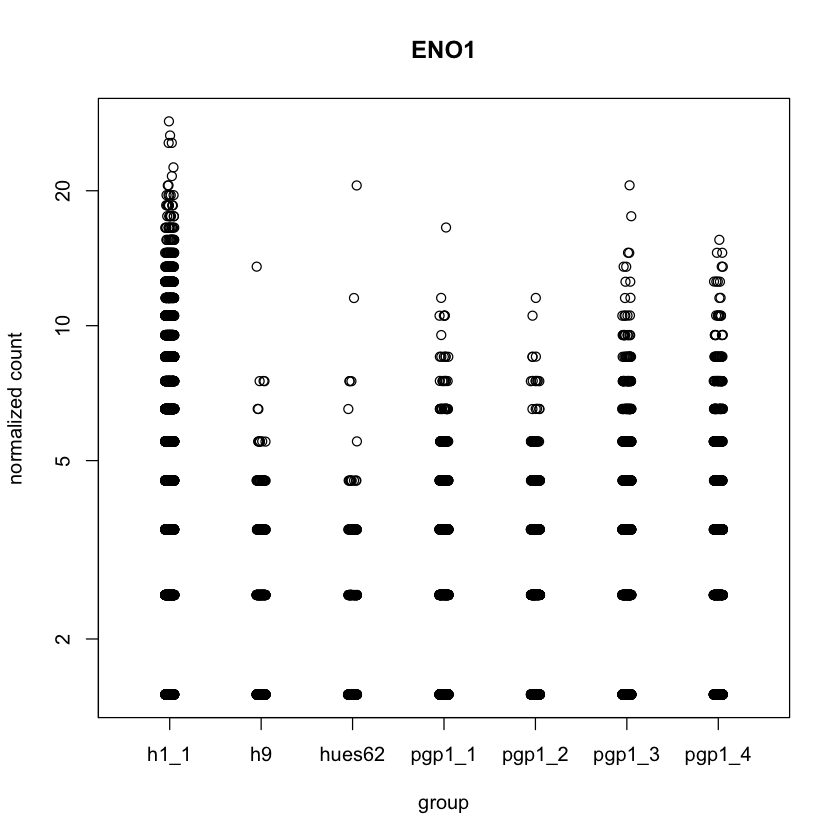

In [11]:
plotCounts(Erythroblasts, gene=which.min(res_erythroblast$padj), intgroup="orig.ident")

### iPS Cells

In [12]:
ips_cells <- readRDS(file = "iPS_cells_deseq.rds")
ips_cells

res_ips <- results(ips_cells)
saveRDS(res_ips, file = "res_ips.rds")
head(res_ips)

class: DESeqDataSet 
dim: 25072 1966 
metadata(1): version
assays(4): counts mu H cooks
rownames(25072): AL627309.1 AL669831.5 ... LINC02573 BX004987.1
rowData names(31): baseMean baseVar ... deviance maxCooks
colnames(1966): AAACGAACACGGTGTC-1_1 AAACGAACACTCACTC-1_1 ...
  TTTGATCCATCGCTAA-1_7 TTTGGTTTCTCGTCGT-1_7
colData names(11): orig.ident nCount_RNA ... cluster_id sizeFactor

log2 fold change (MLE): orig.ident pgp1 4 vs h1 1 
LRT p-value: '~ orig.ident' vs '~ 1' 
DataFrame with 6 rows and 6 columns
            baseMean log2FoldChange     lfcSE        stat    pvalue      padj
           <numeric>      <numeric> <numeric>   <numeric> <numeric> <numeric>
AL627309.1   1.00237    1.55710e-04  0.123110 2.44825e-05  1.000000        NA
AL669831.5   1.01512   -4.04228e-03  0.122190 4.87285e-02  0.999998        NA
FAM87B       1.00339   -3.39335e-03  0.123059 5.87165e-03  1.000000        NA
LINC00115    1.00441   -8.00287e-05  0.122817 9.97590e-03  1.000000        NA
FAM41C       1.00594   -1.04654e-02  0.122958 3.37119e-02  0.999999        NA
AL645608.7   1.00237    1.55710e-04  0.123110 2.44825e-05  1.000000        NA

In [13]:
#Up and Down regulated genes
cat("Up-regulated Genes:")
row.names(res_ips)[which(!is.na(res_ips$log2FoldChange) & res_ips$log2FoldChange > 1.0 & res_ips$padj < 0.05)] 
cat("Down-regulated Genes:")
row.names(res_ips)[which(!is.na(res_ips$log2FoldChange) & res_ips$log2FoldChange < -1.0 & res_ips$pvalue < 0.05)]
#write.table(x, file, append = FALSE, sep = " ", dec = ".", row.names = TRUE, col.names = TRUE)

Up-regulated Genes:

[1] "COL3A1"   "COL5A2"   "FN1"      "SPARC"    "COL1A2"   "PTN"     
 [7] "ITM2A"    "GPC3"     "COL5A1"   "KCNQ1OT1" "MGP"      "LUM"     
[13] "DCN"      "POSTN"    "COL1A1"   "TTR"      "RRBP1"    "ID1"     
[19] "JUNB"     "FOSB"     "TIMP3"    "LGALS1"   "COL6A1"   "COL6A2"

Down-regulated Genes:

[1] "ENO1"   "STMN1"  "HMGN2"  "NDUFS5" "UQCRH"  "HSPD1"  "HSPE1"  "IGFBP2"
 [9] "PTMA"   "RPL29"  "HINT1"  "NPM1"   "PRL"    "HMGA1"  "CHCHD2" "TMSB4X"
[17] "RPL7A"  "LDHA"   "PPA1"   "PGAM1"  "GAPDH"  "LDHB"   "RPS26"  "TAC3"  
[25] "PEBP1"  "RAN"    "SIX6"   "CKB"    "SRP14"  "C1QBP"  "JPT1"   "NNAT"  
[33] "RPS4Y1" "RANBP1"

In [14]:
ntd_ips <- normTransform(ips_cells)
vsd_ips <- varianceStabilizingTransformation(ips_cells)

-- note: fitType='parametric', but the dispersion trend was not well captured by the
   function: y = a/x + b, and a local regression fit was automatically substituted.
   specify fitType='local' or 'mean' to avoid this message next time.



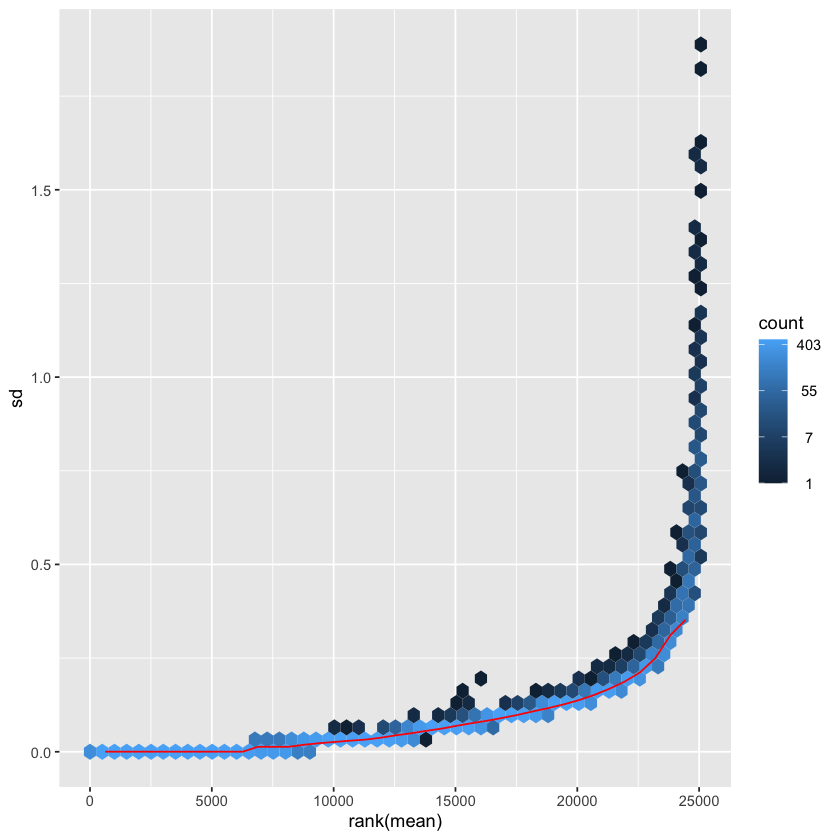

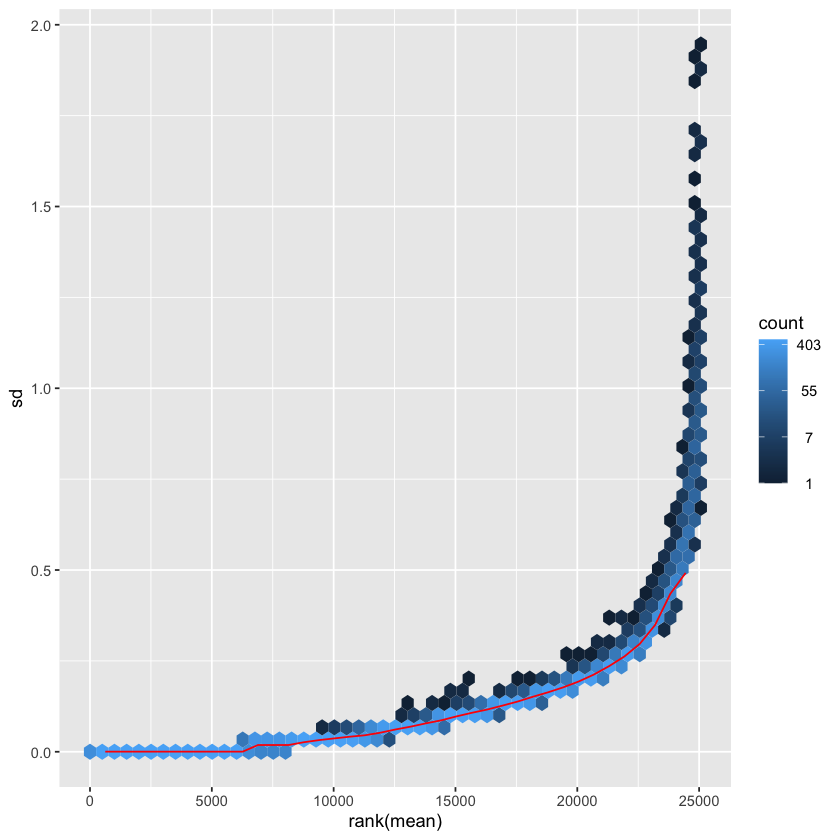

In [15]:
options(repr.plot.width = 7, repr.plot.height = 7)
meanSdPlot(assay(ntd_ips))
meanSdPlot(assay(vsd_ips))

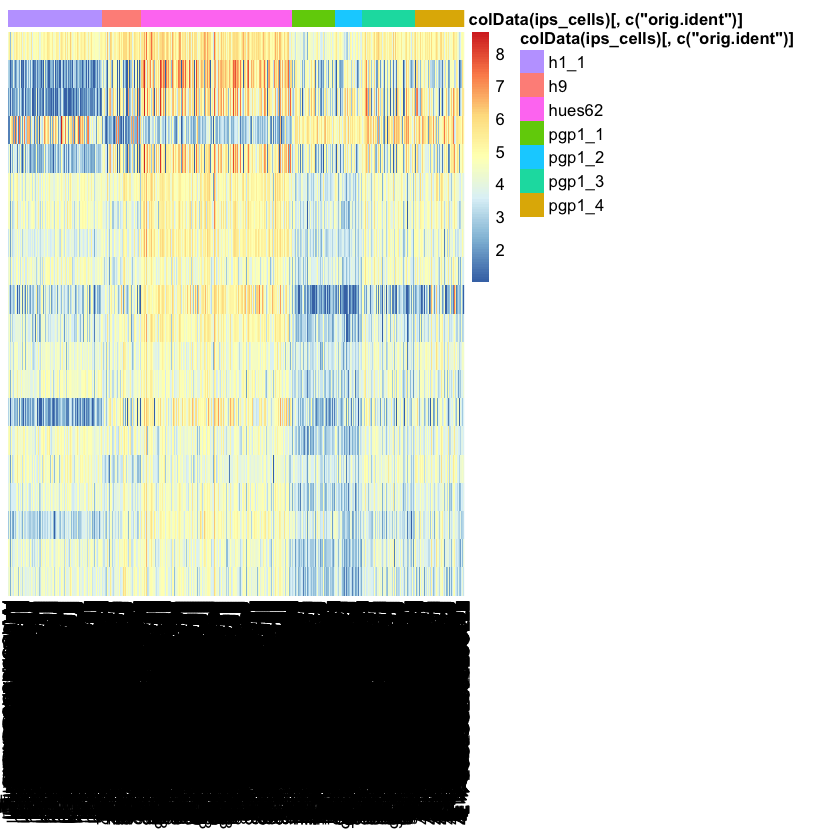

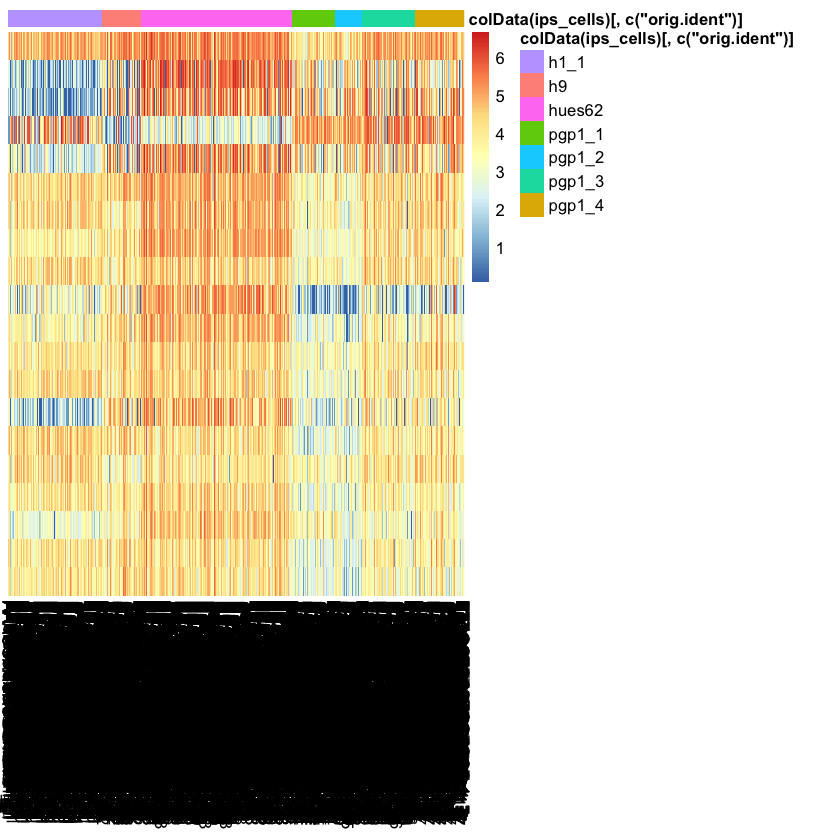

In [16]:
select_6 <- order(rowMeans(counts(ips_cells,normalized=TRUE)), decreasing=TRUE)[1:20]
df_6 <- as.data.frame(colData(ips_cells)[,c("orig.ident")])
row.names(df_6) <- colnames(ntd_ips)

pheatmap(assay(ntd_ips)[select_6,], cluster_rows=FALSE, show_rownames=FALSE,
         cluster_cols=FALSE, annotation_col=df_6)

pheatmap(assay(vsd_ips)[select_6,], cluster_rows=FALSE, show_rownames=FALSE,
         cluster_cols=FALSE, annotation_col=df_6)

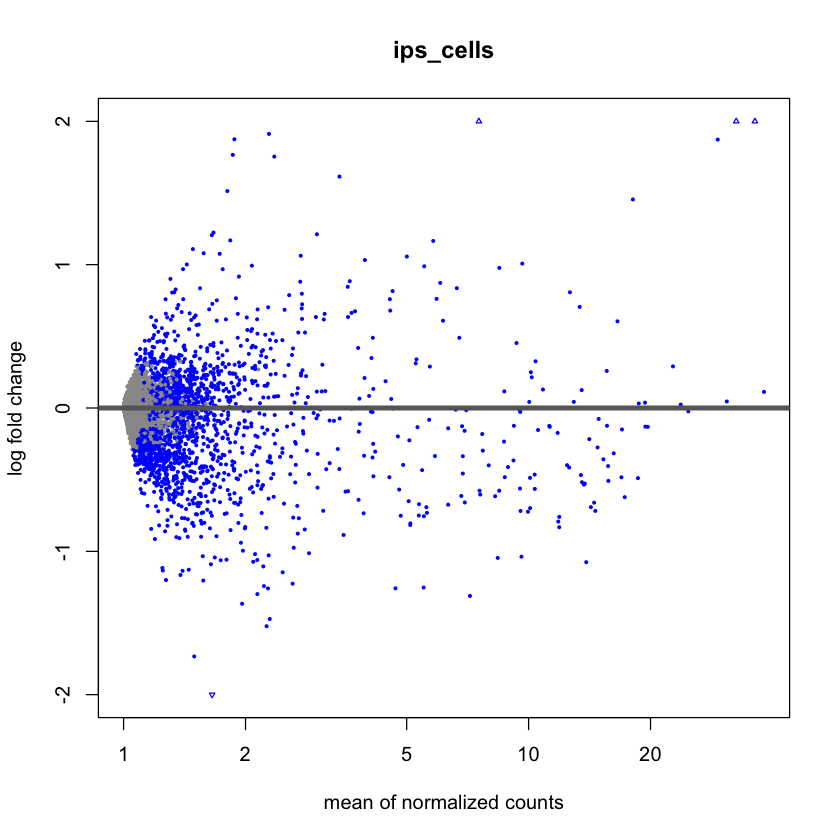

In [17]:
plotMA(ips_cells, ylim = c(-2,2), main = "ips_cells")

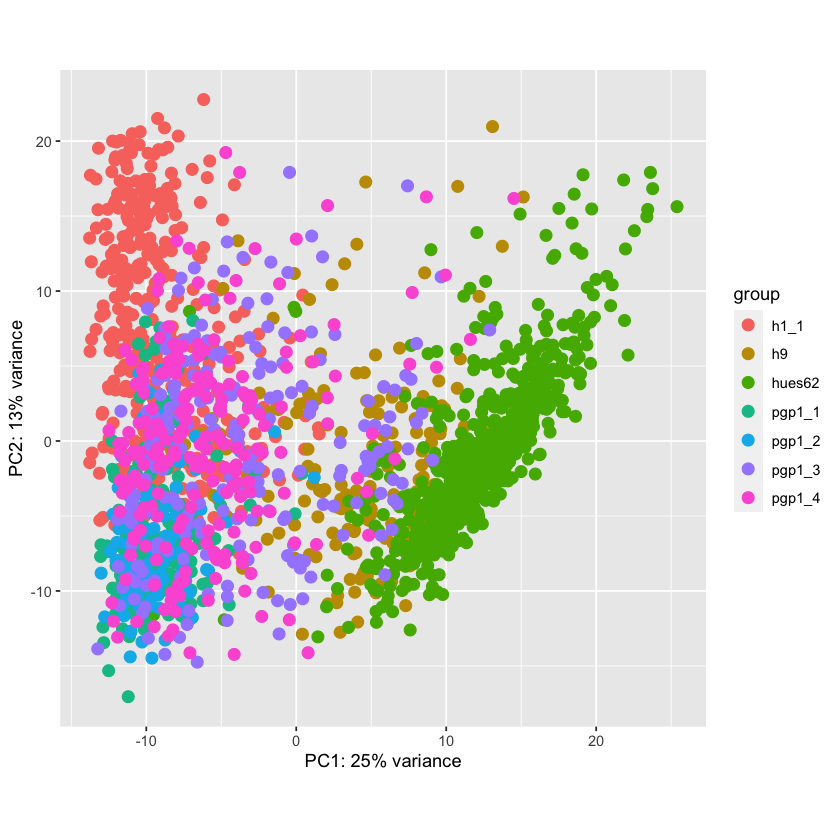

In [19]:
plotPCA(vsd_ips, intgroup=c("orig.ident"))

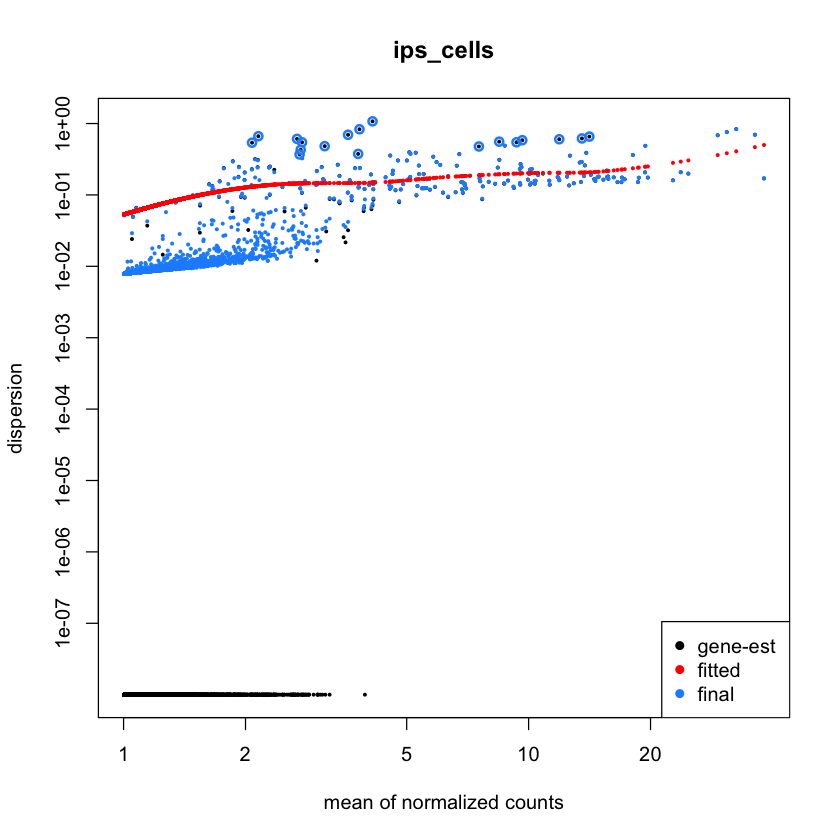

In [20]:
plotDispEsts(ips_cells, main = "ips_cells")

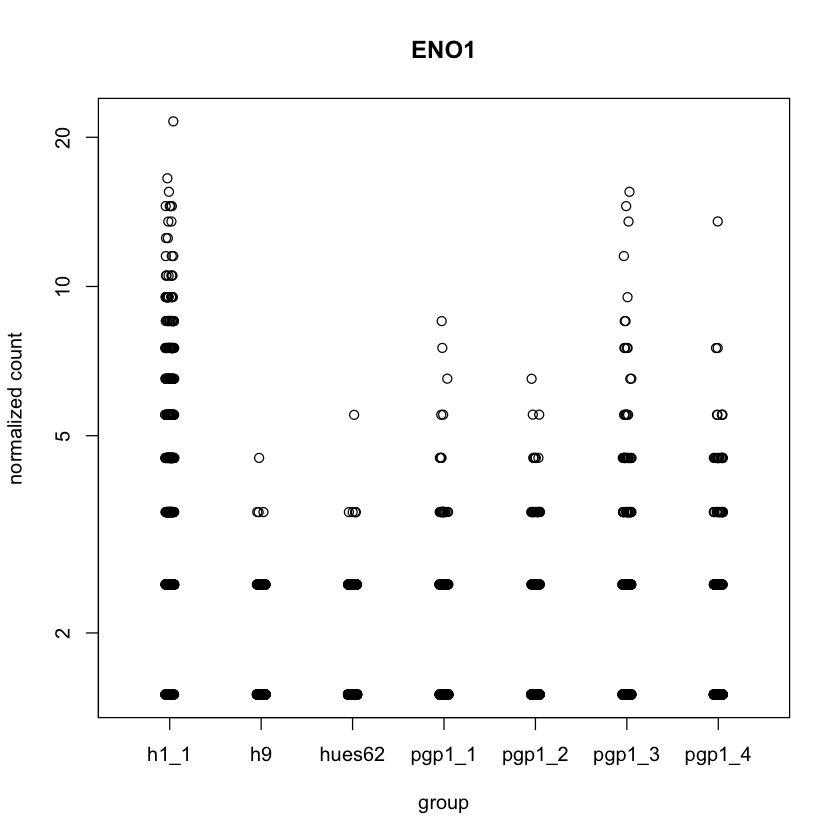

In [21]:
plotCounts(ips_cells, gene=which.min(res_erythroblast$padj), intgroup="orig.ident")

### Neuroepithelial cells

In [24]:
Neuroepithelial_cells <- readRDS(file = "Neuroepithelial_cell_deseq.rds")
Neuroepithelial_cells

res_neuroepithelial <- results(Neuroepithelial_cells)
saveRDS(res_neuroepithelial, file = "res_neuroepithelial.rds")
head(res_neuroepithelial)

class: DESeqDataSet 
dim: 25072 2256 
metadata(1): version
assays(4): counts mu H cooks
rownames(25072): AL627309.1 AL669831.5 ... LINC02573 BX004987.1
rowData names(31): baseMean baseVar ... deviance maxCooks
colnames(2256): AAACGAACATGAATAG-1_1 AAACGCTCAGACAAGC-1_1 ...
  TTTGGAGGTGGCCACT-1_7 TTTGTTGTCATTTGCT-1_7
colData names(11): orig.ident nCount_RNA ... cluster_id sizeFactor

log2 fold change (MLE): orig.ident pgp1 4 vs h1 1 
LRT p-value: '~ orig.ident' vs '~ 1' 
DataFrame with 6 rows and 6 columns
            baseMean log2FoldChange     lfcSE        stat    pvalue      padj
           <numeric>      <numeric> <numeric>   <numeric> <numeric> <numeric>
AL627309.1   1.00420    0.000653245 0.0905544 0.004215541  1.000000        NA
AL669831.5   1.01621    0.015033499 0.0899156 0.057967461  0.999996        NA
FAM87B       1.00375    0.000653245 0.0905543 0.000126557  1.000000        NA
LINC00115    1.01131   -0.008676600 0.0902332 0.079804805  0.999990        NA
FAM41C       1.01087   -0.016830352 0.0902123 0.089028727  0.999986        NA
AL645608.7   1.00420    0.003706585 0.0905029 0.002076018  1.000000        NA

In [25]:
#Up and Down regulated genes
cat("Up-regulated Genes:")
row.names(res_neuroepithelial)[which(!is.na(res_neuroepithelial$log2FoldChange) & res_neuroepithelial$log2FoldChange > 1.0 & res_neuroepithelial$padj < 0.05)] 
cat("Down-regulated Genes:")
row.names(res_neuroepithelial)[which(!is.na(res_neuroepithelial$log2FoldChange) & res_neuroepithelial$log2FoldChange < -1.0 & res_neuroepithelial$pvalue < 0.05)]
#write.table(x, file, append = FALSE, sep = " ", dec = ".", row.names = TRUE, col.names = TRUE)

Up-regulated Genes:

[1] "C1orf61" "COL3A1"  "PTN"     "COL1A1"  "ID1"

Down-regulated Genes:

[1] "RPL11"   "UQCRH"   "RPS7"    "CALM2"   "RPS27A"  "DAPL1"   "ATP5MC3"
 [8] "HSPD1"   "HSPE1"   "PTMA"    "RPL32"   "RPL14"   "RPL29"   "RPL24"  
[15] "RPL22L1" "H2AFZ"   "TBCA"    "RPS23"   "NPM1"    "RPS18"   "CHCHD2" 
[22] "TMSB4X"  "RPL8"    "ANXA1"   "TXN"     "RPL12"   "RPL7A"   "LDHA"   
[29] "FTH1"    "NEAT1"   "GSTP1"   "RPS3"    "PPA1"    "RPS24"   "TUBA1C" 
[36] "RPL41"   "NACA"    "TAC3"    "PEBP1"   "RAN"     "RPL36AL" "DLK1"   
[43] "CKB"     "RPS2"    "NDUFAB1" "C1QBP"   "RPL26"   "RPL19"   "RPS19"  
[50] "RPL18"   "FTL"     "RPS9"    "RPS4Y1"

In [26]:
ntd_neuroepithelial <- normTransform(Neuroepithelial_cells)
vsd_neuroepithelial <- varianceStabilizingTransformation(Neuroepithelial_cells)

-- note: fitType='parametric', but the dispersion trend was not well captured by the
   function: y = a/x + b, and a local regression fit was automatically substituted.
   specify fitType='local' or 'mean' to avoid this message next time.



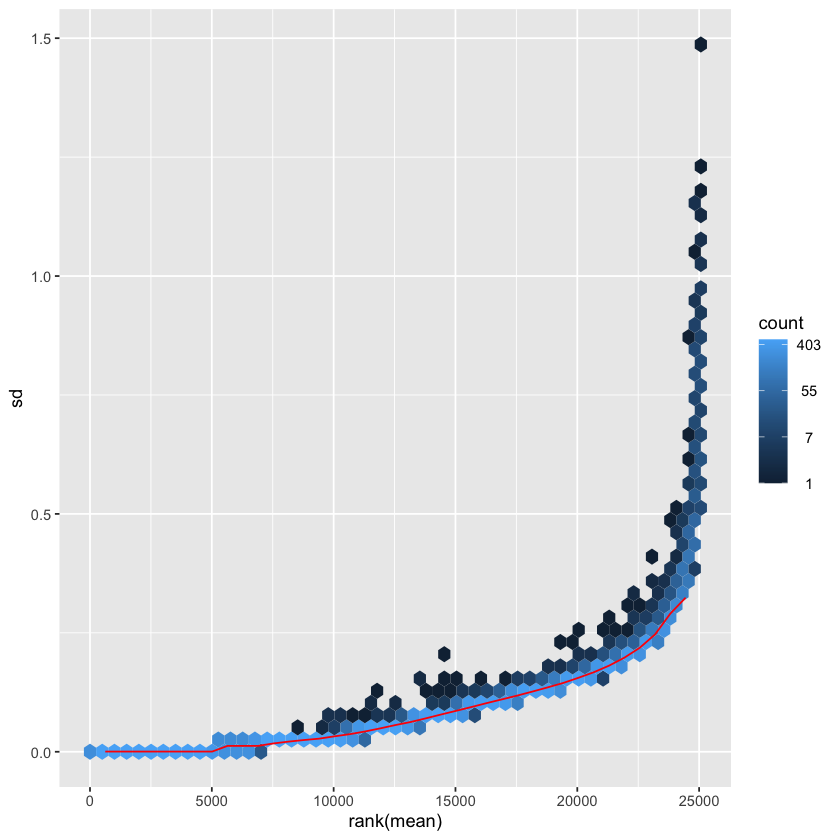

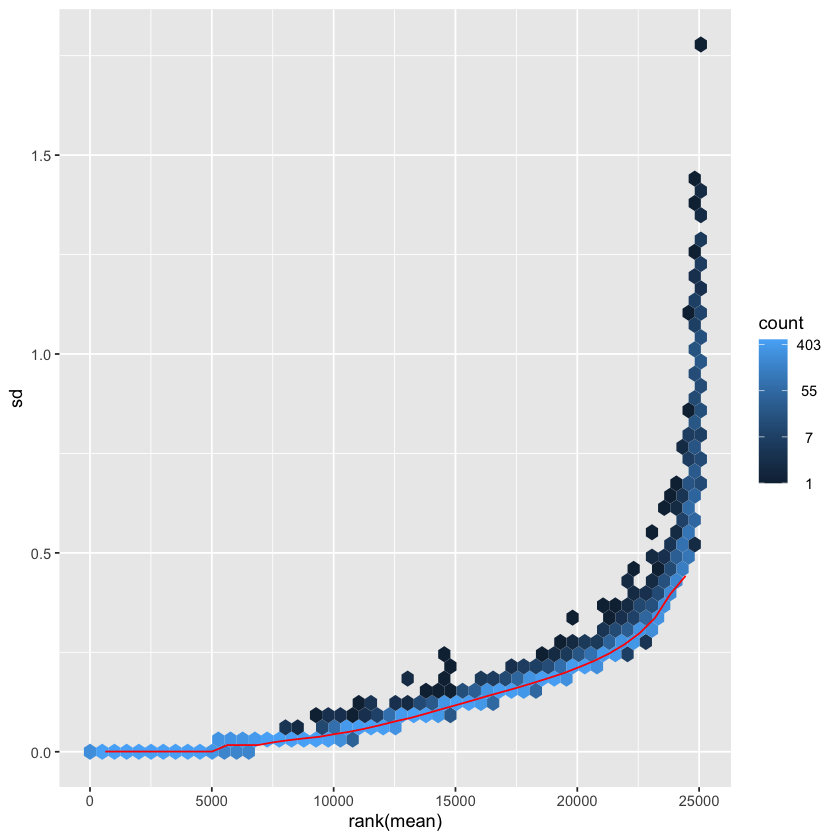

In [27]:
options(repr.plot.width = 7, repr.plot.height = 7)
meanSdPlot(assay(ntd_neuroepithelial))
meanSdPlot(assay(vsd_neuroepithelial))

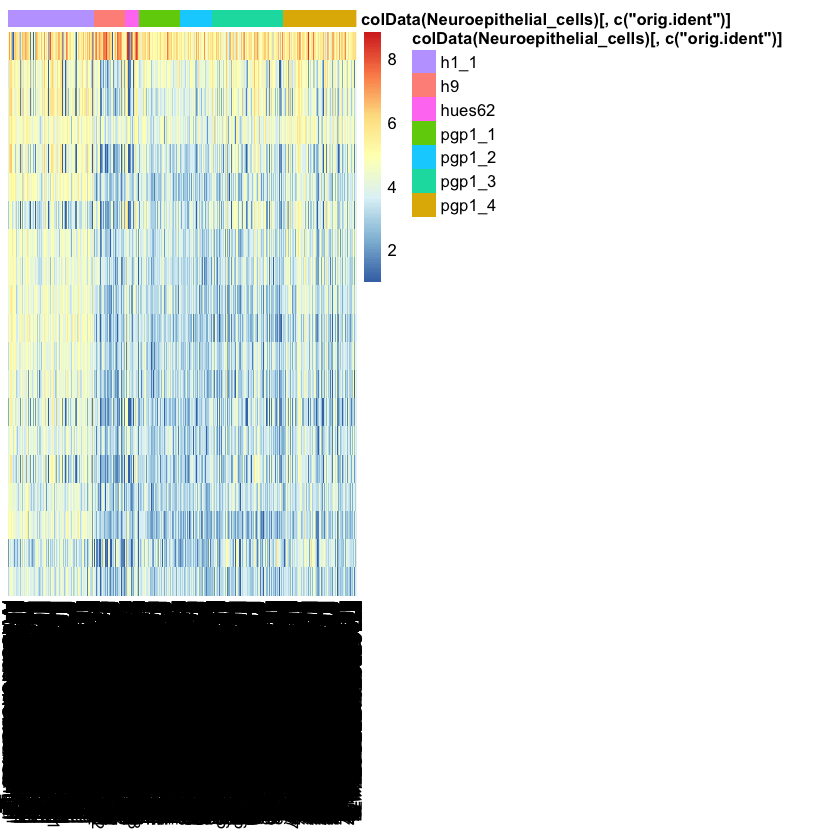

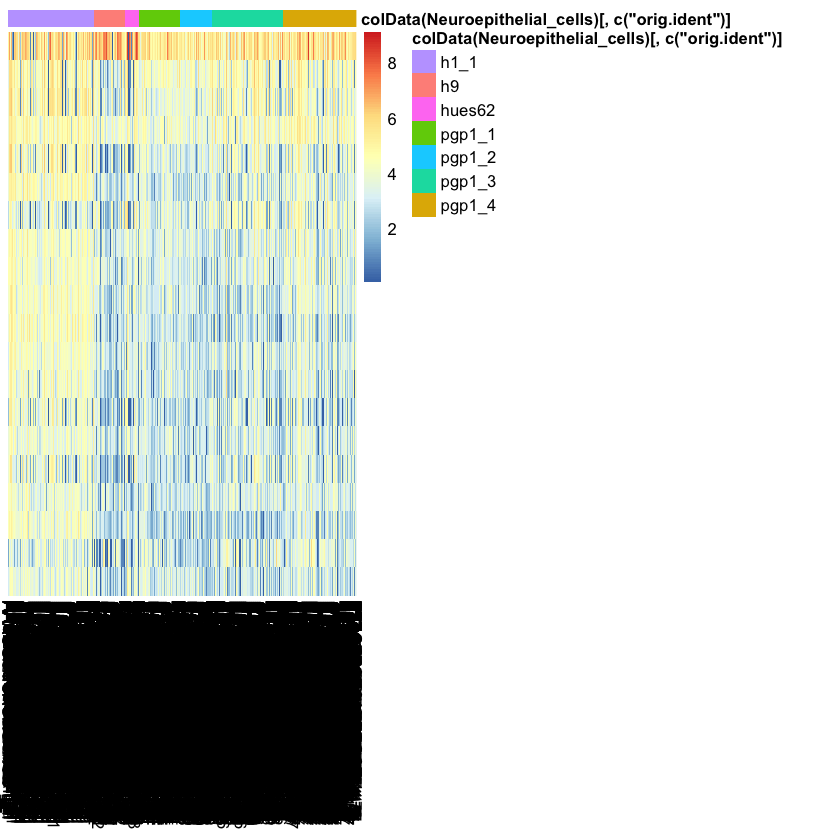

In [28]:
select_7 <- order(rowMeans(counts(Neuroepithelial_cells,normalized=TRUE)), decreasing=TRUE)[1:20]
df_7 <- as.data.frame(colData(Neuroepithelial_cells)[,c("orig.ident")])
row.names(df_7) <- colnames(ntd_neuroepithelial)

pheatmap(assay(ntd_neuroepithelial)[select_7,], cluster_rows=FALSE, show_rownames=FALSE,
         cluster_cols=FALSE, annotation_col=df_7)

pheatmap(assay(vsd_neuroepithelial)[select_7,], cluster_rows=FALSE, show_rownames=FALSE,
         cluster_cols=FALSE, annotation_col=df_7)

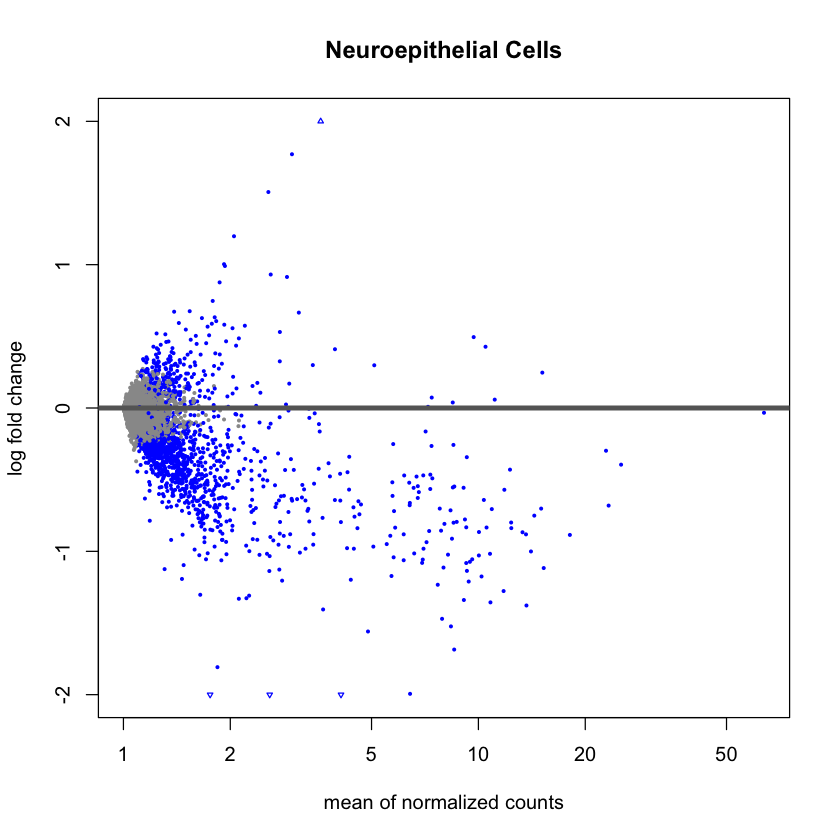

In [29]:
plotMA(res_neuroepithelial, ylim = c(-2,2), main = "Neuroepithelial Cells")

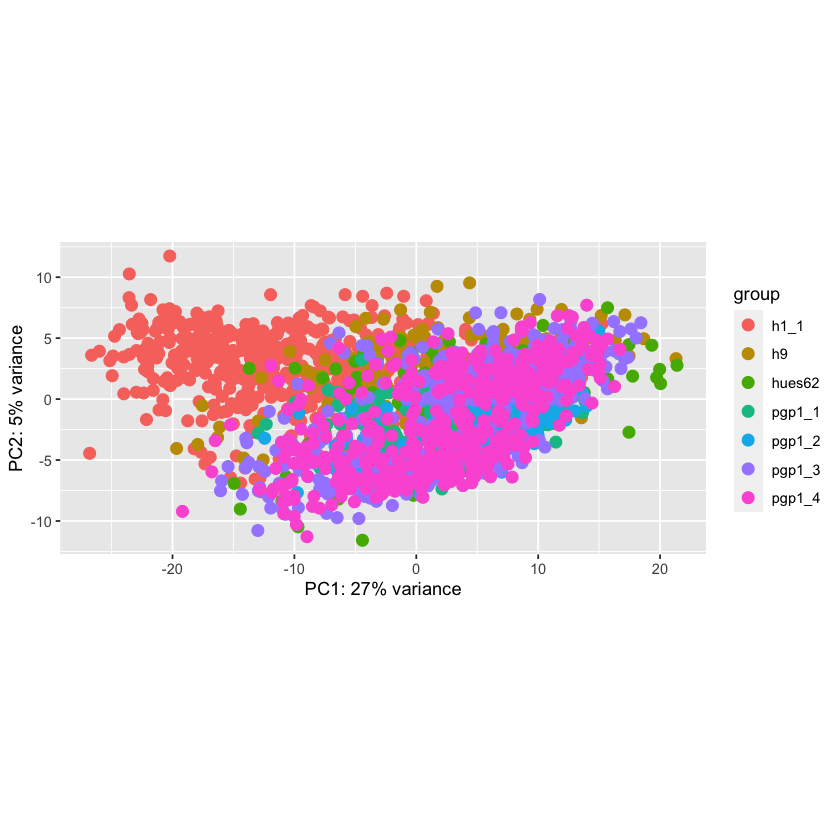

In [30]:
plotPCA(vsd_neuroepithelial, intgroup=c("orig.ident"))

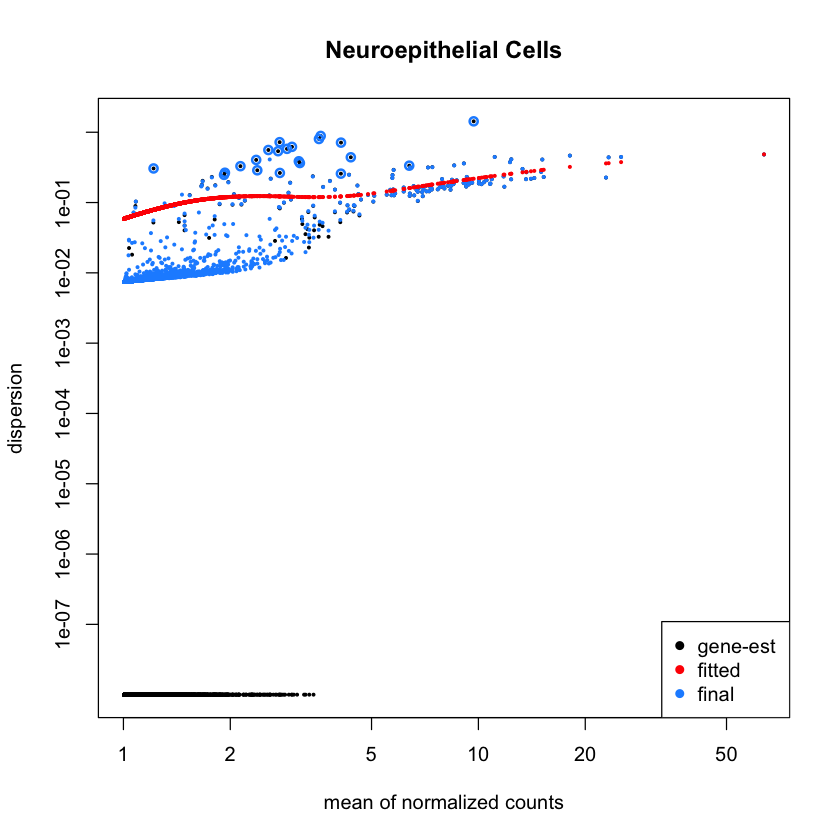

In [31]:
plotDispEsts(Neuroepithelial_cells, main = "Neuroepithelial Cells")

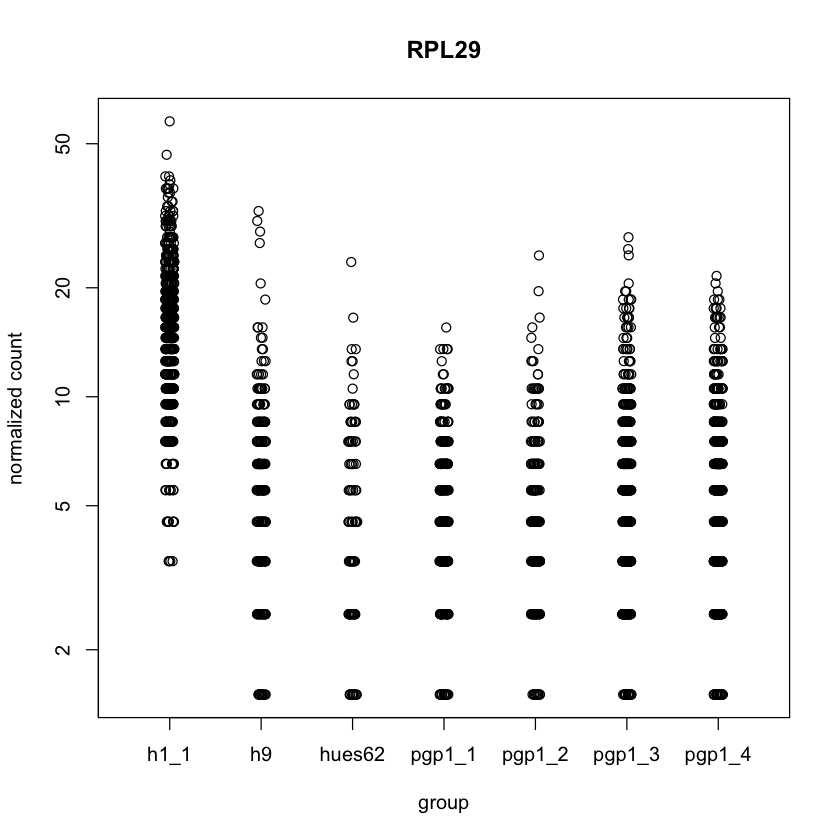

In [35]:
plotCounts(Neuroepithelial_cells, gene=which.min(res_neuroepithelial$padj), intgroup="orig.ident")

### Neurons

In [4]:
Neurons <- readRDS(file = "Neurons_deseq.rds")
Neurons

res_neurons <- results(Neurons)
saveRDS(res_neurons, file = "res_neurons.rds")
head(res_neurons)

class: DESeqDataSet 
dim: 25072 3110 
metadata(1): version
assays(4): counts mu H cooks
rownames(25072): AL627309.1 AL669831.5 ... LINC02573 BX004987.1
rowData names(31): baseMean baseVar ... deviance maxCooks
colnames(3110): AAACCCAAGCACCTGC-1_1 AAACGAAAGAATCGTA-1_1 ...
  TTTCGATTCCCTATTA-1_7 TTTGATCAGCCATTGT-1_7
colData names(11): orig.ident nCount_RNA ... cluster_id sizeFactor

log2 fold change (MLE): orig.ident pgp1 4 vs h1 1 
LRT p-value: '~ orig.ident' vs '~ 1' 
DataFrame with 6 rows and 6 columns
            baseMean log2FoldChange     lfcSE        stat    pvalue      padj
           <numeric>      <numeric> <numeric>   <numeric> <numeric> <numeric>
AL627309.1   1.00430    0.000275276  0.106382 0.012871030  1.000000        NA
AL669831.5   1.02397   -0.014922796  0.105669 0.687809771  0.994750        NA
FAM87B       1.00301    0.000275276  0.106382 0.000390591  1.000000        NA
LINC00115    1.00817   -0.003247785  0.106325 0.041790801  0.999999        NA
FAM41C       1.00946    0.005263705  0.106155 0.022862682  1.000000        NA
AL645608.7   1.00301    0.000275276  0.106382 0.000390591  1.000000        NA

In [5]:
#Up and Down regulated genes
cat("Up-regulated Genes:")
row.names(res_neurons)[which(!is.na(res_neurons$log2FoldChange) & res_neurons$log2FoldChange > 1.0 & res_neurons$padj < 0.05)] 
cat("Down-regulated Genes:")
row.names(res_neurons)[which(!is.na(res_neurons$log2FoldChange) & res_neurons$log2FoldChange < -1.0 & res_neurons$pvalue < 0.05)]
#write.table(x, file, append = FALSE, sep = " ", dec = ".", row.names = TRUE, col.names = TRUE)

Up-regulated Genes:

[1] "CNTN2"    "COL3A1"   "GAP43"    "STMN2"    "KCNQ1OT1" "CRABP1"   "COL1A1"  
[8] "ELAVL3"

Down-regulated Genes:

[1] "RPL11"    "HMGN2"    "UQCRH"    "RPL5"     "RPS7"     "RPS27A"  
 [7] "IGFBP2"   "RPL32"    "RPL15"    "RPL14"    "RPL29"    "RPL24"   
[13] "RBP1"     "RPL35A"   "RPS3A"    "BTF3"     "RPS23"    "RPS14"   
[19] "NPM1"     "RACK1"    "RPS18"    "RPL10A"   "RPS12"    "CHCHD2"  
[25] "DLX6-AS1" "DLX5"     "TMSB4X"   "RPS4X"    "RPL8"     "RPL12"   
[31] "RPL7A"    "RPS13"    "MDK"      "GSTP1"    "RPS3"     "RPS24"   
[37] "LDHB"     "RPL41"    "NACA"     "TAC3"     "RPL6"     "SIX6"    
[43] "DLK1"     "NDN"      "RPLP1"    "RPS2"     "RPS15A"   "RPL13"   
[49] "RPL26"    "RPL23A"   "RPL19"    "NNAT"     "GNAS"     "RPL36"   
[55] "RPS19"    "RPL18"    "FTL"      "RPS9"     "RPL28"    "RPS5"    
[61] "RPS4Y1"   "RPL3"

In [6]:
ntd_neurons <- normTransform(Neurons)
vsd_neurons <- varianceStabilizingTransformation(Neurons)

-- note: fitType='parametric', but the dispersion trend was not well captured by the
   function: y = a/x + b, and a local regression fit was automatically substituted.
   specify fitType='local' or 'mean' to avoid this message next time.



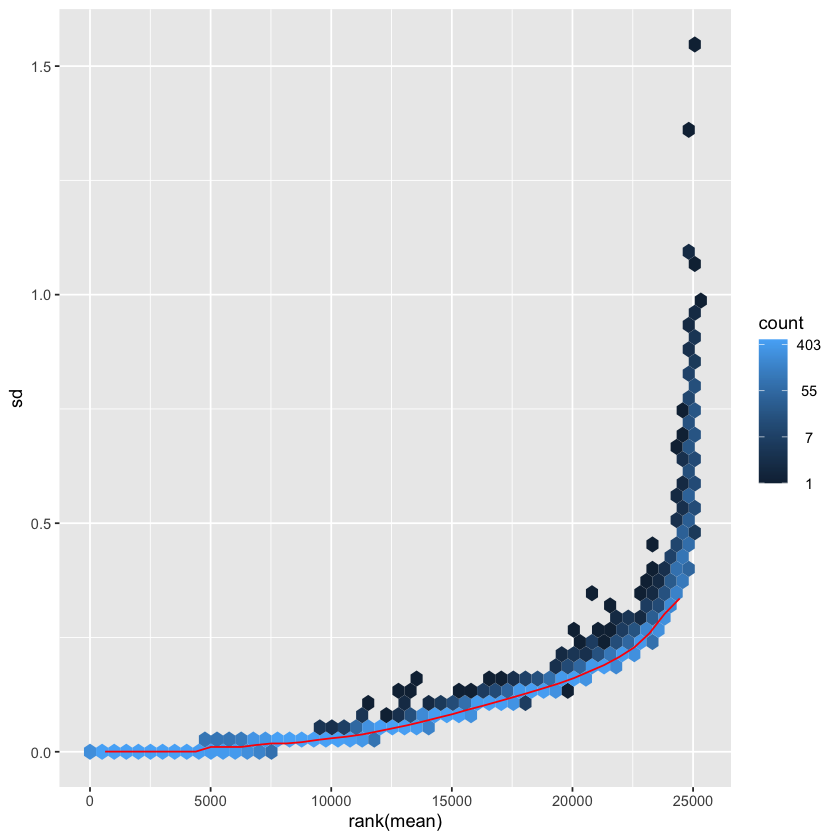

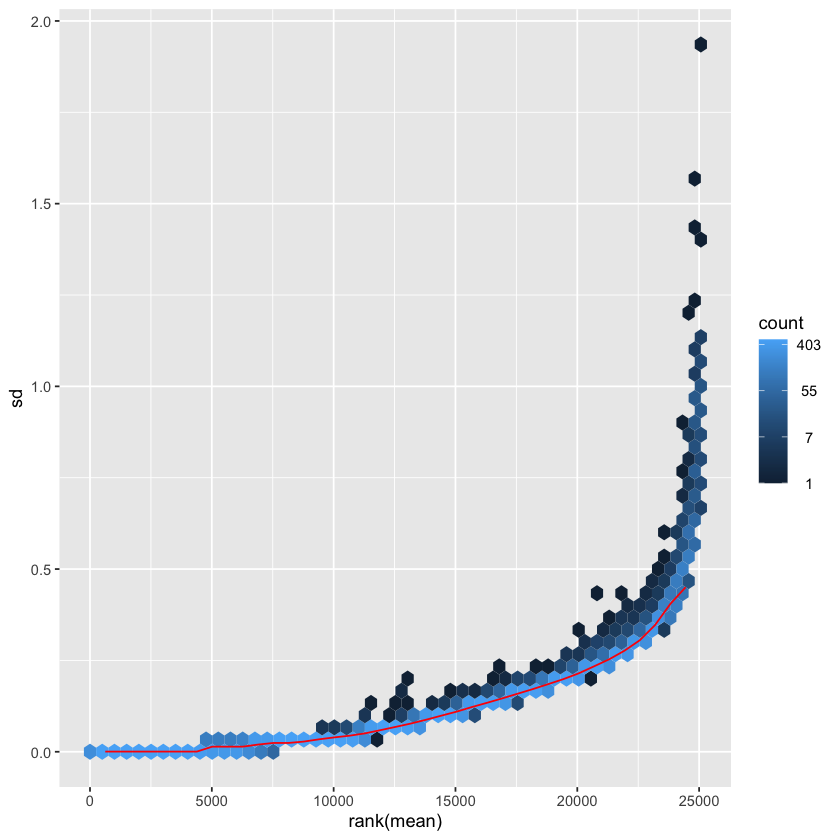

In [7]:
options(repr.plot.width = 7, repr.plot.height = 7)
meanSdPlot(assay(ntd_neurons))
meanSdPlot(assay(vsd_neurons))

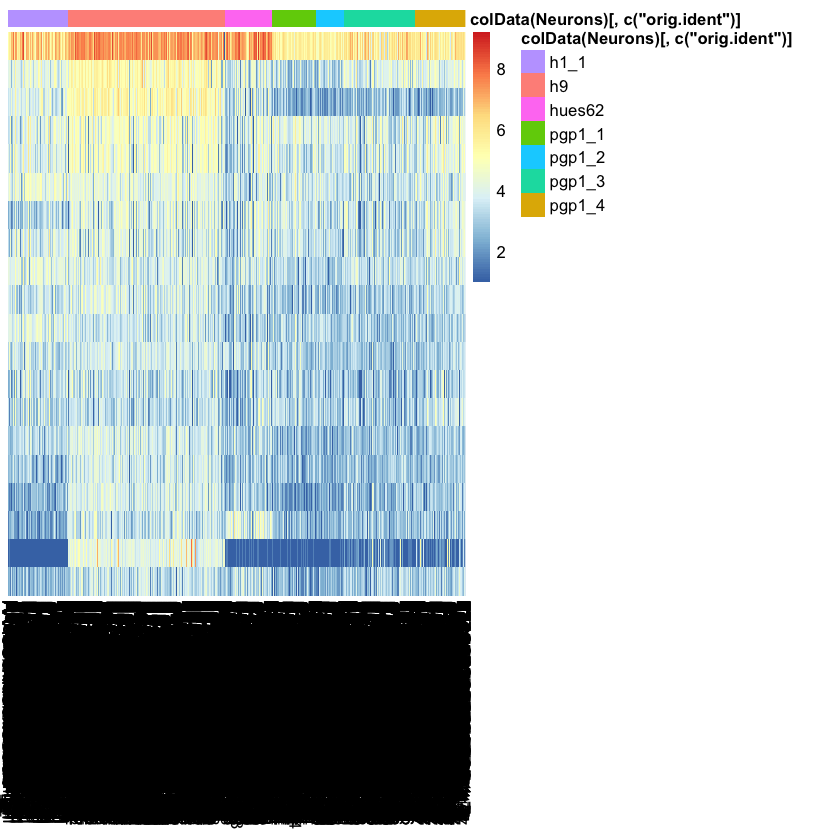

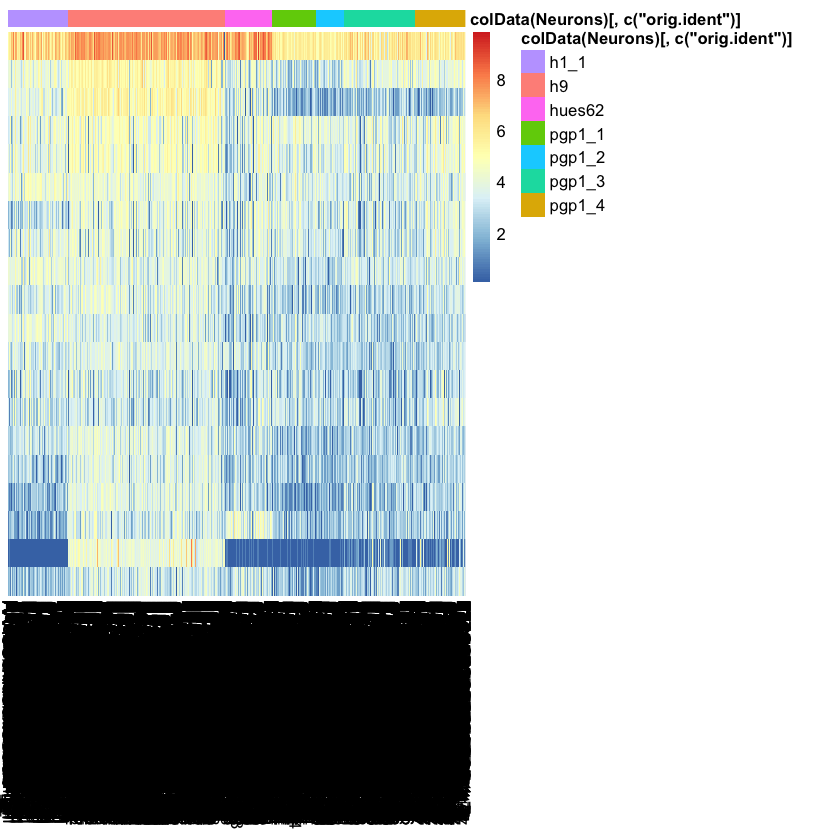

In [8]:
select_8 <- order(rowMeans(counts(Neurons,normalized=TRUE)), decreasing=TRUE)[1:20]
df_8 <- as.data.frame(colData(Neurons)[,c("orig.ident")])
row.names(df_8) <- colnames(ntd_neurons)

pheatmap(assay(ntd_neurons)[select_8,], cluster_rows=FALSE, show_rownames=FALSE,
         cluster_cols=FALSE, annotation_col=df_8)

pheatmap(assay(vsd_neurons)[select_8,], cluster_rows=FALSE, show_rownames=FALSE,
         cluster_cols=FALSE, annotation_col=df_8)

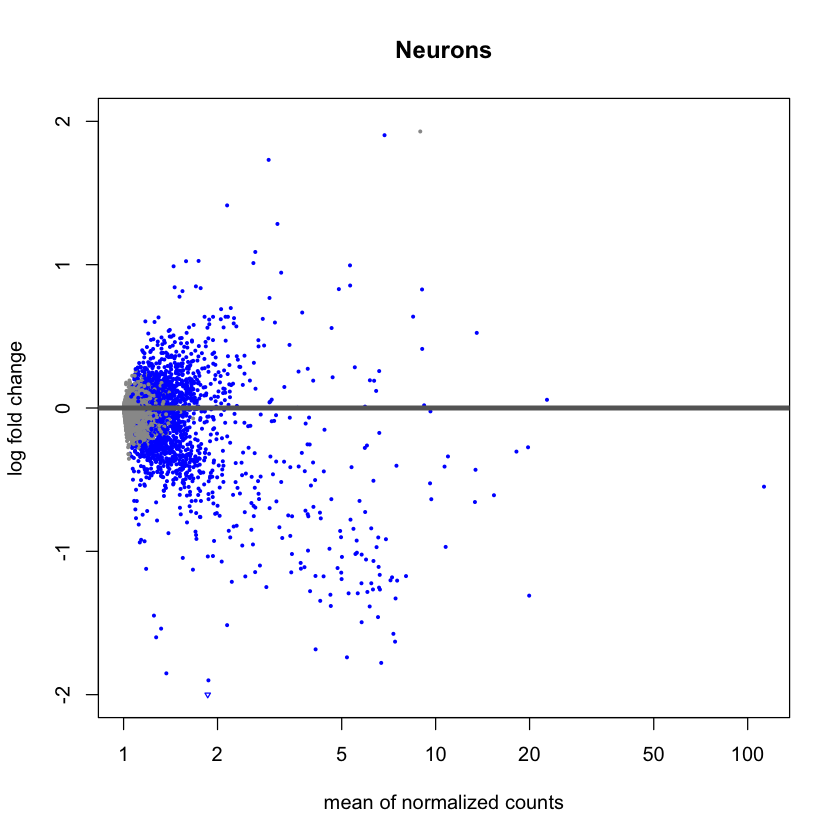

In [9]:
plotMA(res_neurons, ylim = c(-2,2), main = "Neurons")

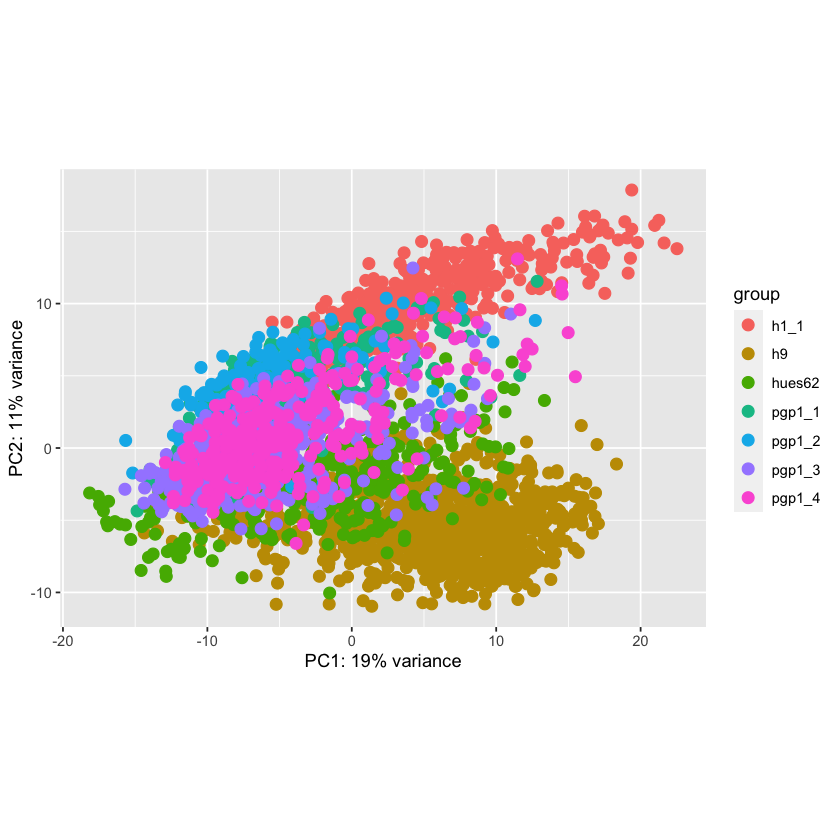

In [10]:
plotPCA(vsd_neurons, intgroup=c("orig.ident"))

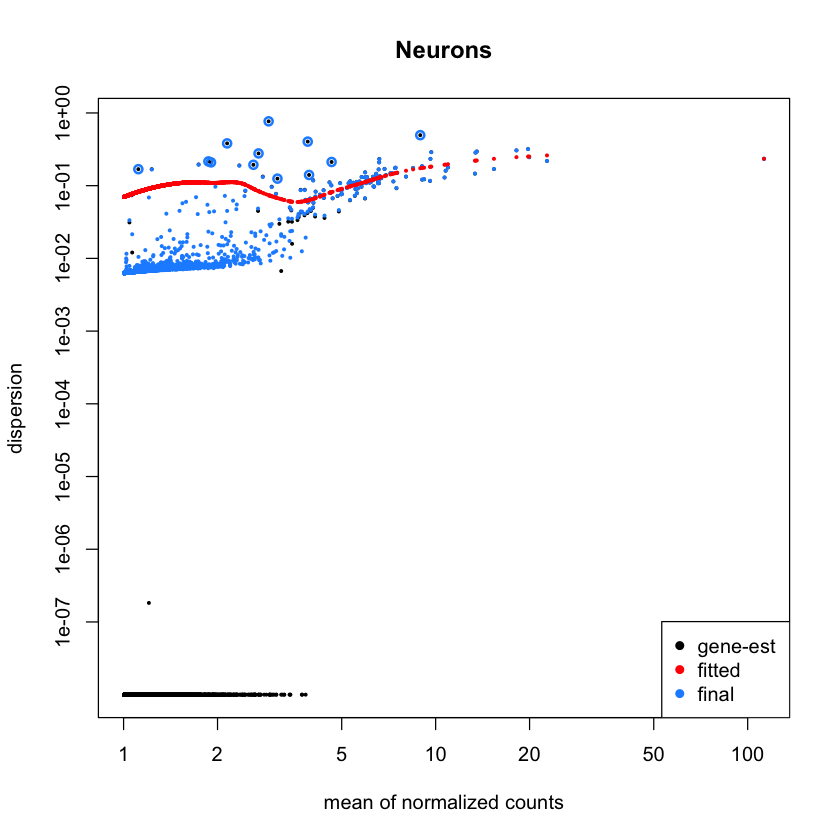

In [11]:
plotDispEsts(Neurons, main = "Neurons")

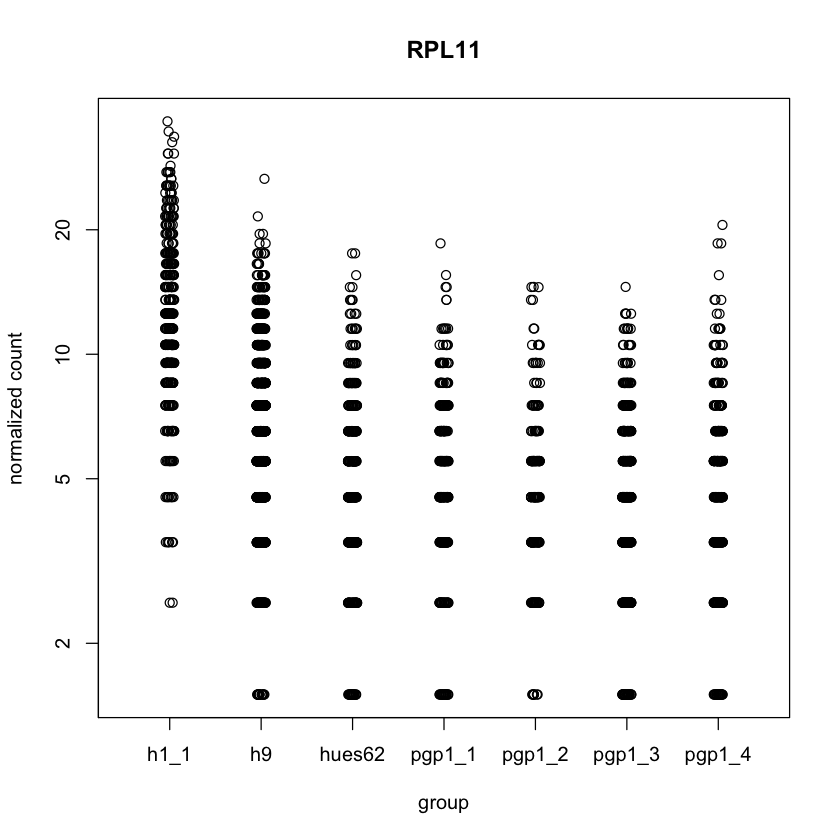

In [12]:
plotCounts(Neurons, gene=which.min(res_neurons$padj), intgroup="orig.ident")

### T cells

In [13]:
T_cells <- readRDS(file = "T_cell_deseq.rds")
T_cells

res_t <- results(T_cells)
saveRDS(res_t, file = "res_t.rds")
head(res_t)

class: DESeqDataSet 
dim: 25072 2270 
metadata(1): version
assays(4): counts mu H cooks
rownames(25072): AL627309.1 AL669831.5 ... LINC02573 BX004987.1
rowData names(31): baseMean baseVar ... deviance maxCooks
colnames(2270): AAACGAACAGCTTCGG-1_1 AAACGCTAGACTGAGC-1_1 ...
  TTTCAGTGTGGCATCC-1_7 TTTGTTGAGATGCAGC-1_7
colData names(11): orig.ident nCount_RNA ... cluster_id sizeFactor

log2 fold change (MLE): orig.ident pgp1 4 vs h1 1 
LRT p-value: '~ orig.ident' vs '~ 1' 
DataFrame with 6 rows and 6 columns
            baseMean log2FoldChange     lfcSE        stat    pvalue      padj
           <numeric>      <numeric> <numeric>   <numeric> <numeric> <numeric>
AL627309.1   1.00406   -0.003088654 0.0945732 0.002065494  1.000000        NA
AL669831.5   1.01820   -0.006836907 0.0941209 0.108173231  0.999975        NA
FAM87B       1.00362   -0.001235473 0.0945914 0.000330897  1.000000        NA
LINC00115    1.00936    0.000505036 0.0941925 0.031255914  0.999999        NA
FAM41C       1.00892   -0.008031628 0.0943858 0.035295767  0.999999        NA
AL645608.7   1.00362   -0.001235478 0.0945914 0.000330900  1.000000        NA

In [14]:
#Up and Down regulated genes
cat("Up-regulated Genes:")
row.names(res_t)[which(!is.na(res_t$log2FoldChange) & res_t$log2FoldChange > 1.0 & res_t$padj < 0.05)] 
cat("Down-regulated Genes:")
row.names(res_t)[which(!is.na(res_t$log2FoldChange) & res_t$log2FoldChange < -1.0 & res_t$pvalue < 0.05)]
#write.table(x, file, append = FALSE, sep = " ", dec = ".", row.names = TRUE, col.names = TRUE)

Up-regulated Genes:

[1] "ID3"      "JUN"      "COL3A1"   "SPARC"    "HIST1H4C" "MARCKS"  
 [7] "COL1A2"   "PTN"      "KCNQ1OT1" "LUM"      "DCN"      "FOS"     
[13] "COL1A1"   "TTR"      "ID1"      "FOSB"     "LGALS1"

Down-regulated Genes:

[1] "ENO1"     "SRM"      "RPL11"    "NDUFS5"   "YBX1"     "PRDX1"   
 [7] "UQCRH"    "TOMM20"   "RPS7"     "ODC1"     "RPS27A"   "SNRPG"   
[13] "ATP5MC3"  "HSPD1"    "HSPE1"    "PTMA"     "RPL14"    "RPL29"   
[19] "RPL22L1"  "H2AFZ"    "BTF3"     "RPS23"    "HINT1"    "NPM1"    
[25] "RPS18"    "HMGA1"    "HSP90AB1" "CHCHD2"   "DLX5"     "TMSB4X"  
[31] "FABP5"    "RPL12"    "RPL7A"    "LDHA"     "GSTP1"    "RPS3"    
[37] "PPA1"     "PGAM1"    "RPS26"    "TAC3"     "PEBP1"    "RAN"     
[43] "RPL36AL"  "SIX6"     "DLK1"     "SRP14"    "COX5A"    "NDUFB10" 
[49] "NDUFAB1"  "GCSH"     "APRT"     "C1QBP"    "EIF5A"    "RPL26"   
[55] "LHX1"     "RPL19"    "NME1"     "SNRPD1"   "NNAT"     "TIMM13"  
[61] "PDCD5"    "RPS4Y1"   "RANBP1"   "MT-CO2"   "MT-CYB"

In [15]:
ntd_t <- normTransform(T_cells)
vsd_t <- varianceStabilizingTransformation(T_cells)

-- note: fitType='parametric', but the dispersion trend was not well captured by the
   function: y = a/x + b, and a local regression fit was automatically substituted.
   specify fitType='local' or 'mean' to avoid this message next time.



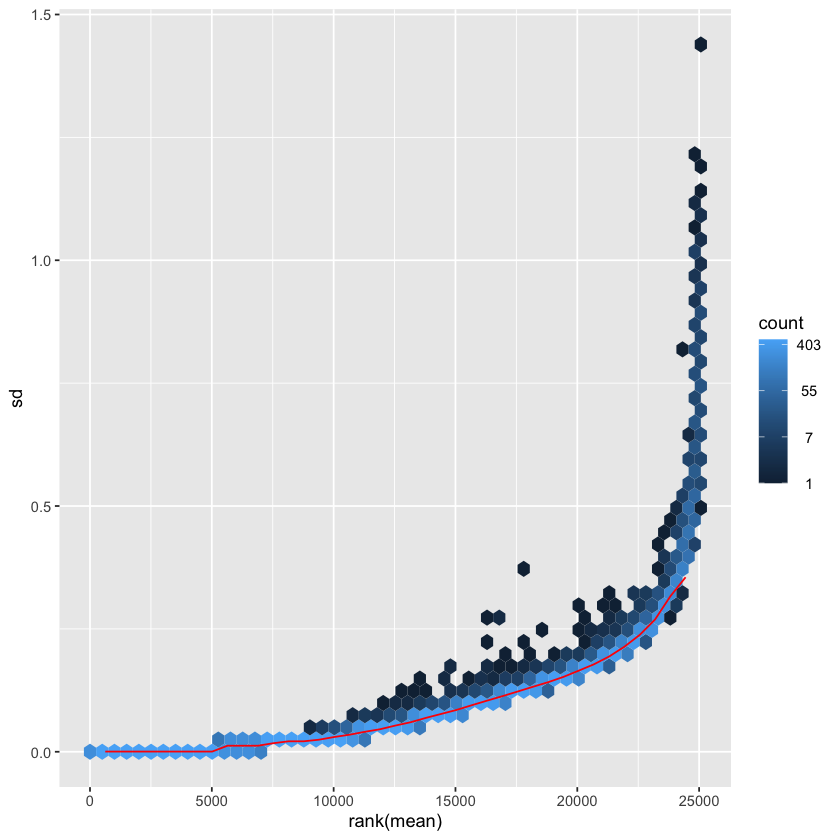

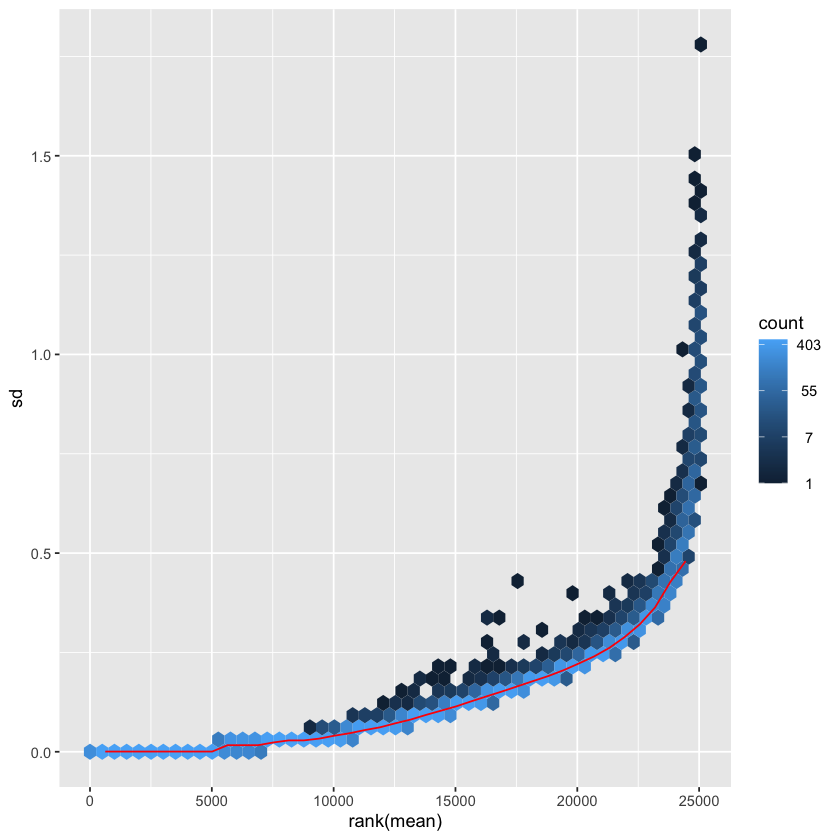

In [16]:
options(repr.plot.width = 7, repr.plot.height = 7)
meanSdPlot(assay(ntd_t))
meanSdPlot(assay(vsd_t))

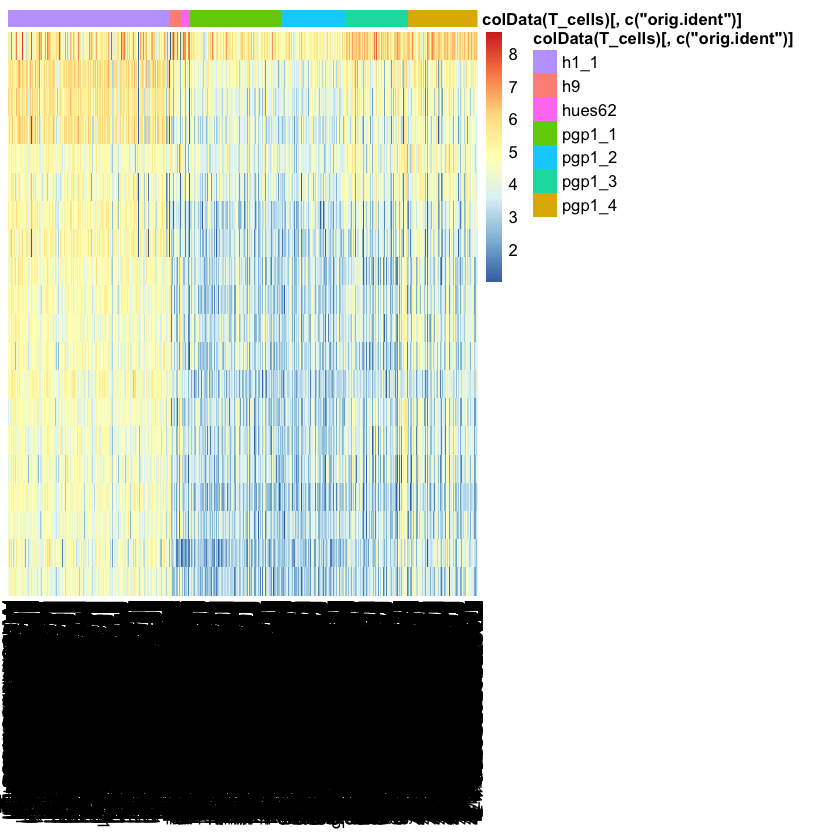

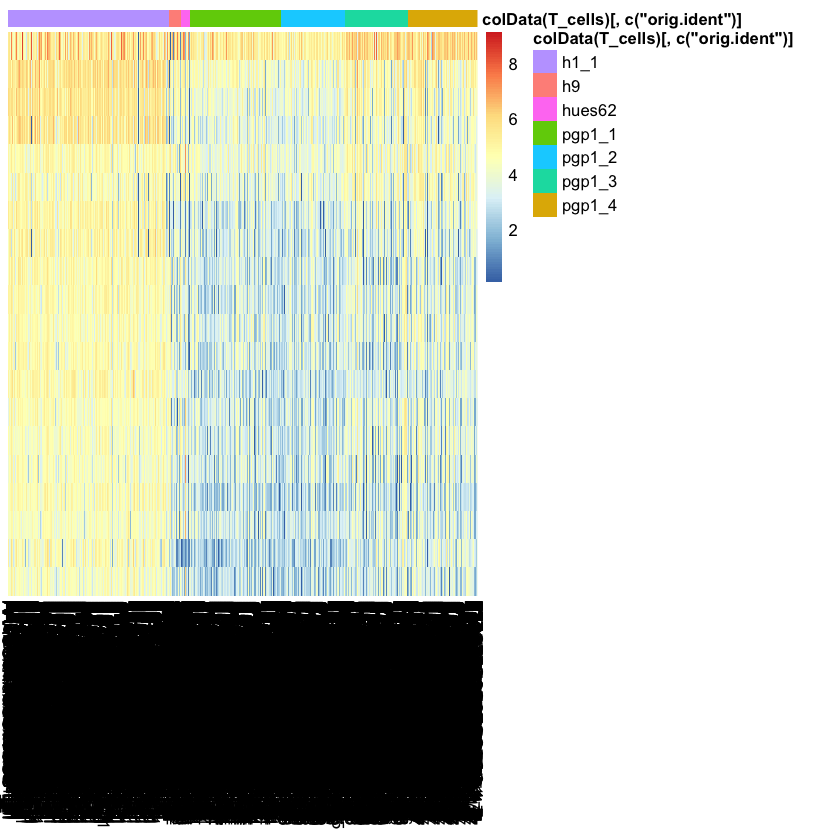

In [17]:
select_9 <- order(rowMeans(counts(T_cells,normalized=TRUE)), decreasing=TRUE)[1:20]
df_9 <- as.data.frame(colData(T_cells)[,c("orig.ident")])
row.names(df_9) <- colnames(ntd_t)

pheatmap(assay(ntd_t)[select_9,], cluster_rows=FALSE, show_rownames=FALSE,
         cluster_cols=FALSE, annotation_col=df_9)

pheatmap(assay(vsd_t)[select_9,], cluster_rows=FALSE, show_rownames=FALSE,
         cluster_cols=FALSE, annotation_col=df_9)

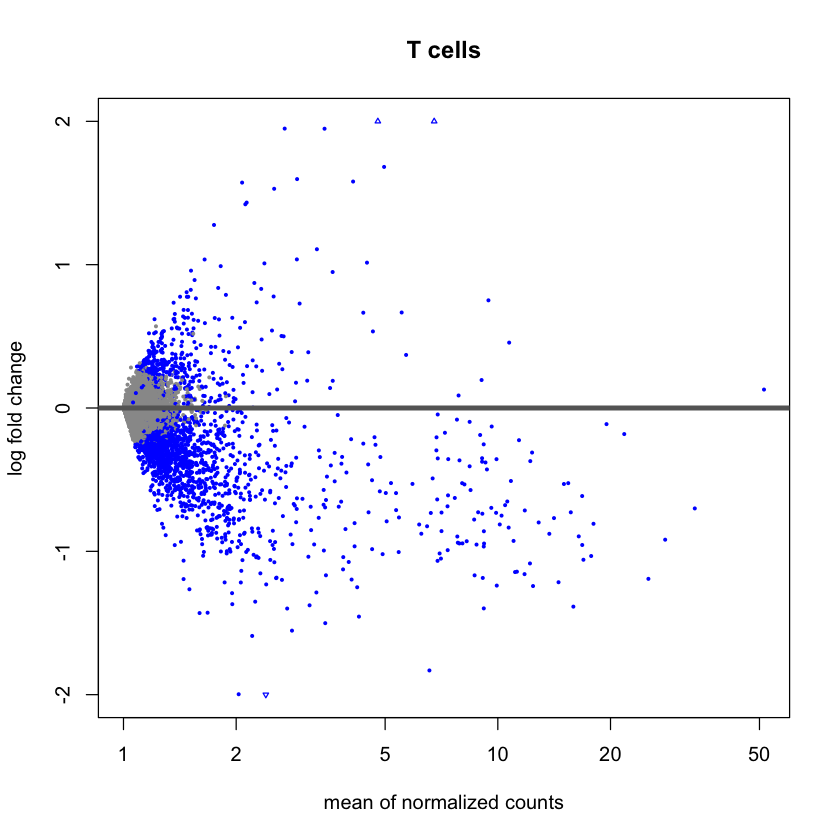

In [18]:
plotMA(res_t, ylim = c(-2,2), main = "T cells")

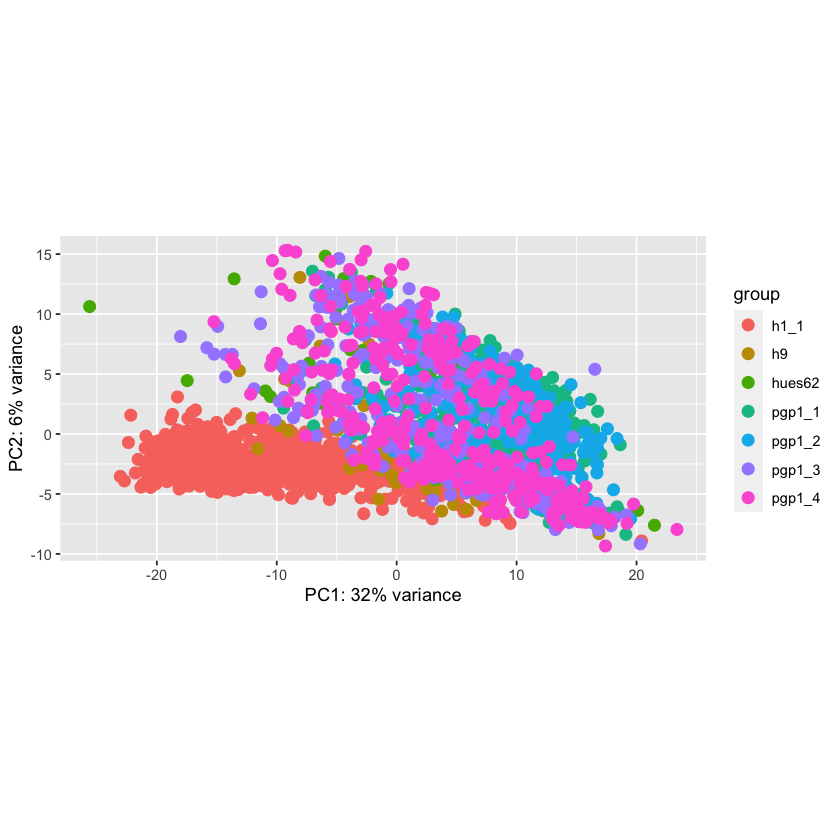

In [19]:
plotPCA(vsd_t, intgroup = c("orig.ident"))

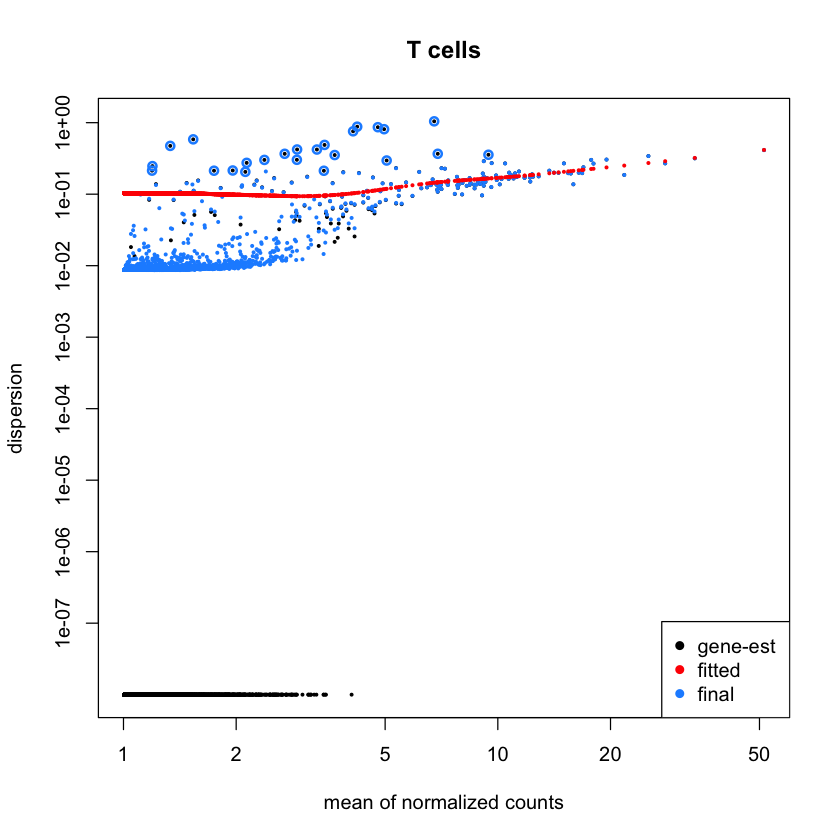

In [20]:
plotDispEsts(T_cells, main = "T cells")

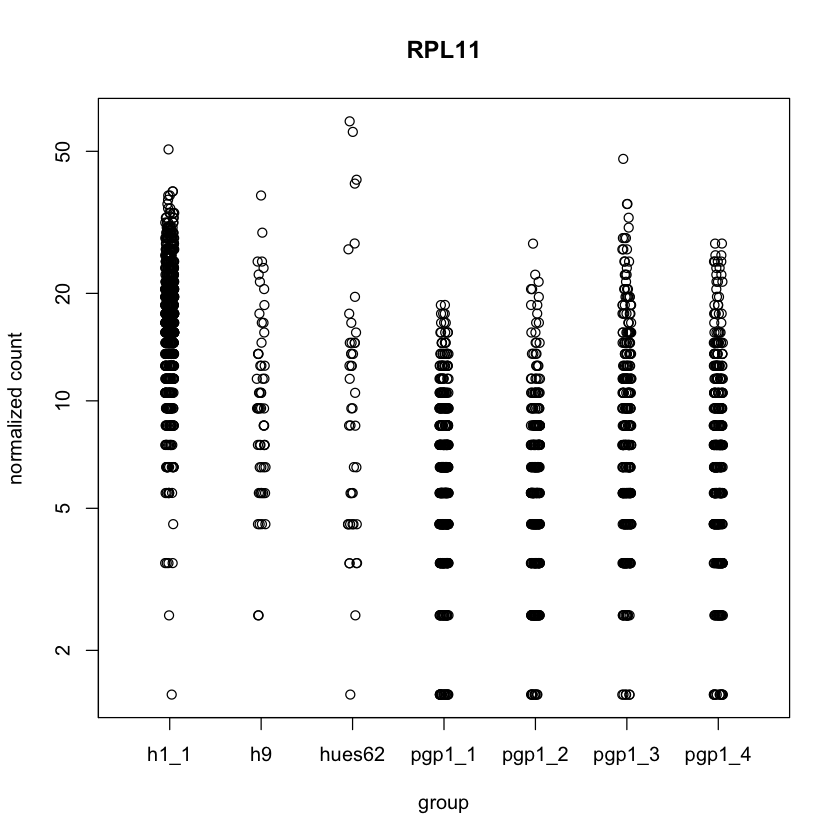

In [21]:
plotCounts(T_cells, gene = which.min(res_t$padj), intgroup = "orig.ident")

### Visualizing all the cell clusters

In [ ]:
# Memory issues with keeping everything in the memory (rm doesn't help for some reason)
# options(repr.plot.width = 15, repr.plot.height = 7)
# par(mfrow = c(5,2))

# plotMA(res_tissue, ylim = c(-2,2), main = "Tissue Stem Cells")
# plotMA(res_astrocytes, ylim = c(-2,2), main = "Astrocytes")
# plotMA(res_chondrocytes, ylim = c(-2,2), main = "Chondrocytes")
# plotMA(res_epithelial, ylim = c(-2,2), main = "Epithelial Cells")
# plotMA(res_erythroblast, ylim = c(-2,2), main = "Erythroblasts")
# plotMA(res_ips, ylim = c(-2,2), main = "iPS Cells")
# plotMA(res_neuroepithelial, ylim = c(-2,2), main = "Neuroepithelial Cells")
# plotMA(res_neurons, ylim = c(-2,2), main = "Neurons")
# plotMA(res_t, ylim = c(-2,2), main = "T cells")

In [ ]:
# I tried to put titles but I couldn't - I will check it again 
# options(repr.plot.width = 14, repr.plot.height = 13)
# p1 = plotPCA(vsd_tissue, intgroup=c("orig.ident"))
# p2 = plotPCA(vsd_astrocytes, intgroup=c("orig.ident"))
# p3 = plotPCA(vsd_chondrocytes, intgroup=c("orig.ident"))
# p4 = plotPCA(vsd_epithelial, intgroup=c("orig.ident"))
# p5 = plotPCA(vsd_erythroblast, intgroup=c("orig.ident"))
# p6 = plotPCA(vsd_ips, intgroup=c("orig.ident"))
# p7 = plotPCA(vsd_neuroepithelial, intgroup=c("orig.ident"))
# p8 = plotPCA(vsd_neurons, intgroup=c("orig.ident"))
# p9 = plotPCA(vsd_t, intgroup=c("orig.ident"))

# grid.arrange(p1, p2, p3, p4, p5, p6, p7, p8, p9 ncol = 2, nrow = 5)

In [ ]:
# options(repr.plot.width = 15, repr.plot.height = 7)
# par(mfrow=c(5,2))

# plotDispEsts(Tissue_stem_cells, main = "Tissue Stem Cells")
# plotDispEsts(Astrocytes, main = "Astrocytes")
# plotDispEsts(Chondrocytes, main = "Chondrocytes")
# plotDispEsts(Epithelial_cells, main = "Epithelial Cells")
# plotDispEsts(Erythroblasts, main = "Erythroblasts")
# plotDispEsts(ips_cells, main = "iPS Cells")
# plotDispEsts(Neuroepithelial_cells, main = "Neuroepithelial Cells")
# plotDispEsts(Neurons, main = "Neurons")
# plotDispEsts(T_cells, main = "T cells")

In [ ]:
# Also I am not sure exactly if its necessary to put titles since each plot indicates the gene with the smallest padj
# options(repr.plot.width = 15, repr.plot.height = 7)
# par(mfrow = c(5,2))

# plotCounts(Tissue_stem_cells, gene = which.min(res_tissue$padj), intgroup = "orig.ident")
# plotCounts(Astrocytes, gene = which.min(res_astrocytes$padj), intgroup="orig.ident")
# plotCounts(Chondrocytes, gene = which.min(res_chondrocytes$padj), intgroup="orig.ident")
# plotCounts(Epithelial_cells, gene = which.min(res_epithelial$padj), intgroup="orig.ident")
# plotCounts(Erythroblasts, gene=which.min(res_erythroblast$padj), intgroup="orig.ident")
# plotCounts(ips_cells, gene=which.min(res_ips$padj), intgroup="orig.ident")
# plotCounts(Neuroepithelial_cells, gene=which.min(res_neuroepithelial$padj), intgroup="orig.ident")
# plotCounts(Neurons, gene=which.min(res_neurons$padj), intgroup="orig.ident")
# plotCounts(T_cells, gene=which.min(res_t$padj), intgroup="orig.ident")

## Gene Enrichment Analysis

In [5]:
setwd("~/teratoma/res")

In [159]:
res_tissue <- readRDS(file = "./res_tissue.rds")
res_astrocytes <- readRDS(file = "./res_astrocytes.rds")
res_chondrocytes <- readRDS(file = "./res_chondrocytes.rds")
res_epithelial <- readRDS(file = "./res_epithelial.rds")
res_erythroblast <- readRDS(file = "./res_erythroblast.rds")
res_ips <- readRDS(file = "./res_ips.rds")
res_neuroepithelial <- readRDS(file = "./res_neuroepithelial.rds")
res_neurons <- readRDS(file = "./res_neurons.rds")
res_t <- readRDS(file = "./res_t.rds")

In [160]:
# Order by padj value
res_tissue_ord <- res_tissue[order(res_tissue$padj),]
res_astrocytes_ord <- res_astrocytes[order(res_astrocytes$padj),]
res_chondrocytes_ord <- res_chondrocytes[order(res_chondrocytes$padj),]
res_epithelial_ord <- res_epithelial[order(res_epithelial$padj),]
res_erythroblast_ord <- res_erythroblast[order(res_erythroblast$padj),]
res_ips_ord <- res_ips[order(res_ips$padj),]
res_neuroepithelial_ord <- res_neuroepithelial[order(res_neuroepithelial$padj),]
res_neurons_ord <- res_neurons[order(res_neurons$padj),]
res_t_ord <- res_t[order(res_t$padj),]

In [51]:
# colMap function for the plots
colMap <- function(x) {
  .col <- rep(rev(heat.colors(length(unique(x)))), time = table(x))
  return(.col[match(1:length(x), order(x))])
}

### Tissue Stem cells

In [167]:
genes <- rownames(res_tissue_ord)
p_values <- res_tissue_ord$pvalue
names(p_values) <- genes

p_values[p_values == 0] <- NA
p_values <- p_values[complete.cases(p_values)]

allGO2genes <- annFUN.org(whichOnto = "BP", feasibleGenes = NULL, mapping = "org.Hs.eg.db", ID = "symbol")
go_data <- new("topGOdata", ontology = "BP", allGenes = p_values, annot = annFUN.GO2genes, GO2genes = allGO2genes,
               geneSel = topDiffGenes, nodeSize = 10)


Building most specific GOs .....

	( 12206 GO terms found. )


Build GO DAG topology ..........

	( 15822 GO terms and 36050 relations. )


Annotating nodes ...............

	( 15441 genes annotated to the GO terms. )



In [168]:
resultFisher <- runTest(go_data, algorithm = "classic", statistic = "fisher")
resultKS <- runTest(go_data, algorithm = "classic", statistic = "ks")
resultKS.elim <- runTest(go_data, algorithm = "elim", statistic = "ks")


			 -- Classic Algorithm -- 

		 the algorithm is scoring 5711 nontrivial nodes
		 parameters: 
			 test statistic: fisher


			 -- Classic Algorithm -- 

		 the algorithm is scoring 6633 nontrivial nodes
		 parameters: 
			 test statistic: ks
			 score order: increasing


			 -- Elim Algorithm -- 

		 the algorithm is scoring 6633 nontrivial nodes
		 parameters: 
			 test statistic: ks
			 cutOff: 0.01
			 score order: increasing


	 Level 19:	1 nodes to be scored	(0 eliminated genes)


	 Level 18:	6 nodes to be scored	(0 eliminated genes)


	 Level 17:	11 nodes to be scored	(0 eliminated genes)


	 Level 16:	20 nodes to be scored	(0 eliminated genes)


	 Level 15:	47 nodes to be scored	(71 eliminated genes)


	 Level 14:	110 nodes to be scored	(85 eliminated genes)


	 Level 13:	167 nodes to be scored	(612 eliminated genes)


	 Level 12:	280 nodes to be scored	(2826 eliminated genes)


	 Level 11:	547 nodes to be scored	(4025 eliminated genes)


	 Level 10:	822 nodes to be scored	(5

In [169]:
results <- GenTable(go_data, classicFisher = resultFisher, 
                    classicKS = resultKS, elimKS = resultKS.elim, orderBy = "elimKS", 
                    ranksOf = "classicFisher", topNodes = 10)
results

,GO.ID,Term,Annotated,Significant,Expected,Rank in classicFisher,classicFisher,classicKS,elimKS
,<chr>,<chr>,<int>,<int>,<dbl>,<int>,<chr>,<chr>,<chr>
1,GO:0002181,cytoplasmic translation,144,100,8.93,1,< 1e-30,< 1e-30,< 1e-30
2,GO:0006120,"mitochondrial electron transport, NADH t...",43,13,2.67,271,1.2e-06,7.5e-16,7.5e-16
3,GO:0032981,mitochondrial respiratory chain complex ...,51,11,3.16,550,0.00024,2.2e-15,2.2e-15
4,GO:0006364,rRNA processing,218,29,13.53,481,8.4e-05,5.1e-22,3.6e-14
5,GO:0043161,proteasome-mediated ubiquitin-dependent ...,403,31,25.00,2335,0.12652,3.9e-26,8.6e-13
6,GO:0000398,"mRNA splicing, via spliceosome",281,51,17.43,83,3.1e-12,< 1e-30,1.6e-12
7,GO:0045892,"negative regulation of transcription, DN...",1166,92,72.34,1128,0.00935,1.6e-13,1.3e-11
8,GO:0050821,protein stabilization,177,35,10.98,131,7.7e-10,2.1e-11,2.1e-11
9,GO:0030199,collagen fibril organization,58,23,3.60,59,1.4e-13,4.5e-11,4.5e-11


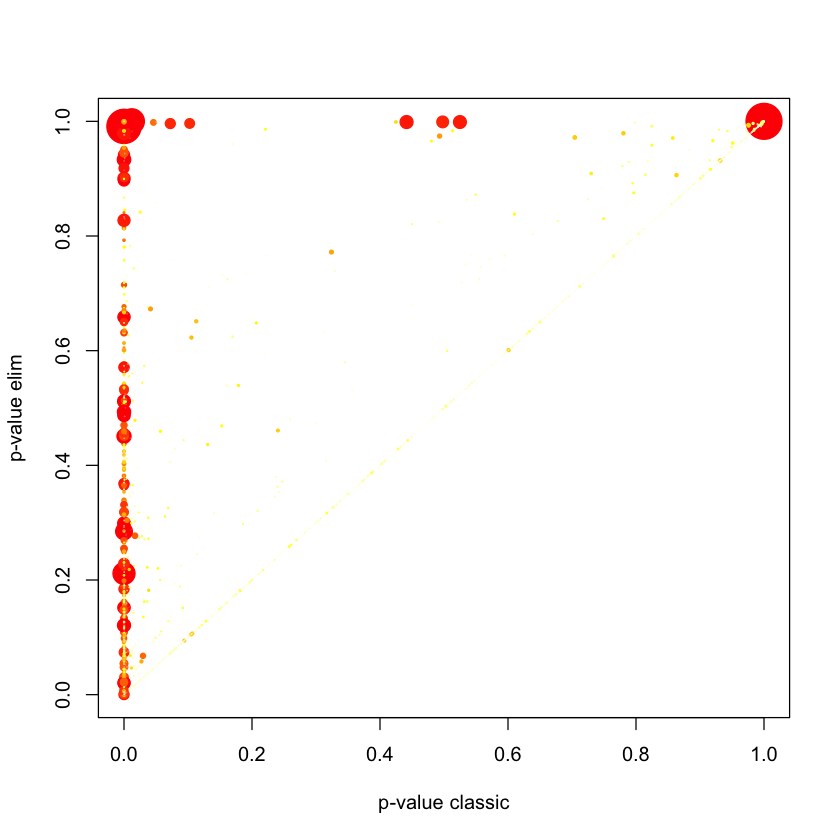

In [170]:
pValue.classic <- score(resultKS)
pValue.elim <- score(resultKS.elim)[names(pValue.classic)]
gstat <- termStat(go_data, names(pValue.classic))

gSize <- gstat$Annotated / max(gstat$Annotated) * 4
gCol <- colMap(gstat$Significant)
plot(pValue.classic, pValue.elim, xlab = "p-value classic", ylab = "p-value elim",
    pch = 19, cex = gSize, col = gCol)

In [171]:
tiff("tissue_stem_cells.tiff", width = 6, height = 6, units = 'in', res = 500)
showSigOfNodes(go_data, score(resultKS.elim), firstSigNodes = 5, useInfo = 'all')
dev.off()

$dag
A graphNEL graph with directed edges
Number of Nodes = 79 
Number of Edges = 132 

$complete.dag
[1] "A graph with 79 nodes."


pdf 
  2

### Astrocytes

In [112]:
#I didn't give different names because GO is faster than DE
genes <- rownames(res_astrocytes_ord)
p_values <- res_astrocytes_ord$pvalue
names(p_values) <- genes

p_values[p_values == 0] <- NA
p_values <- p_values[complete.cases(p_values)]

allGO2genes <- annFUN.org(whichOnto = "BP", feasibleGenes = NULL, mapping = "org.Hs.eg.db", ID = "symbol")
go_data <- new("topGOdata", ontology = "BP", allGenes = p_values, annot = annFUN.GO2genes, GO2genes = allGO2genes,
               geneSel = topDiffGenes, nodeSize = 10)


Building most specific GOs .....

	( 12196 GO terms found. )


Build GO DAG topology ..........

	( 15814 GO terms and 36029 relations. )


Annotating nodes ...............

	( 15410 genes annotated to the GO terms. )



In [113]:
# resultFisher <- runTest(go_data, algorithm = "classic", statistic = "fisher")
# resultKS <- runTest(go_data, algorithm = "classic", statistic = "ks")
resultKS.elim <- runTest(go_data, algorithm = "elim", statistic = "ks")


			 -- Elim Algorithm -- 

		 the algorithm is scoring 6626 nontrivial nodes
		 parameters: 
			 test statistic: ks
			 cutOff: 0.01
			 score order: increasing


	 Level 19:	1 nodes to be scored	(0 eliminated genes)


	 Level 18:	6 nodes to be scored	(0 eliminated genes)


	 Level 17:	11 nodes to be scored	(0 eliminated genes)


	 Level 16:	20 nodes to be scored	(0 eliminated genes)


	 Level 15:	47 nodes to be scored	(99 eliminated genes)


	 Level 14:	110 nodes to be scored	(290 eliminated genes)


	 Level 13:	166 nodes to be scored	(736 eliminated genes)


	 Level 12:	280 nodes to be scored	(2815 eliminated genes)


	 Level 11:	545 nodes to be scored	(4501 eliminated genes)


	 Level 10:	823 nodes to be scored	(5601 eliminated genes)


	 Level 9:	1017 nodes to be scored	(6750 eliminated genes)


	 Level 8:	1008 nodes to be scored	(8258 eliminated genes)


	 Level 7:	967 nodes to be scored	(9611 eliminated genes)


	 Level 6:	768 nodes to be scored	(10421 eliminated genes)


	 Leve

In [114]:
results <- GenTable(go_data, classicFisher = resultFisher, 
                    classicKS = resultKS, elimKS = resultKS.elim, orderBy = "elimKS", 
                    ranksOf = "classicFisher", topNodes = 10)
results

,GO.ID,Term,Annotated,Significant,Expected,Rank in classicFisher,classicFisher,classicKS,elimKS
,<chr>,<chr>,<int>,<int>,<dbl>,<int>,<chr>,<chr>,<chr>
1,GO:0002181,cytoplasmic translation,123,80,9.89,1,1,4.3e-25,< 1e-30
2,GO:0006120,"mitochondrial electron transport, NADH t...",43,26,3.46,2,1,0.81,4.8e-18
3,GO:0000122,negative regulation of transcription by ...,864,92,69.47,3,1,0.53,3.7e-14
4,GO:0000398,"mRNA splicing, via spliceosome",281,71,22.59,4,1,0.99,6.6e-14
5,GO:0043161,proteasome-mediated ubiquitin-dependent ...,401,35,32.24,5,1,0.92,1.1e-13
6,GO:0032981,mitochondrial respiratory chain complex ...,51,28,4.10,6,1,0.62,1.2e-13
7,GO:0045944,positive regulation of transcription by ...,1125,138,90.45,7,1,0.22,1.9e-11
8,GO:0042776,mitochondrial ATP synthesis coupled prot...,14,13,1.13,8,1,0.99,4.8e-10
9,GO:0008380,RNA splicing,391,86,31.44,9,1,0.98,1.9e-09


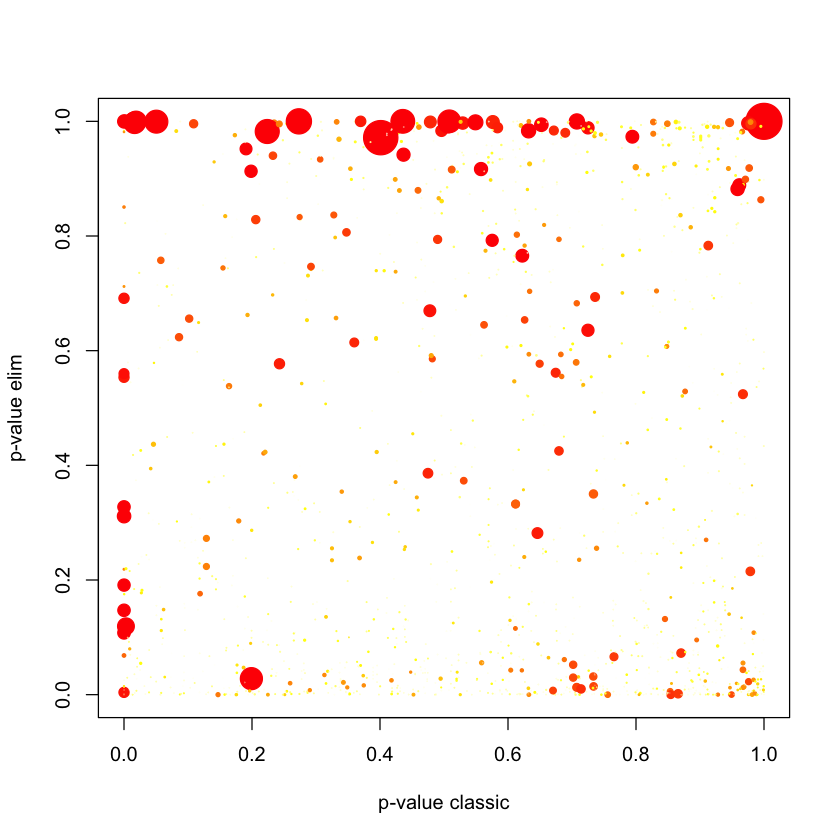

In [115]:
pValue.classic <- score(resultKS)
pValue.elim <- score(resultKS.elim)[names(pValue.classic)]
gstat <- termStat(go_data, names(pValue.classic))

gSize <- gstat$Annotated / max(gstat$Annotated) * 4
gCol <- colMap(gstat$Significant)
plot(pValue.classic, pValue.elim, xlab = "p-value classic", ylab = "p-value elim",
    pch = 19, cex = gSize, col = gCol)

In [116]:
sel.go <- names(pValue.classic)[pValue.elim < pValue.classic]
cbind(termStat(go_data, sel.go),
    elim = pValue.elim[sel.go],
    classic = pValue.classic[sel.go])

,Annotated,Significant,Expected,elim,classic
,<int>,<int>,<dbl>,<dbl>,<dbl>
GO:0000028,16,10,1.29,4.206476e-06,0.01608269
GO:0000070,163,16,13.11,1.533706e-02,0.90561332
GO:0000082,181,17,14.55,1.492273e-05,0.54341853
GO:0000122,864,92,69.47,3.710915e-14,0.52541713
GO:0000165,718,65,57.73,4.798450e-01,0.84801227
GO:0000209,227,14,18.25,1.607249e-04,0.83453376
GO:0000226,580,53,46.63,1.578892e-01,0.63257409
GO:0000278,831,87,66.81,5.167578e-02,0.17661344
GO:0000281,70,11,5.63,1.011234e-02,0.86998284


In [117]:
tiff("astrocytes.tiff", width = 6, height = 6, units = 'in', res = 500)
showSigOfNodes(go_data, score(resultKS.elim), firstSigNodes = 5, useInfo = 'all')
dev.off()

$dag
A graphNEL graph with directed edges
Number of Nodes = 110 
Number of Edges = 238 

$complete.dag
[1] "A graph with 110 nodes."


pdf 
  2

### Chondrocytes

In [118]:
genes <- rownames(res_chondrocytes_ord)
p_values <- res_chondrocytes_ord$pvalue
names(p_values) <- genes

p_values[p_values == 0] <- NA
p_values <- p_values[complete.cases(p_values)]

allGO2genes <- annFUN.org(whichOnto = "BP", feasibleGenes = NULL, mapping = "org.Hs.eg.db", ID = "symbol")
go_data <- new("topGOdata", ontology = "BP", allGenes = p_values, annot = annFUN.GO2genes, GO2genes = allGO2genes,
               geneSel = topDiffGenes, nodeSize = 10)


Building most specific GOs .....

	( 12174 GO terms found. )


Build GO DAG topology ..........

	( 15791 GO terms and 35975 relations. )


Annotating nodes ...............

	( 15321 genes annotated to the GO terms. )



In [119]:
resultFisher <- runTest(go_data, algorithm = "classic", statistic = "fisher")
resultKS <- runTest(go_data, algorithm = "classic", statistic = "ks")
resultKS.elim <- runTest(go_data, algorithm = "elim", statistic = "ks")


			 -- Classic Algorithm -- 

		 the algorithm is scoring 6372 nontrivial nodes
		 parameters: 
			 test statistic: fisher


			 -- Classic Algorithm -- 

		 the algorithm is scoring 6607 nontrivial nodes
		 parameters: 
			 test statistic: ks
			 score order: increasing


			 -- Elim Algorithm -- 

		 the algorithm is scoring 6607 nontrivial nodes
		 parameters: 
			 test statistic: ks
			 cutOff: 0.01
			 score order: increasing


	 Level 19:	1 nodes to be scored	(0 eliminated genes)


	 Level 18:	6 nodes to be scored	(0 eliminated genes)


	 Level 17:	11 nodes to be scored	(0 eliminated genes)


	 Level 16:	18 nodes to be scored	(18 eliminated genes)


	 Level 15:	47 nodes to be scored	(72 eliminated genes)


	 Level 14:	107 nodes to be scored	(231 eliminated genes)


	 Level 13:	166 nodes to be scored	(633 eliminated genes)


	 Level 12:	278 nodes to be scored	(2706 eliminated genes)


	 Level 11:	543 nodes to be scored	(4649 eliminated genes)


	 Level 10:	818 nodes to be scored	

In [120]:
results <- GenTable(go_data, classicFisher = resultFisher, 
                    classicKS = resultKS, elimKS = resultKS.elim, orderBy = "elimKS", 
                    ranksOf = "classicFisher", topNodes = 10)
results

,GO.ID,Term,Annotated,Significant,Expected,Rank in classicFisher,classicFisher,classicKS,elimKS
,<chr>,<chr>,<int>,<int>,<dbl>,<int>,<chr>,<chr>,<chr>
1,GO:0006120,"mitochondrial electron transport, NADH t...",42,33,6.74,59,4.9e-19,4.9e-17,4.9e-17
2,GO:0002181,cytoplasmic translation,95,61,15.23,16,4.0e-26,1.1e-21,4.4e-16
3,GO:0032981,mitochondrial respiratory chain complex ...,50,33,8.02,85,2.8e-15,2.8e-13,2.8e-13
4,GO:0045892,"negative regulation of transcription, DN...",1157,261,185.55,181,1.1e-09,4.3e-18,9.1e-13
5,GO:0043161,proteasome-mediated ubiquitin-dependent ...,401,94,64.31,559,6.2e-05,9.0e-24,2.9e-12
6,GO:0000398,"mRNA splicing, via spliceosome",279,115,44.74,26,3.5e-24,3.4e-28,2.0e-11
7,GO:0050821,protein stabilization,171,55,27.42,270,1.2e-07,1.1e-10,1.1e-10
8,GO:0045944,positive regulation of transcription by ...,1114,244,178.65,250,6.0e-08,9.5e-13,8.6e-10
9,GO:0006364,rRNA processing,203,50,32.55,826,0.00097,2.7e-17,1.4e-09


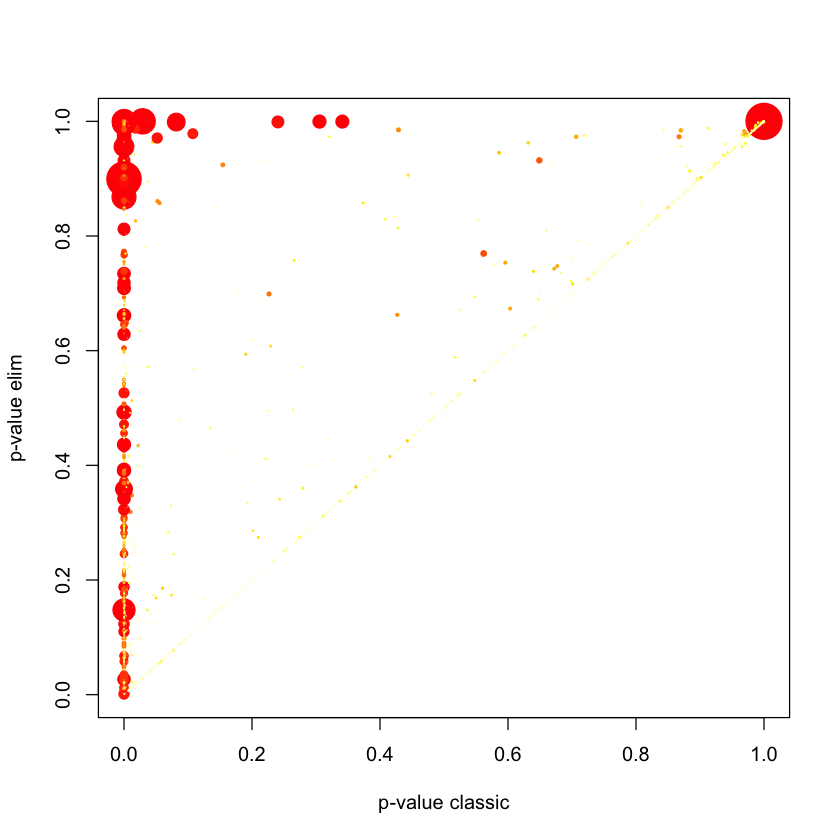

In [121]:
pValue.classic <- score(resultKS)
pValue.elim <- score(resultKS.elim)[names(pValue.classic)]
gstat <- termStat(go_data, names(pValue.classic))

gSize <- gstat$Annotated / max(gstat$Annotated) * 4
gCol <- colMap(gstat$Significant)
plot(pValue.classic, pValue.elim, xlab = "p-value classic", ylab = "p-value elim",
    pch = 19, cex = gSize, col = gCol)

In [122]:
tiff("chondrocytes.tiff", width = 6, height = 6, units = 'in', res = 500)
showSigOfNodes(go_data, score(resultKS.elim), firstSigNodes = 5, useInfo = 'all')
dev.off()

$dag
A graphNEL graph with directed edges
Number of Nodes = 112 
Number of Edges = 238 

$complete.dag
[1] "A graph with 112 nodes."


pdf 
  2

### Epithelial Cells

In [123]:
genes <- rownames(res_epithelial_ord)
p_values <- res_epithelial_ord$pvalue
names(p_values) <- genes

p_values[p_values == 0] <- NA
p_values <- p_values[complete.cases(p_values)]

allGO2genes <- annFUN.org(whichOnto = "BP", feasibleGenes = NULL, mapping = "org.Hs.eg.db", ID = "symbol")
go_data <- new("topGOdata", ontology = "BP", allGenes = p_values, annot = annFUN.GO2genes, GO2genes = allGO2genes,
               geneSel = topDiffGenes, nodeSize = 10)


Building most specific GOs .....

	( 12199 GO terms found. )


Build GO DAG topology ..........

	( 15815 GO terms and 36031 relations. )


Annotating nodes ...............

	( 15424 genes annotated to the GO terms. )



In [124]:
resultFisher <- runTest(go_data, algorithm = "classic", statistic = "fisher")
resultKS <- runTest(go_data, algorithm = "classic", statistic = "ks")
resultKS.elim <- runTest(go_data, algorithm = "elim", statistic = "ks")


			 -- Classic Algorithm -- 

		 the algorithm is scoring 6012 nontrivial nodes
		 parameters: 
			 test statistic: fisher


			 -- Classic Algorithm -- 

		 the algorithm is scoring 6627 nontrivial nodes
		 parameters: 
			 test statistic: ks
			 score order: increasing


			 -- Elim Algorithm -- 

		 the algorithm is scoring 6627 nontrivial nodes
		 parameters: 
			 test statistic: ks
			 cutOff: 0.01
			 score order: increasing


	 Level 19:	1 nodes to be scored	(0 eliminated genes)


	 Level 18:	6 nodes to be scored	(0 eliminated genes)


	 Level 17:	11 nodes to be scored	(0 eliminated genes)


	 Level 16:	19 nodes to be scored	(0 eliminated genes)


	 Level 15:	47 nodes to be scored	(80 eliminated genes)


	 Level 14:	110 nodes to be scored	(110 eliminated genes)


	 Level 13:	167 nodes to be scored	(677 eliminated genes)


	 Level 12:	280 nodes to be scored	(2855 eliminated genes)


	 Level 11:	546 nodes to be scored	(3999 eliminated genes)


	 Level 10:	822 nodes to be scored	(

In [125]:
results <- GenTable(go_data, classicFisher = resultFisher, 
                    classicKS = resultKS, elimKS = resultKS.elim, orderBy = "elimKS", 
                    ranksOf = "classicFisher", topNodes = 10)
results

,GO.ID,Term,Annotated,Significant,Expected,Rank in classicFisher,classicFisher,classicKS,elimKS
,<chr>,<chr>,<int>,<int>,<dbl>,<int>,<chr>,<chr>,<chr>
1,GO:0002181,cytoplasmic translation,143,100,13.68,1,< 1e-30,< 1e-30,< 1e-30
2,GO:0006120,"mitochondrial electron transport, NADH t...",43,30,4.11,20,2.2e-21,2.7e-21,2.7e-21
3,GO:0032981,mitochondrial respiratory chain complex ...,51,29,4.88,34,4.2e-17,1.4e-14,1.4e-14
4,GO:0050821,protein stabilization,176,45,16.84,96,5.4e-10,6.1e-12,6.1e-12
5,GO:0006457,protein folding,189,58,18.09,39,2.7e-16,7.2e-19,7.4e-11
6,GO:0051301,cell division,576,75,55.12,704,0.00355,1.4e-13,1.6e-10
7,GO:0042776,mitochondrial ATP synthesis coupled prot...,14,13,1.34,58,6.9e-13,9.0e-10,9.0e-10
8,GO:0006364,rRNA processing,218,36,20.86,515,0.00082,3.2e-14,1.2e-09
9,GO:0045892,"negative regulation of transcription, DN...",1166,135,111.58,872,0.01008,8.2e-12,3.9e-09


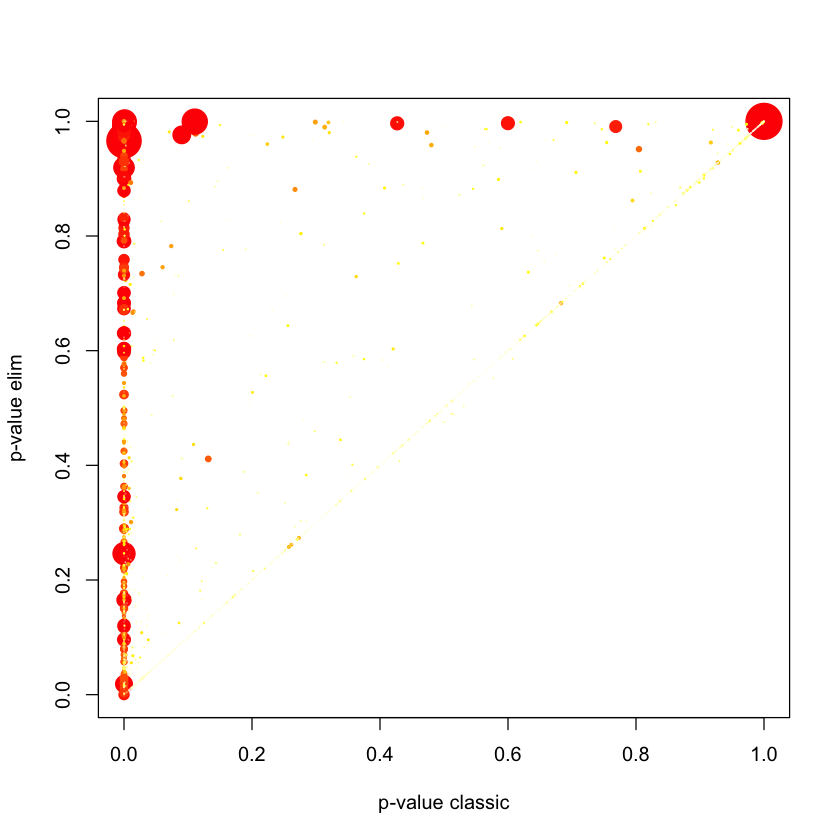

In [126]:
pValue.classic <- score(resultKS)
pValue.elim <- score(resultKS.elim)[names(pValue.classic)]
gstat <- termStat(go_data, names(pValue.classic))

gSize <- gstat$Annotated / max(gstat$Annotated) * 4
gCol <- colMap(gstat$Significant)
plot(pValue.classic, pValue.elim, xlab = "p-value classic", ylab = "p-value elim",
    pch = 19, cex = gSize, col = gCol)

In [127]:
tiff("epithelial_cells.tiff", width = 6, height = 6, units = 'in', res = 500)
showSigOfNodes(go_data, score(resultKS.elim), firstSigNodes = 5, useInfo = 'all')
dev.off()

$dag
A graphNEL graph with directed edges
Number of Nodes = 56 
Number of Edges = 86 

$complete.dag
[1] "A graph with 56 nodes."


pdf 
  2

### Erythroblasts

In [128]:
genes <- rownames(res_erythroblast_ord)
p_values <- res_erythroblast_ord$pvalue
names(p_values) <- genes

p_values[p_values == 0] <- NA
p_values <- p_values[complete.cases(p_values)]

allGO2genes <- annFUN.org(whichOnto = "BP", feasibleGenes = NULL, mapping = "org.Hs.eg.db", ID = "symbol")
go_data <- new("topGOdata", ontology = "BP", allGenes = p_values, annot = annFUN.GO2genes, GO2genes = allGO2genes,
               geneSel = topDiffGenes, nodeSize = 10)


Building most specific GOs .....

	( 12170 GO terms found. )


Build GO DAG topology ..........

	( 15793 GO terms and 35972 relations. )


Annotating nodes ...............

	( 15317 genes annotated to the GO terms. )



In [129]:
resultFisher <- runTest(go_data, algorithm = "classic", statistic = "fisher")
resultKS <- runTest(go_data, algorithm = "classic", statistic = "ks")
resultKS.elim <- runTest(go_data, algorithm = "elim", statistic = "ks")


			 -- Classic Algorithm -- 

		 the algorithm is scoring 6235 nontrivial nodes
		 parameters: 
			 test statistic: fisher


			 -- Classic Algorithm -- 

		 the algorithm is scoring 6604 nontrivial nodes
		 parameters: 
			 test statistic: ks
			 score order: increasing


			 -- Elim Algorithm -- 

		 the algorithm is scoring 6604 nontrivial nodes
		 parameters: 
			 test statistic: ks
			 cutOff: 0.01
			 score order: increasing


	 Level 19:	1 nodes to be scored	(0 eliminated genes)


	 Level 18:	6 nodes to be scored	(0 eliminated genes)


	 Level 17:	11 nodes to be scored	(0 eliminated genes)


	 Level 16:	19 nodes to be scored	(0 eliminated genes)


	 Level 15:	47 nodes to be scored	(80 eliminated genes)


	 Level 14:	106 nodes to be scored	(289 eliminated genes)


	 Level 13:	164 nodes to be scored	(810 eliminated genes)


	 Level 12:	278 nodes to be scored	(2864 eliminated genes)


	 Level 11:	543 nodes to be scored	(4503 eliminated genes)


	 Level 10:	819 nodes to be scored	(

In [130]:
results <- GenTable(go_data, classicFisher = resultFisher, 
                    classicKS = resultKS, elimKS = resultKS.elim, orderBy = "elimKS", 
                    ranksOf = "classicFisher", topNodes = 10)
results

,GO.ID,Term,Annotated,Significant,Expected,Rank in classicFisher,classicFisher,classicKS,elimKS
,<chr>,<chr>,<int>,<int>,<dbl>,<int>,<chr>,<chr>,<chr>
1,GO:0051301,cell division,569,139,85.07,125,1.0e-09,3.3e-30,9.7e-24
2,GO:0002181,cytoplasmic translation,99,69,14.80,11,< 1e-30,8.6e-29,5.8e-21
3,GO:0032981,mitochondrial respiratory chain complex ...,48,35,7.18,55,2.7e-19,2.0e-17,2.0e-17
4,GO:0006120,"mitochondrial electron transport, NADH t...",40,32,5.98,52,7.2e-20,4.9e-17,4.9e-17
5,GO:0000398,"mRNA splicing, via spliceosome",276,115,41.26,22,2.3e-27,< 1e-30,6.2e-14
6,GO:0006364,rRNA processing,205,83,30.65,58,3.8e-19,3.3e-27,1.8e-13
7,GO:0006412,translation,560,235,83.72,1,< 1e-30,< 1e-30,2.3e-12
8,GO:0045892,"negative regulation of transcription, DN...",1158,228,173.13,239,3.3e-06,1.7e-18,8.9e-12
9,GO:0043161,proteasome-mediated ubiquitin-dependent ...,399,84,59.65,458,0.00057,1.6e-20,3.2e-11


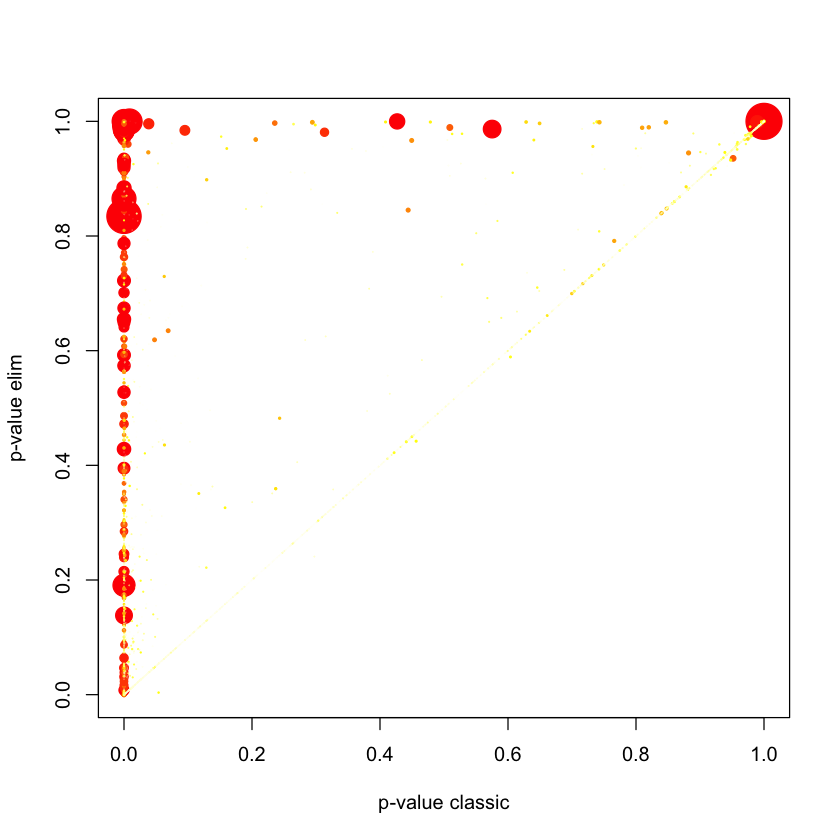

In [131]:
pValue.classic <- score(resultKS)
pValue.elim <- score(resultKS.elim)[names(pValue.classic)]
gstat <- termStat(go_data, names(pValue.classic))

gSize <- gstat$Annotated / max(gstat$Annotated) * 4
gCol <- colMap(gstat$Significant)
plot(pValue.classic, pValue.elim, xlab = "p-value classic", ylab = "p-value elim",
    pch = 19, cex = gSize, col = gCol)

In [132]:
tiff("erythroblast.tiff", width = 6, height = 6, units = 'in', res = 500)
showSigOfNodes(go_data, score(resultKS.elim), firstSigNodes = 5, useInfo = 'all')
dev.off()

$dag
A graphNEL graph with directed edges
Number of Nodes = 65 
Number of Edges = 103 

$complete.dag
[1] "A graph with 65 nodes."


pdf 
  2

### iPS Cells

In [133]:
genes <- rownames(res_ips_ord)
p_values <- res_ips_ord$pvalue
names(p_values) <- genes

p_values[p_values == 0] <- NA
p_values <- p_values[complete.cases(p_values)]

allGO2genes <- annFUN.org(whichOnto = "BP", feasibleGenes = NULL, mapping = "org.Hs.eg.db", ID = "symbol")
go_data <- new("topGOdata", ontology = "BP", allGenes = p_values, annot = annFUN.GO2genes, GO2genes = allGO2genes,
               geneSel = topDiffGenes, nodeSize = 10)


Building most specific GOs .....

	( 12198 GO terms found. )


Build GO DAG topology ..........

	( 15816 GO terms and 36033 relations. )


Annotating nodes ...............

	( 15408 genes annotated to the GO terms. )



In [134]:
resultFisher <- runTest(go_data, algorithm = "classic", statistic = "fisher")
resultKS <- runTest(go_data, algorithm = "classic", statistic = "ks")
resultKS.elim <- runTest(go_data, algorithm = "elim", statistic = "ks")


			 -- Classic Algorithm -- 

		 the algorithm is scoring 6130 nontrivial nodes
		 parameters: 
			 test statistic: fisher


			 -- Classic Algorithm -- 

		 the algorithm is scoring 6625 nontrivial nodes
		 parameters: 
			 test statistic: ks
			 score order: increasing


			 -- Elim Algorithm -- 

		 the algorithm is scoring 6625 nontrivial nodes
		 parameters: 
			 test statistic: ks
			 cutOff: 0.01
			 score order: increasing


	 Level 19:	1 nodes to be scored	(0 eliminated genes)


	 Level 18:	6 nodes to be scored	(0 eliminated genes)


	 Level 17:	11 nodes to be scored	(0 eliminated genes)


	 Level 16:	20 nodes to be scored	(0 eliminated genes)


	 Level 15:	47 nodes to be scored	(71 eliminated genes)


	 Level 14:	110 nodes to be scored	(180 eliminated genes)


	 Level 13:	166 nodes to be scored	(571 eliminated genes)


	 Level 12:	280 nodes to be scored	(2676 eliminated genes)


	 Level 11:	545 nodes to be scored	(4482 eliminated genes)


	 Level 10:	820 nodes to be scored	(

In [135]:
results <- GenTable(go_data, classicFisher = resultFisher, 
                    classicKS = resultKS, elimKS = resultKS.elim, orderBy = "elimKS", 
                    ranksOf = "classicFisher", topNodes = 10)
results

,GO.ID,Term,Annotated,Significant,Expected,Rank in classicFisher,classicFisher,classicKS,elimKS
,<chr>,<chr>,<int>,<int>,<dbl>,<int>,<chr>,<chr>,<chr>
1,GO:0002181,cytoplasmic translation,133,96,14.36,2,< 1e-30,< 1e-30,< 1e-30
2,GO:0051301,cell division,575,102,62.10,289,2.5e-07,< 1e-30,1.8e-25
3,GO:0006364,rRNA processing,215,42,23.22,576,9.9e-05,1.6e-27,3.5e-16
4,GO:0032981,mitochondrial respiratory chain complex ...,51,29,5.51,82,1.1e-15,4.1e-16,4.1e-16
5,GO:0006120,"mitochondrial electron transport, NADH t...",43,28,4.64,68,2.1e-17,1.3e-15,1.3e-15
6,GO:0045892,"negative regulation of transcription, DN...",1161,177,125.38,326,7.9e-07,5.1e-17,1.4e-13
7,GO:0006281,DNA repair,495,61,53.46,2542,0.15,1.7e-19,1.6e-11
8,GO:0043161,proteasome-mediated ubiquitin-dependent ...,403,80,43.52,254,4.3e-08,2.9e-25,8.1e-11
9,GO:0050821,protein stabilization,175,52,18.90,125,4.7e-12,8.5e-11,8.5e-11


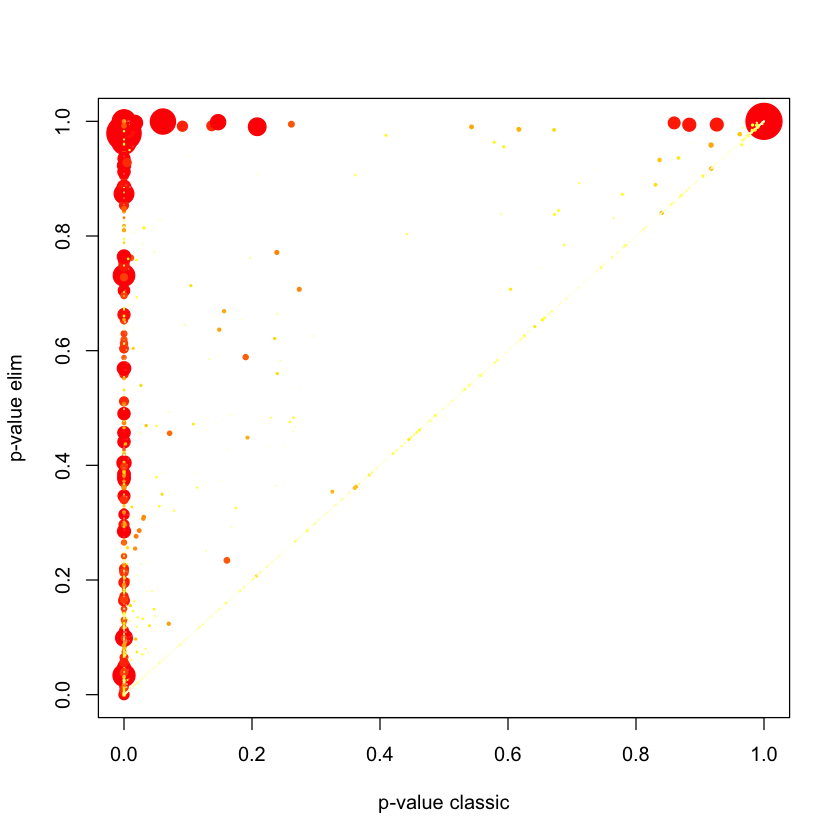

In [136]:
pValue.classic <- score(resultKS)
pValue.elim <- score(resultKS.elim)[names(pValue.classic)]
gstat <- termStat(go_data, names(pValue.classic))

gSize <- gstat$Annotated / max(gstat$Annotated) * 4
gCol <- colMap(gstat$Significant)
plot(pValue.classic, pValue.elim, xlab = "p-value classic", ylab = "p-value elim",
    pch = 19, cex = gSize, col = gCol)

In [137]:
tiff("ips_cells.tiff", width = 6, height = 6, units = 'in', res = 500)
showSigOfNodes(go_data, score(resultKS.elim), firstSigNodes = 5, useInfo = 'all')
dev.off()

$dag
A graphNEL graph with directed edges
Number of Nodes = 65 
Number of Edges = 104 

$complete.dag
[1] "A graph with 65 nodes."


pdf 
  2

### Neuroepithelial Cells

In [138]:
genes <- rownames(res_neuroepithelial_ord)
p_values <- res_neuroepithelial_ord$pvalue
names(p_values) <- genes

p_values[p_values == 0] <- NA
p_values <- p_values[complete.cases(p_values)]

allGO2genes <- annFUN.org(whichOnto = "BP", feasibleGenes = NULL, mapping = "org.Hs.eg.db", ID = "symbol")
go_data <- new("topGOdata", ontology = "BP", allGenes = p_values, annot = annFUN.GO2genes, GO2genes = allGO2genes,
               geneSel = topDiffGenes, nodeSize = 10)


Building most specific GOs .....

	( 12198 GO terms found. )


Build GO DAG topology ..........

	( 15815 GO terms and 36029 relations. )


Annotating nodes ...............

	( 15429 genes annotated to the GO terms. )



In [139]:
resultFisher <- runTest(go_data, algorithm = "classic", statistic = "fisher")
resultKS <- runTest(go_data, algorithm = "classic", statistic = "ks")
resultKS.elim <- runTest(go_data, algorithm = "elim", statistic = "ks")


			 -- Classic Algorithm -- 

		 the algorithm is scoring 5594 nontrivial nodes
		 parameters: 
			 test statistic: fisher


			 -- Classic Algorithm -- 

		 the algorithm is scoring 6627 nontrivial nodes
		 parameters: 
			 test statistic: ks
			 score order: increasing


			 -- Elim Algorithm -- 

		 the algorithm is scoring 6627 nontrivial nodes
		 parameters: 
			 test statistic: ks
			 cutOff: 0.01
			 score order: increasing


	 Level 19:	1 nodes to be scored	(0 eliminated genes)


	 Level 18:	6 nodes to be scored	(0 eliminated genes)


	 Level 17:	11 nodes to be scored	(0 eliminated genes)


	 Level 16:	20 nodes to be scored	(0 eliminated genes)


	 Level 15:	47 nodes to be scored	(89 eliminated genes)


	 Level 14:	110 nodes to be scored	(221 eliminated genes)


	 Level 13:	165 nodes to be scored	(733 eliminated genes)


	 Level 12:	279 nodes to be scored	(2852 eliminated genes)


	 Level 11:	547 nodes to be scored	(4465 eliminated genes)


	 Level 10:	822 nodes to be scored	(

In [140]:
results <- GenTable(go_data, classicFisher = resultFisher, 
                    classicKS = resultKS, elimKS = resultKS.elim, orderBy = "elimKS", 
                    ranksOf = "classicFisher", topNodes = 10)
results

,GO.ID,Term,Annotated,Significant,Expected,Rank in classicFisher,classicFisher,classicKS,elimKS
,<chr>,<chr>,<int>,<int>,<dbl>,<int>,<chr>,<chr>,<chr>
1,GO:0002181,cytoplasmic translation,140,93,10.40,2,< 1e-30,< 1e-30,< 1e-30
2,GO:0006120,"mitochondrial electron transport, NADH t...",43,29,3.19,25,3.7e-23,5.8e-21,5.8e-21
3,GO:0051301,cell division,576,74,42.78,155,2.3e-06,1.2e-27,2.2e-19
4,GO:0032981,mitochondrial respiratory chain complex ...,51,30,3.79,29,2.3e-21,1.8e-18,1.8e-18
5,GO:0000398,"mRNA splicing, via spliceosome",280,69,20.80,35,2.0e-19,< 1e-30,7.9e-14
6,GO:0006364,rRNA processing,216,39,16.04,108,1.8e-07,2.3e-23,1.5e-13
7,GO:0050821,protein stabilization,176,34,13.07,111,2.1e-07,3.9e-13,3.9e-13
8,GO:0000122,negative regulation of transcription by ...,864,67,64.17,2492,0.372,1.1e-11,1.2e-10
9,GO:0043161,proteasome-mediated ubiquitin-dependent ...,403,41,29.93,790,0.025,1.1e-23,1.4e-10


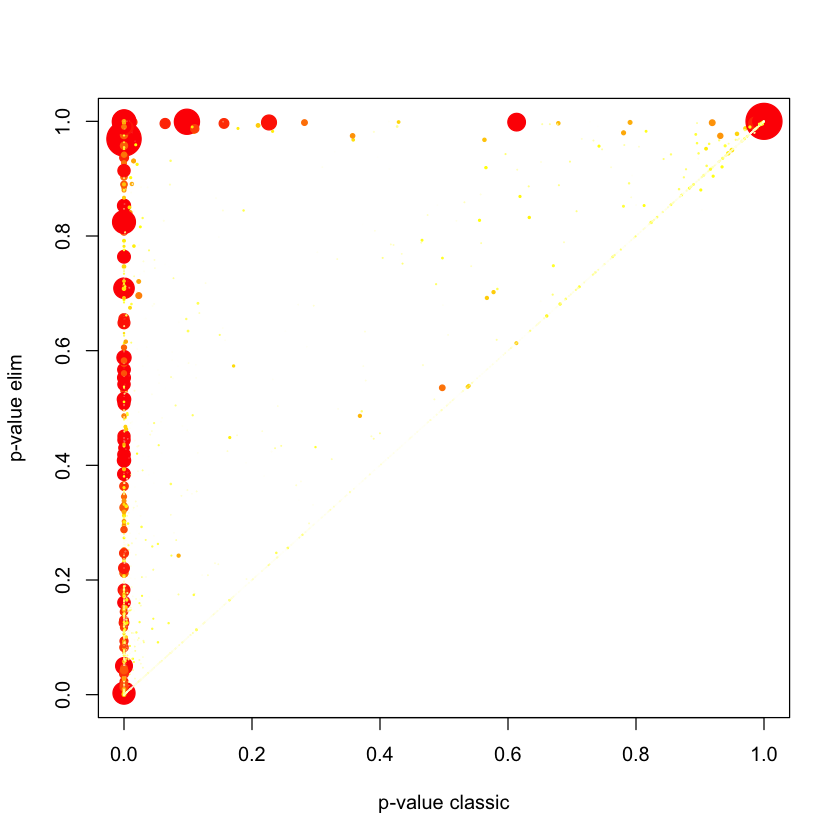

In [141]:
pValue.classic <- score(resultKS)
pValue.elim <- score(resultKS.elim)[names(pValue.classic)]
gstat <- termStat(go_data, names(pValue.classic))

gSize <- gstat$Annotated / max(gstat$Annotated) * 4
gCol <- colMap(gstat$Significant)
plot(pValue.classic, pValue.elim, xlab = "p-value classic", ylab = "p-value elim",
    pch = 19, cex = gSize, col = gCol)

In [142]:
tiff("neuroepithelial_cells.tiff", width = 6, height = 6, units = 'in', res = 500)
showSigOfNodes(go_data, score(resultKS.elim), firstSigNodes = 5, useInfo = 'all')
dev.off()

$dag
A graphNEL graph with directed edges
Number of Nodes = 65 
Number of Edges = 103 

$complete.dag
[1] "A graph with 65 nodes."


pdf 
  2

### Neurons

In [143]:
genes <- rownames(res_neurons_ord)
p_values <- res_neurons_ord$pvalue
names(p_values) <- genes

p_values[p_values == 0] <- NA
p_values <- p_values[complete.cases(p_values)]

allGO2genes <- annFUN.org(whichOnto = "BP", feasibleGenes = NULL, mapping = "org.Hs.eg.db", ID = "symbol")
go_data <- new("topGOdata", ontology = "BP", allGenes = p_values, annot = annFUN.GO2genes, GO2genes = allGO2genes,
               geneSel = topDiffGenes, nodeSize = 10)


Building most specific GOs .....

	( 12195 GO terms found. )


Build GO DAG topology ..........

	( 15811 GO terms and 36015 relations. )


Annotating nodes ...............

	( 15409 genes annotated to the GO terms. )



In [144]:
resultFisher <- runTest(go_data, algorithm = "classic", statistic = "fisher")
resultKS <- runTest(go_data, algorithm = "classic", statistic = "ks")
resultKS.elim <- runTest(go_data, algorithm = "elim", statistic = "ks")


			 -- Classic Algorithm -- 

		 the algorithm is scoring 6078 nontrivial nodes
		 parameters: 
			 test statistic: fisher


			 -- Classic Algorithm -- 

		 the algorithm is scoring 6624 nontrivial nodes
		 parameters: 
			 test statistic: ks
			 score order: increasing


			 -- Elim Algorithm -- 

		 the algorithm is scoring 6624 nontrivial nodes
		 parameters: 
			 test statistic: ks
			 cutOff: 0.01
			 score order: increasing


	 Level 19:	1 nodes to be scored	(0 eliminated genes)


	 Level 18:	6 nodes to be scored	(0 eliminated genes)


	 Level 17:	11 nodes to be scored	(0 eliminated genes)


	 Level 16:	20 nodes to be scored	(0 eliminated genes)


	 Level 15:	47 nodes to be scored	(134 eliminated genes)


	 Level 14:	110 nodes to be scored	(321 eliminated genes)


	 Level 13:	166 nodes to be scored	(789 eliminated genes)


	 Level 12:	280 nodes to be scored	(2839 eliminated genes)


	 Level 11:	543 nodes to be scored	(4494 eliminated genes)


	 Level 10:	823 nodes to be scored	

In [145]:
results <- GenTable(go_data, classicFisher = resultFisher, 
                    classicKS = resultKS, elimKS = resultKS.elim, orderBy = "elimKS", 
                    ranksOf = "classicFisher", topNodes = 10)
results

,GO.ID,Term,Annotated,Significant,Expected,Rank in classicFisher,classicFisher,classicKS,elimKS
,<chr>,<chr>,<int>,<int>,<dbl>,<int>,<chr>,<chr>,<chr>
1,GO:0002181,cytoplasmic translation,133,94,16.43,1,< 1e-30,< 1e-30,< 1e-30
2,GO:0043161,proteasome-mediated ubiquitin-dependent ...,402,69,49.65,701,0.0027,2.4e-24,1.7e-14
3,GO:0006120,"mitochondrial electron transport, NADH t...",43,27,5.31,111,9.1e-15,2.5e-14,2.5e-14
4,GO:0000122,negative regulation of transcription by ...,861,157,106.33,248,1.9e-07,5.9e-15,3.1e-14
5,GO:0000398,"mRNA splicing, via spliceosome",280,111,34.58,11,< 1e-30,< 1e-30,3.4e-12
6,GO:0051301,cell division,574,103,70.89,416,5.0e-05,5.6e-16,3.7e-12
7,GO:0032981,mitochondrial respiratory chain complex ...,51,25,6.30,159,1.7e-10,5.8e-11,5.8e-11
8,GO:0001764,neuron migration,150,53,18.52,126,2.6e-13,1.3e-13,1.3e-10
9,GO:0006886,intracellular protein transport,847,130,104.60,770,0.0046,3.3e-26,2.2e-10


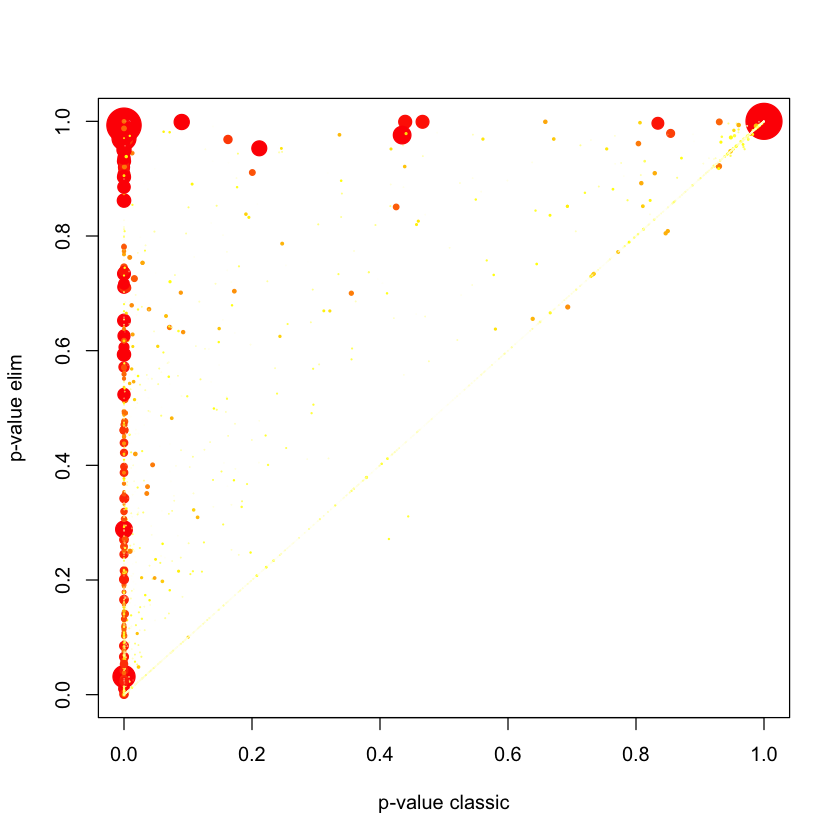

In [146]:
pValue.classic <- score(resultKS)
pValue.elim <- score(resultKS.elim)[names(pValue.classic)]
gstat <- termStat(go_data, names(pValue.classic))

gSize <- gstat$Annotated / max(gstat$Annotated) * 4
gCol <- colMap(gstat$Significant)
plot(pValue.classic, pValue.elim, xlab = "p-value classic", ylab = "p-value elim",
    pch = 19, cex = gSize, col = gCol)

In [147]:
tiff("neurons.tiff", width = 6, height = 6, units = 'in', res = 500)
showSigOfNodes(go_data, score(resultKS.elim), firstSigNodes = 5, useInfo = 'all')
dev.off()

$dag
A graphNEL graph with directed edges
Number of Nodes = 110 
Number of Edges = 238 

$complete.dag
[1] "A graph with 110 nodes."


pdf 
  2

### T Cells

In [148]:
genes <- rownames(res_t_ord)
p_values <- res_t_ord$pvalue
names(p_values) <- genes

p_values[p_values == 0] <- NA
p_values <- p_values[complete.cases(p_values)]

allGO2genes <- annFUN.org(whichOnto = "BP", feasibleGenes = NULL, mapping = "org.Hs.eg.db", ID = "symbol")
go_data <- new("topGOdata", ontology = "BP", allGenes = p_values, annot = annFUN.GO2genes, GO2genes = allGO2genes,
               geneSel = topDiffGenes, nodeSize = 10)


Building most specific GOs .....

	( 12196 GO terms found. )


Build GO DAG topology ..........

	( 15814 GO terms and 36028 relations. )


Annotating nodes ...............

	( 15415 genes annotated to the GO terms. )



In [149]:
resultFisher <- runTest(go_data, algorithm = "classic", statistic = "fisher")
resultKS <- runTest(go_data, algorithm = "classic", statistic = "ks")
resultKS.elim <- runTest(go_data, algorithm = "elim", statistic = "ks")


			 -- Classic Algorithm -- 

		 the algorithm is scoring 5906 nontrivial nodes
		 parameters: 
			 test statistic: fisher


			 -- Classic Algorithm -- 

		 the algorithm is scoring 6627 nontrivial nodes
		 parameters: 
			 test statistic: ks
			 score order: increasing


			 -- Elim Algorithm -- 

		 the algorithm is scoring 6627 nontrivial nodes
		 parameters: 
			 test statistic: ks
			 cutOff: 0.01
			 score order: increasing


	 Level 19:	1 nodes to be scored	(0 eliminated genes)


	 Level 18:	6 nodes to be scored	(0 eliminated genes)


	 Level 17:	11 nodes to be scored	(0 eliminated genes)


	 Level 16:	20 nodes to be scored	(0 eliminated genes)


	 Level 15:	47 nodes to be scored	(71 eliminated genes)


	 Level 14:	110 nodes to be scored	(151 eliminated genes)


	 Level 13:	166 nodes to be scored	(724 eliminated genes)


	 Level 12:	279 nodes to be scored	(2873 eliminated genes)


	 Level 11:	545 nodes to be scored	(4546 eliminated genes)


	 Level 10:	822 nodes to be scored	(

In [150]:
results <- GenTable(go_data, classicFisher = resultFisher, 
                    classicKS = resultKS, elimKS = resultKS.elim, orderBy = "elimKS", 
                    ranksOf = "classicFisher", topNodes = 10)
results

,GO.ID,Term,Annotated,Significant,Expected,Rank in classicFisher,classicFisher,classicKS,elimKS
,<chr>,<chr>,<int>,<int>,<dbl>,<int>,<chr>,<chr>,<chr>
1,GO:0002181,cytoplasmic translation,128,96,13.73,4,< 1e-30,< 1e-30,< 1e-30
2,GO:0051301,cell division,574,121,61.55,76,1.1e-13,< 1e-30,3.9e-29
3,GO:0006120,"mitochondrial electron transport, NADH t...",43,32,4.61,38,1.3e-22,2.3e-19,2.3e-19
4,GO:0032981,mitochondrial respiratory chain complex ...,51,34,5.47,46,1.9e-21,1.1e-17,1.1e-17
5,GO:0006412,translation,594,232,63.70,1,< 1e-30,< 1e-30,3.4e-16
6,GO:0006364,rRNA processing,213,75,22.84,42,8.8e-22,< 1e-30,1.1e-15
7,GO:0000398,"mRNA splicing, via spliceosome",280,98,30.03,30,7.1e-28,< 1e-30,4.8e-13
8,GO:0045892,"negative regulation of transcription, DN...",1166,152,125.03,638,0.0054,1.1e-18,8.8e-13
9,GO:0006457,protein folding,188,68,20.16,51,1.3e-20,1.1e-19,6.2e-12


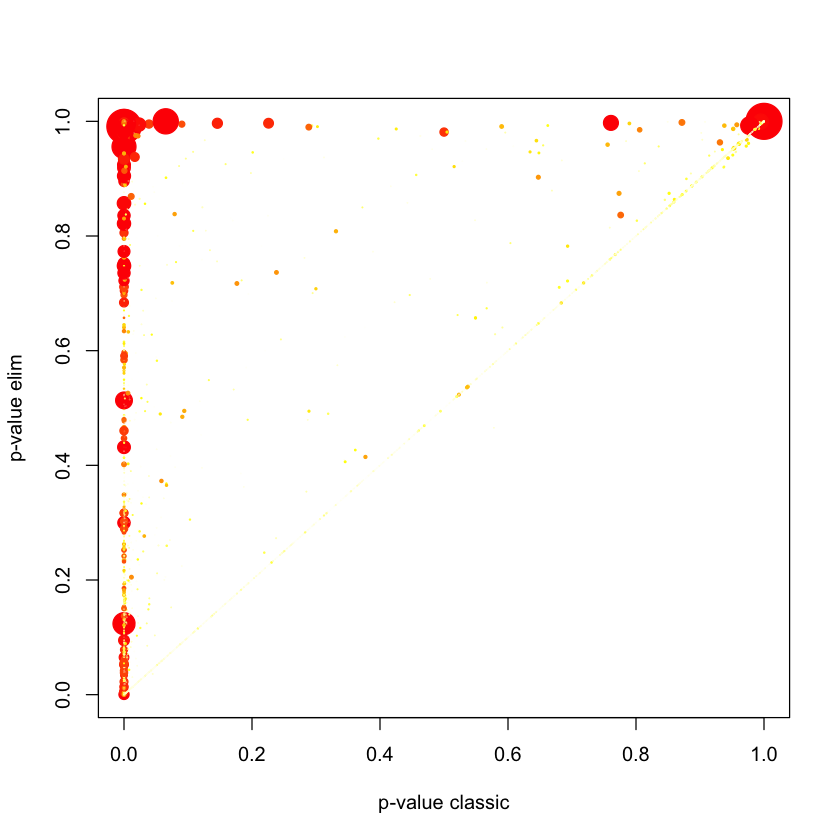

In [151]:
pValue.classic <- score(resultKS)
pValue.elim <- score(resultKS.elim)[names(pValue.classic)]
gstat <- termStat(go_data, names(pValue.classic))

gSize <- gstat$Annotated / max(gstat$Annotated) * 4
gCol <- colMap(gstat$Significant)
plot(pValue.classic, pValue.elim, xlab = "p-value classic", ylab = "p-value elim",
    pch = 19, cex = gSize, col = gCol)

In [152]:
tiff("t_cells.tiff", width = 6, height = 6, units = 'in', res = 500)
showSigOfNodes(go_data, score(resultKS.elim), firstSigNodes = 5, useInfo = 'all')
dev.off()

$dag
A graphNEL graph with directed edges
Number of Nodes = 52 
Number of Edges = 82 

$complete.dag
[1] "A graph with 52 nodes."


pdf 
  2

### Enrichment for tissue between samples

In [3]:
data <- readRDS(file = "./seurat_objects/seurat_obj_annotated.rds")

In [12]:
levels(Idents(data))

[1] "Chondrocytes"         "Erythroblast"         "Neurons"             
[4] "T_cell"               "iPS_cells"            "Epithelial_cells"    
[7] "Astrocyte"            "Neuroepithelial_cell" "Tissue_stem_cells"

In [4]:
get_diff_genes <- function(data, cell_type, control, against = NULL) {
    de_data <- subset(data, idents = cell_type)
    de_data$celltype.resp <- paste(Idents(de_data), de_data$orig.ident, sep = "_")
    # Example of idents: Astrocyte_h1_1, Astrocyte_hues62, Astrocyte_pgp1_1, Astrocyte_pgp1_2, etc...
    de_data$celltype <- Idents(de_data)
    Idents(de_data) <- "celltype.resp"
    
    if (against != FALSE) {
        response <- FindMarkers(de_data, ident.1 = control, ident.2 = against)
    } else {
        response <- FindMarkers(de_data, ident.1 = control)
    }
} 

In [5]:
get_p_values <- function(diff_genes) {
    genes <- rownames(diff_genes)
    p_values <- diff_genes$p_val_adj
    names(p_values) <- genes
    
    p_values[p_values == 0] <- NA
    p_values <- p_values[complete.cases(p_values)]
    
    return (p_values)
} 

In [6]:
get_go <- function(p_values) {
    allGO2genes <- annFUN.org(whichOnto = "BP", feasibleGenes = NULL, mapping = "org.Hs.eg.db", ID = "symbol")
    go_data <- new("topGOdata", ontology = "BP", allGenes = p_values, annot = annFUN.GO2genes, GO2genes = allGO2genes,
               geneSel = function(allScore) { return(allScore < 0.05) }, nodeSize = 10)
}

In [7]:
get_table <- function(go_object, nodes = 10) {
    resultFisher <- runTest(go_object, algorithm = "classic", statistic = "fisher")
    resultKS <- runTest(go_object, algorithm = "classic", statistic = "ks")
    resultKS.elim <- runTest(go_object, algorithm = "elim", statistic = "ks")
    
    results <- GenTable(go_object, classicFisher = resultFisher, 
                        classicKS = resultKS, elimKS = resultKS.elim, orderBy = "elimKS", 
                        ranksOf = "classicFisher", topNodes = nodes)
    
    return (results)
}

In [8]:
all_together <- function(data, cell_type, control, against, return_p, save_tiff = FALSE, file_name = "") {
    de_genes <- get_diff_genes(data, cell_type, control, against = against)
    p_values <- get_p_values(de_genes)
    
    if (save_tiff == TRUE) {
        tiff(file_name, width = 6, height = 6, units = 'in', res = 500)
        showSigOfNodes(go_data, score(resultKS.elim), firstSigNodes = 5, useInfo = 'all')
        dev.off()
    }
    
    if (return_p == TRUE) {
        return (p_values)
    } else {
        go_data <- get_go(p_values)
        go_results <- get_table(go_data)
        return (go_results)
    }
}

In [22]:
# Don't forget to load cellProfiler
# INPUT EXAMPLE: list_with_vector_p_values <- list(responce_1, responce_2)
# INPUT EXAMPLE: c("name_responce_1", "name_responce_2")

get_aggregated_plots <- function(list_with_vector_p_values, vector_of_names, title, showCategory = 10) {
    list_gene_ids <- lapply(list_with_vector_p_values, function(x) {
        bitr(names(x[x < 0.05]), fromType = "SYMBOL", toType = "ENTREZID", OrgDb = "org.Hs.eg.db")$ENTREZID
    })
    names(list_gene_ids) <- vector_of_names
    
    ck <- compareCluster(geneCluster = list_gene_ids, fun = enrichKEGG)
    ck <- setReadable(ck, OrgDb = org.Hs.eg.db, keyType = "ENTREZID")
    
    return (plot <- dotplot(ck, showCategory = showCategory, title = title))
}

In [10]:
responce <- all_together(data, "Astrocyte", "Astrocyte_h1_1", against = FALSE, return_p = TRUE)
responce_1 <- all_together(data, "Astrocyte", "Astrocyte_h1_1", against = "Astrocyte_hues62", return_p = TRUE)
responce_2 <- all_together(data, "Astrocyte", "Astrocyte_h1_1", against = "Astrocyte_h9", return_p = TRUE)
responce_3 <- all_together(data, "Astrocyte", "Astrocyte_h1_1", against = "Astrocyte_pgp1_1", return_p = TRUE)

'select()' returned 1:1 mapping between keys and columns

'select()' returned 1:1 mapping between keys and columns

'select()' returned 1:1 mapping between keys and columns

'select()' returned 1:1 mapping between keys and columns



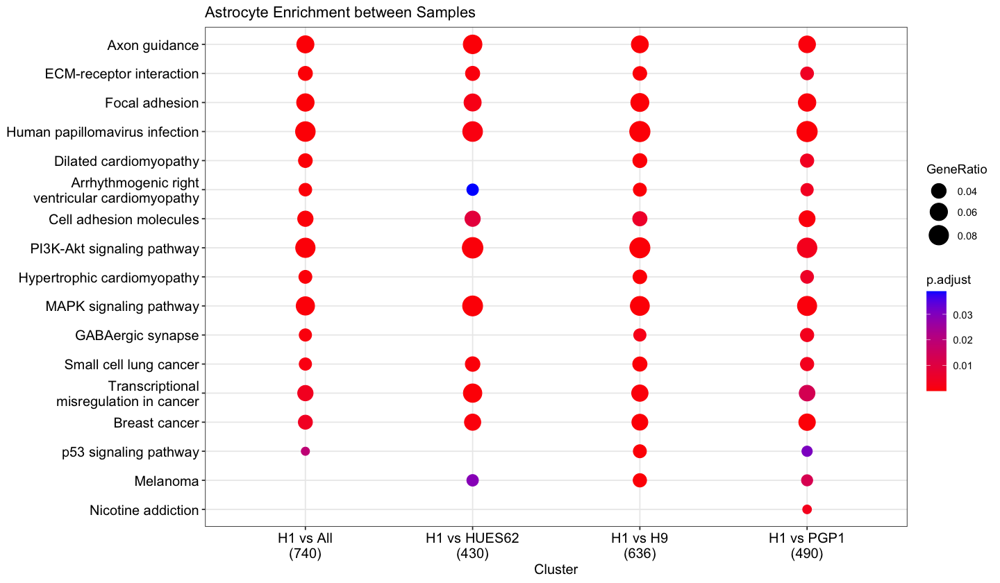

In [24]:
options(repr.plot.width = 12, repr.plot.height = 10)
res1 <- get_aggregated_plots(list(responce, responce_1, responce_2, responce_3), 
                            c("H1 vs All", "H1 vs HUES62", "H1 vs H9", "H1 vs PGP1"),
                            title = "Astrocyte Enrichment between Samples")

In [45]:
tiff("astrocyte_go.tiff", width = 12, height = 10, units = 'in', res = 500)
res1
dev.off()

pdf 
  2

In [26]:
responce <- all_together(data, "Neurons", "Neurons_h9", against = FALSE, return_p = TRUE)
responce_1 <- all_together(data, "Neurons", "Neurons_h9", against = "Neurons_h1_1", return_p = TRUE)
responce_2 <- all_together(data, "Neurons", "Neurons_h9", against = "Neurons_hues62", return_p = TRUE)
responce_3 <- all_together(data, "Neurons", "Neurons_h9", against = "Neurons_pgp1_1", return_p = TRUE)

'select()' returned 1:1 mapping between keys and columns

'select()' returned 1:1 mapping between keys and columns

'select()' returned 1:1 mapping between keys and columns

'select()' returned 1:1 mapping between keys and columns



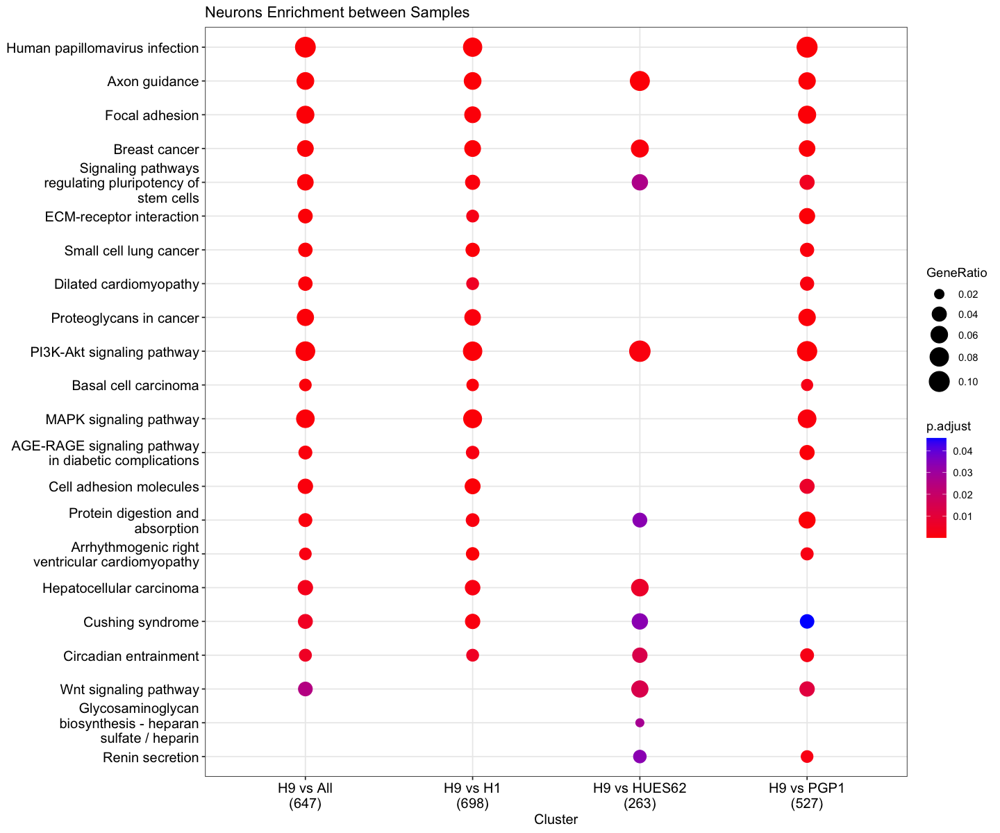

In [28]:
options(repr.plot.width = 12, repr.plot.height = 10)
res2 <- get_aggregated_plots(list(responce, responce_1, responce_2, responce_3), 
                            c("H9 vs All", "H9 vs H1", "H9 vs HUES62", "H9 vs PGP1"),
                            title = "Neurons Enrichment between Samples")

In [44]:
tiff("neurons_go.tiff", width = 12, height = 10, units = 'in', res = 500)
res2
dev.off()

pdf 
  2

In [29]:
responce <- all_together(data, "iPS_cells", "iPS_cells_hues62", against = FALSE, return_p = TRUE)
responce_1 <- all_together(data, "iPS_cells", "iPS_cells_hues62", against = "iPS_cells_h1_1", return_p = TRUE)
responce_2 <- all_together(data, "iPS_cells", "iPS_cells_hues62", against = "iPS_cells_h9", return_p = TRUE)
responce_3 <- all_together(data, "iPS_cells", "iPS_cells_hues62", against = "iPS_cells_pgp1_1", return_p = TRUE)

'select()' returned 1:1 mapping between keys and columns

'select()' returned 1:1 mapping between keys and columns

'select()' returned 1:1 mapping between keys and columns

'select()' returned 1:1 mapping between keys and columns



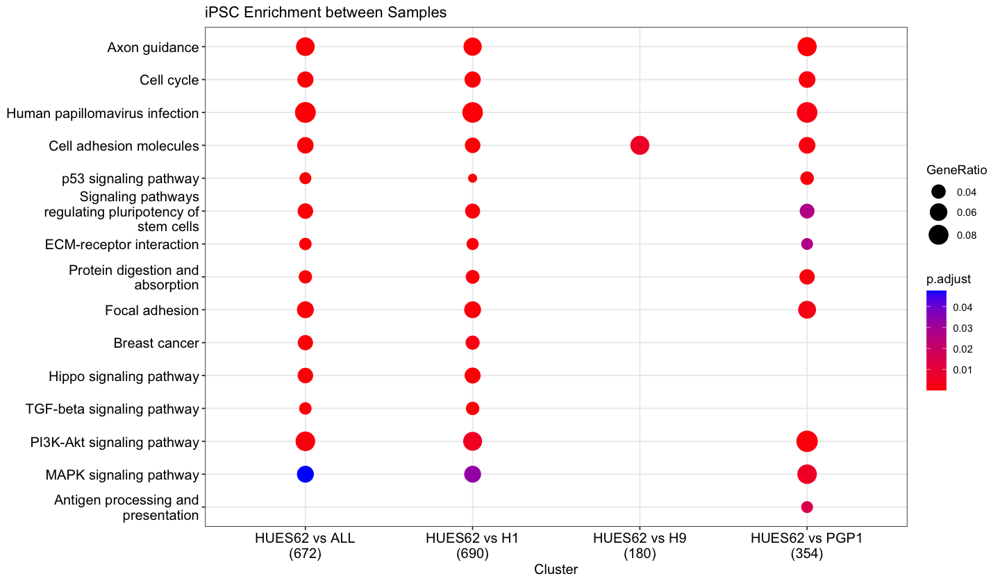

In [34]:
options(repr.plot.width = 12, repr.plot.height = 10)
res3 <- get_aggregated_plots(list(responce, responce_1, responce_2, responce_3), 
                            c("HUES62 vs ALL", "HUES62 vs H1", "HUES62 vs H9", "HUES62 vs PGP1"),
                            title = "iPSC Enrichment between Samples")

In [47]:
tiff("ips_go.tiff", width = 12, height = 10, units = 'in', res = 500)
res3
dev.off()

pdf 
  2

In [40]:
responce <- all_together(data, "Tissue_stem_cells", "Tissue_stem_cells_pgp1_1", against = FALSE, 
                         return_p = TRUE)
responce_1 <- all_together(data, "Tissue_stem_cells", "Tissue_stem_cells_pgp1_1", 
                           against = "Tissue_stem_cells_h1_1", return_p = TRUE)
responce_2 <- all_together(data, "Tissue_stem_cells", "Tissue_stem_cells_pgp1_1", against = "Tissue_stem_cells_h9", 
                           return_p = TRUE)
responce_3 <- all_together(data, "Tissue_stem_cells", "Tissue_stem_cells_pgp1_1", 
                           against = "Tissue_stem_cells_hues62", return_p = TRUE)

'select()' returned 1:1 mapping between keys and columns

'select()' returned 1:1 mapping between keys and columns

'select()' returned 1:1 mapping between keys and columns

'select()' returned 1:1 mapping between keys and columns



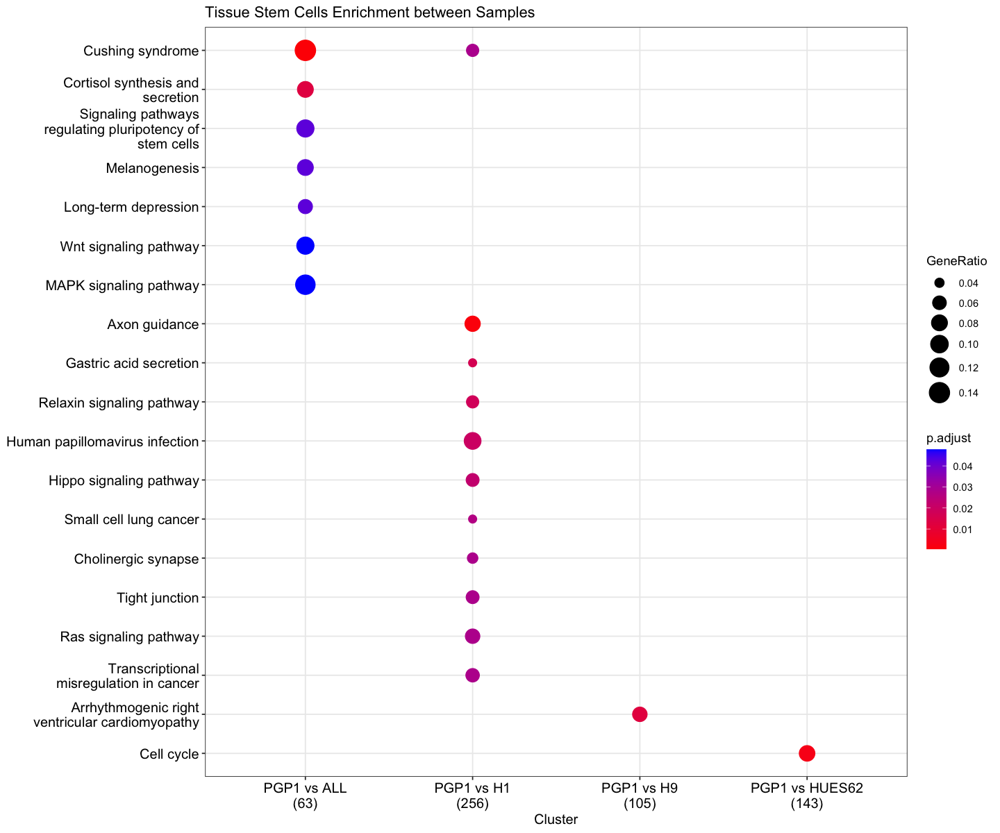

In [41]:
options(repr.plot.width = 12, repr.plot.height = 10)
res4 <- get_aggregated_plots(list(responce, responce_1, responce_2, responce_3), 
                            c("PGP1 vs ALL", "PGP1 vs H1", "PGP1 vs H9", "PGP1 vs HUES62"),
                            title = "Tissue Stem Cells Enrichment between Samples")

In [46]:
tiff("tissue_stem_cells_go.tiff", width = 12, height = 10, units = 'in', res = 500)
res4
dev.off()

pdf 
  2

# Session Info

In [ ]:
sessionInfo()